# Wasserstein GAN with Gradient Penalty (WGAN-GP)

### Goals
In this notebook, you're going to build a Wasserstein GAN with Gradient Penalty (WGAN-GP) that solves some of the stability issues with the GANs that you have been using up until this point. Specifically, you'll use a special kind of loss function known as the W-loss, where W stands for Wasserstein, and gradient penalties to prevent mode collapse.

*Fun Fact: Wasserstein is named after a mathematician at Penn State, Leonid Vaseršteĭn. You'll see it abbreviated to W (e.g. WGAN, W-loss, W-distance).*

### Learning Objectives
1.   Get hands-on experience building a more stable GAN: Wasserstein GAN with Gradient Penalty (WGAN-GP).
2.   Train the more advanced WGAN-GP model.



## Generator and Critic

You will begin by importing some useful packages, defining visualization functions, building the generator, and building the critic. Since the changes for WGAN-GP are done to the loss function during training, you can simply reuse your previous GAN code for the generator and critic class. Remember that in WGAN-GP, you no longer use a discriminator that classifies fake and real as 0 and 1 but rather a critic that scores images with real numbers.

#### Packages and Visualizations

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

def make_grad_hook():
    '''
    Function to keep track of gradients for visualization purposes, 
    which fills the grads list when using model.apply(grad_hook).
    '''
    grads = []
    def grad_hook(m):
        if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
            grads.append(m.weight.grad)
    return grads, grad_hook

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        z_dim: the dimension of the noise vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, z_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(z_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor,
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        x = noise.view(len(noise), self.z_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, z_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, z_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
      n_samples: the number of samples to generate, a scalar
      z_dim: the dimension of the noise vector, a scalar
      device: the device type
    '''
    return torch.randn(n_samples, z_dim, device=device)

#### Critic

In [5]:
class Critic(nn.Module):
    '''
    Critic Class
    Values:
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Critic, self).__init__()
        self.crit = nn.Sequential(
            self.make_crit_block(im_chan, hidden_dim),
            self.make_crit_block(hidden_dim, hidden_dim * 2),
            self.make_crit_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_crit_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a critic block of DCGAN;
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the critic: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        crit_pred = self.crit(image)
        return crit_pred.view(len(crit_pred), -1)

## Training Initializations
Now you can start putting it all together.
As usual, you will start by setting the parameters:
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   beta_1, beta_2: the momentum terms
  *   c_lambda: weight of the gradient penalty
  *   crit_repeats: number of times to update the critic per generator update - there are more details about this in the *Putting It All Together* section
  *   device: the device type

You will also load and transform the MNIST dataset to tensors.




In [6]:
n_epochs = 100
z_dim = 64
display_step = 50
batch_size = 128
lr = 0.0002
beta_1 = 0.5
beta_2 = 0.999
c_lambda = 10
crit_repeats = 5
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, critic, and optimizers.

In [7]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(beta_1, beta_2))
crit = Critic().to(device) 
crit_opt = torch.optim.Adam(crit.parameters(), lr=lr, betas=(beta_1, beta_2))

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
crit = crit.apply(weights_init)

## Gradient Penalty
Calculating the gradient penalty can be broken into two functions: (1) compute the gradient with respect to the images and (2) compute the gradient penalty given the gradient.

You can start by getting the gradient. The gradient is computed by first creating a mixed image. This is done by weighing the fake and real image using epsilon and then adding them together. Once you have the intermediate image, you can get the critic's output on the image. Finally, you compute the gradient of the critic score's on the mixed images (output) with respect to the pixels of the mixed images (input). You will need to fill in the code to get the gradient wherever you see *None*. There is a test function in the next block for you to test your solution.

In [8]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gradient
def get_gradient(crit, real, fake, epsilon):
    '''
    Return the gradient of the critic's scores with respect to mixes of real and fake images.
    Parameters:
        crit: the critic model
        real: a batch of real images
        fake: a batch of fake images
        epsilon: a vector of the uniformly random proportions of real/fake per mixed image
    Returns:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    '''
    # Mix the images together
    mixed_images = real * epsilon + fake * (1 - epsilon)

    # Calculate the critic's scores on the mixed images
    mixed_scores = crit(mixed_images)
    
    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        # Note: You need to take the gradient of outputs with respect to inputs.
        # This documentation may be useful, but it should not be necessary:
        # https://pytorch.org/docs/stable/autograd.html#torch.autograd.grad
        #### START CODE HERE ####
        inputs=mixed_images,
        outputs=mixed_scores,
        #### END CODE HERE ####
        # These other parameters have to do with the pytorch autograd engine works
        grad_outputs=torch.ones_like(mixed_scores), 
        create_graph=True,
        retain_graph=True,
    )[0]
    return gradient


In [9]:
# UNIT TEST
# DO NOT MODIFY THIS
def test_get_gradient(image_shape):
    real = torch.randn(*image_shape, device=device) + 1
    fake = torch.randn(*image_shape, device=device) - 1
    epsilon_shape = [1 for _ in image_shape]
    epsilon_shape[0] = image_shape[0]
    epsilon = torch.rand(epsilon_shape, device=device).requires_grad_()
    gradient = get_gradient(crit, real, fake, epsilon)
    assert tuple(gradient.shape) == image_shape
    assert gradient.max() > 0
    assert gradient.min() < 0
    return gradient

gradient = test_get_gradient((256, 1, 28, 28))
print("Success!")

Success!


The second function you need to complete is to compute the gradient penalty given the gradient. First, you calculate the magnitude of each image's gradient. The magnitude of a gradient is also called the norm. Then, you calculate the penalty by squaring the distance between each magnitude and the ideal norm of 1 and taking the mean of all the squared distances.

Again, you will need to fill in the code wherever you see *None*. There are hints below that you can view if you need help and there is a test function in the next block for you to test your solution.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">gradient_penalty</font></code></b>
</font>
</summary>


1.   Make sure you take the mean at the end.
2.   Note that the magnitude of each gradient has already been calculated for you.

</details>


In [12]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: gradient_penalty
def gradient_penalty(gradient):
    '''
    Return the gradient penalty, given a gradient.
    Given a batch of image gradients, you calculate the magnitude of each image's gradient
    and penalize the mean quadratic distance of each magnitude to 1.
    Parameters:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    Returns:
        penalty: the gradient penalty
    '''
    # Flatten the gradients so that each row captures one image
    gradient = gradient.view(len(gradient), -1)

    # Calculate the magnitude of every row
    gradient_norm = gradient.norm(2, dim=1)
    
    # Penalize the mean squared distance of the gradient norms from 1
    #### START CODE HERE ####
    penalty = torch.mean((gradient_norm - 1) ** 2)
    #### END CODE HERE ####
    return penalty

In [13]:
# UNIT TEST
def test_gradient_penalty(image_shape):
    bad_gradient = torch.zeros(*image_shape)
    bad_gradient_penalty = gradient_penalty(bad_gradient)
    assert torch.isclose(bad_gradient_penalty, torch.tensor(1.))

    image_size = torch.prod(torch.Tensor(image_shape[1:]))
    good_gradient = torch.ones(*image_shape) / torch.sqrt(image_size)
    good_gradient_penalty = gradient_penalty(good_gradient)
    assert torch.isclose(good_gradient_penalty, torch.tensor(0.))

    random_gradient = test_get_gradient(image_shape)
    random_gradient_penalty = gradient_penalty(random_gradient)
    assert torch.abs(random_gradient_penalty - 1) < 0.1

test_gradient_penalty((256, 1, 28, 28))
print("Success!")

Success!


## Losses
Next, you need to calculate the loss for the generator and the critic.

For the generator, the loss is calculated by maximizing the critic's prediction on the generator's fake images. The argument has the scores for all fake images in the batch, but you will use the mean of them.

There are optional hints below and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_gen_loss</font></code></b></font></summary>

1. This can be written in one line.
2. This is the negative of the mean of the critic's scores.

</details>

In [16]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gen_loss
def get_gen_loss(crit_fake_pred):
    '''
    Return the loss of a generator given the critic's scores of the generator's fake images.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
    Returns:
        gen_loss: a scalar loss value for the current batch of the generator
    '''
    #### START CODE HERE ####
    gen_loss = torch.mean(-crit_fake_pred)
    #### END CODE HERE ####
    return gen_loss

In [17]:
# UNIT TEST
assert torch.isclose(
    get_gen_loss(torch.tensor(1.)), torch.tensor(-1.0)
)

assert torch.isclose(
    get_gen_loss(torch.rand(10000)), torch.tensor(-0.5), 0.05
)

print("Success!")

Success!


For the critic, the loss is calculated by maximizing the distance between the critic's predictions on the real images and the predictions on the fake images while also adding a gradient penalty. The gradient penalty is weighed according to lambda. The arguments are the scores for all the images in the batch, and you will use the mean of them.

There are hints below if you get stuck and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_crit_loss</font></code></b></font></summary>

1. The higher the mean fake score, the higher the critic's loss is.
2. What does this suggest about the mean real score?
3. The higher the gradient penalty, the higher the critic's loss is, proportional to lambda.


</details>


In [20]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_crit_loss
def get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda):
    '''
    Return the loss of a critic given the critic's scores for fake and real images,
    the gradient penalty, and gradient penalty weight.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
        crit_real_pred: the critic's scores of the real images
        gp: the unweighted gradient penalty
        c_lambda: the current weight of the gradient penalty 
    Returns:
        crit_loss: a scalar for the critic's loss, accounting for the relevant factors
    '''
    #### START CODE HERE ####
    crit_loss = torch.mean(-crit_real_pred + crit_fake_pred + c_lambda * gp)
    #### END CODE HERE ####
    return crit_loss

In [21]:
# UNIT TEST
assert torch.isclose(
    get_crit_loss(torch.tensor(1.), torch.tensor(2.), torch.tensor(3.), 0.1),
    torch.tensor(-0.7)
)
assert torch.isclose(
    get_crit_loss(torch.tensor(20.), torch.tensor(-20.), torch.tensor(2.), 10),
    torch.tensor(60.)
)

print("Success!")

Success!


## Putting It All Together
Before you put everything together, there are a few things to note.
1.   Even on GPU, the **training will run more slowly** than previous labs because the gradient penalty requires you to compute the gradient of a gradient -- this means potentially a few minutes per epoch! For best results, run this for as long as you can while on GPU.
2.   One important difference from earlier versions is that you will **update the critic multiple times** every time you update the generator This helps prevent the generator from overpowering the critic. Sometimes, you might see the reverse, with the generator updated more times than the critic. This depends on architectural (e.g. the depth and width of the network) and algorithmic choices (e.g. which loss you're using). 
3.   WGAN-GP isn't necessarily meant to improve overall performance of a GAN, but just **increases stability** and avoids mode collapse. In general, a WGAN will be able to train in a much more stable way than the vanilla DCGAN from last assignment, though it will generally run a bit slower. You should also be able to train your model for more epochs without it collapsing.


<!-- Once again, be warned that this runs very slowly on a CPU. One way to run this more quickly is to download the .ipynb and upload it to Google Drive, then open it with Google Colab and make the runtime type GPU and replace
`device = "cpu"`
with
`device = "cuda"`
and make sure that your `get_noise` function uses the right device.  -->

Here is a snapshot of what your WGAN-GP outputs should resemble:
![MNIST Digits Progression](MNIST_WGAN_Progression.png)

Step 50: Generator loss: -0.09426244085654617, critic loss: 1.900443526141346


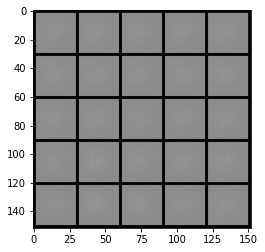

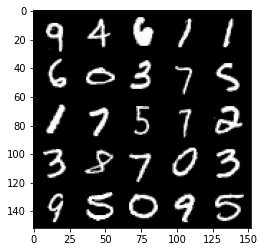

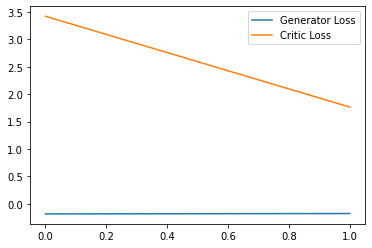

Step 100: Generator loss: 1.3200355623289943, critic loss: -2.5514080473314977


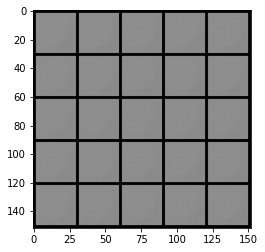

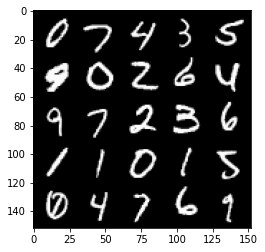

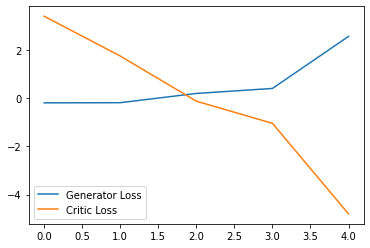

Step 150: Generator loss: 3.1513355112075807, critic loss: -13.702060731887821


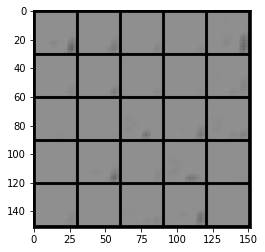

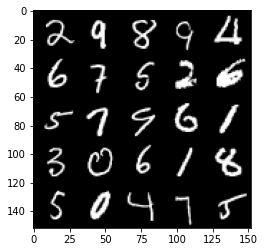

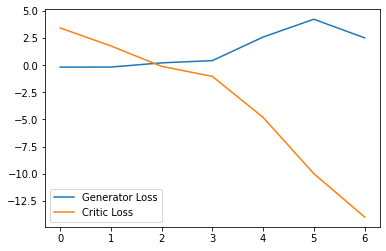

Step 200: Generator loss: 0.6029913537204266, critic loss: -33.12547465515136


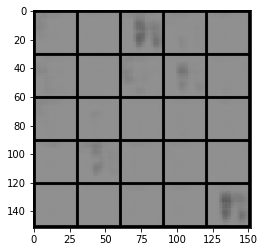

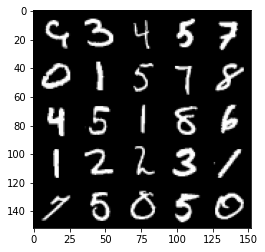

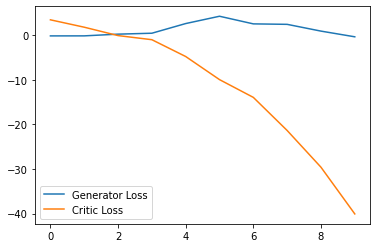

Step 250: Generator loss: -2.7072793459892273, critic loss: -66.45678001403809


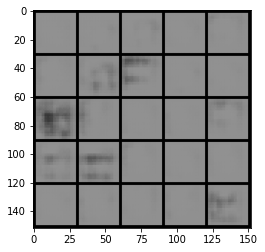

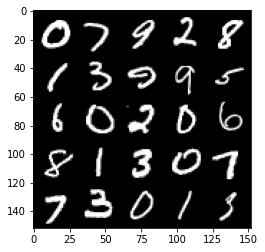

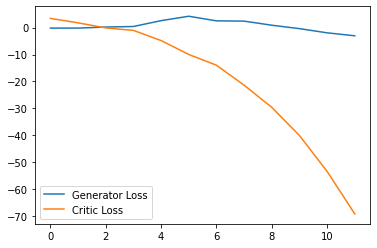

Step 300: Generator loss: -3.2169376945495607, critic loss: -112.19593234252926


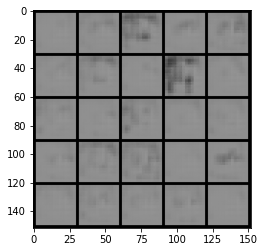

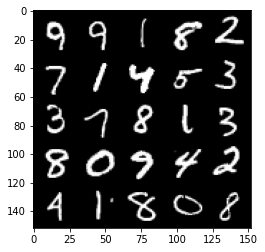

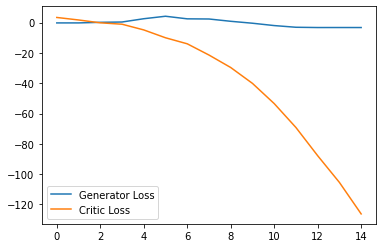

Step 350: Generator loss: -1.044336162507534, critic loss: -160.47615887451173


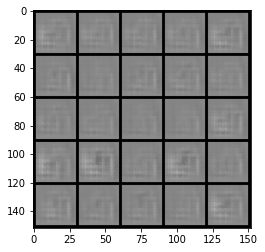

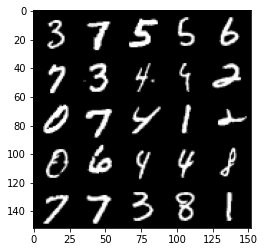

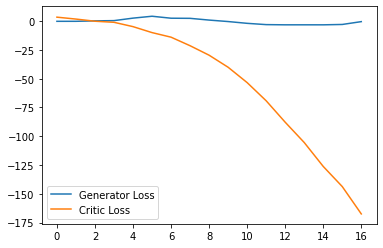

Step 400: Generator loss: -1.3583426505327225, critic loss: -206.23540222167972


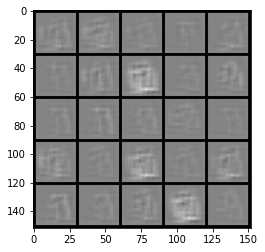

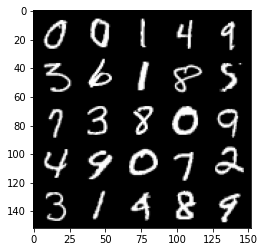

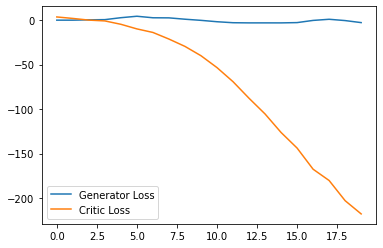

Step 450: Generator loss: -3.214645954966545, critic loss: -236.7372507324219


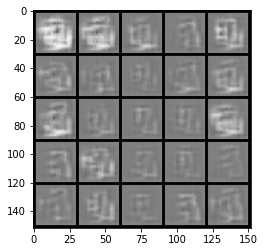

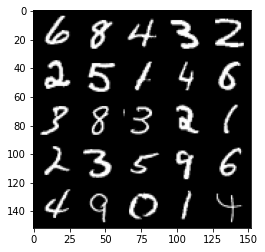

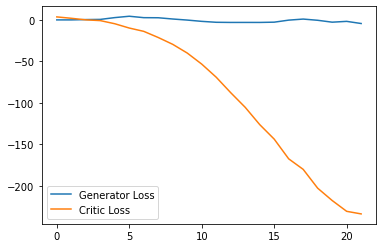

Step 500: Generator loss: -13.013668510913849, critic loss: -225.74636930847163


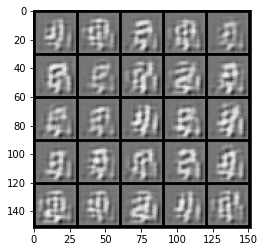

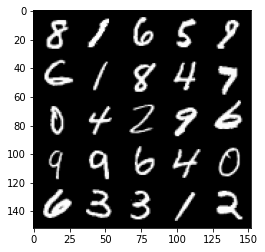

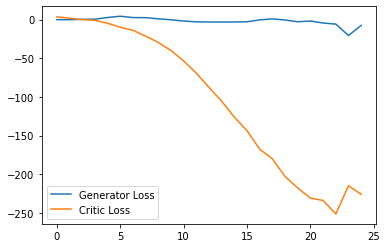

Step 550: Generator loss: -24.58701082408428, critic loss: -196.76415565490714


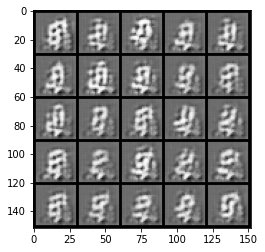

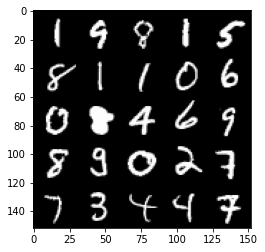

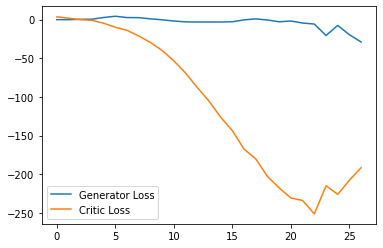

Step 600: Generator loss: -5.123679521679878, critic loss: -222.67904929733274


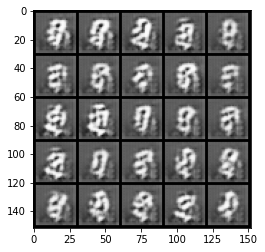

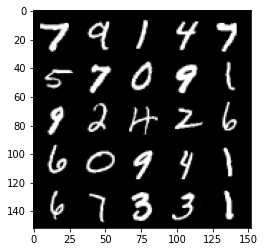

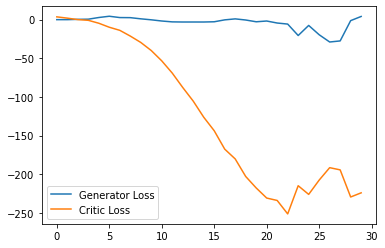

Step 650: Generator loss: -13.293806185722351, critic loss: -169.93948660564428


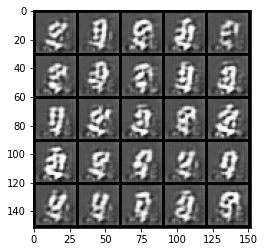

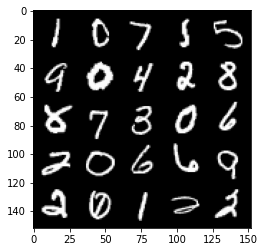

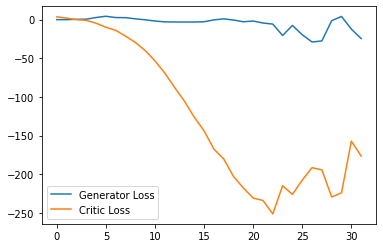

Step 700: Generator loss: -25.368251857757567, critic loss: -125.03728954029086


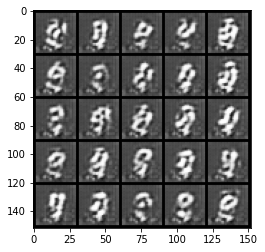

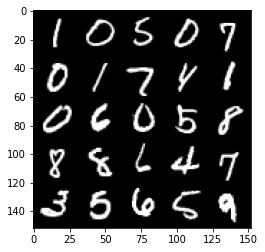

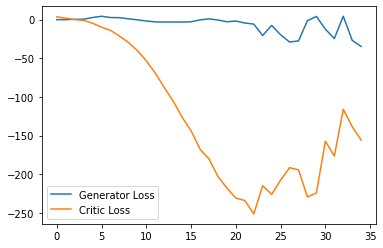

Step 750: Generator loss: -39.0291915512085, critic loss: -144.70572496032716


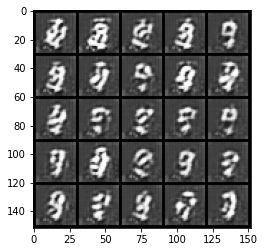

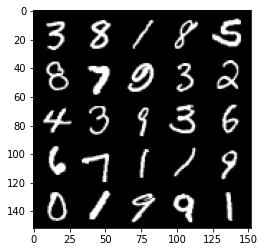

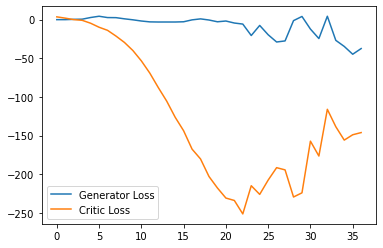

Step 800: Generator loss: -24.72473093986511, critic loss: -111.08028714942931


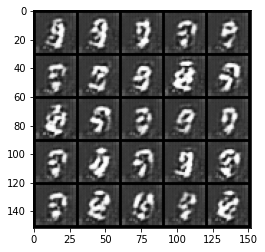

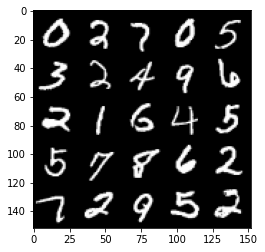

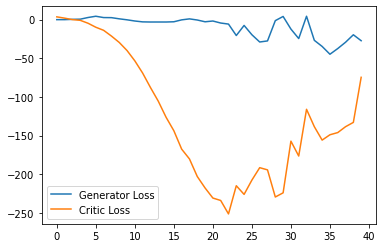

Step 850: Generator loss: -31.91924605369568, critic loss: -122.6487585067749


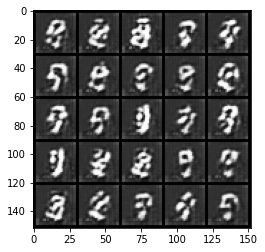

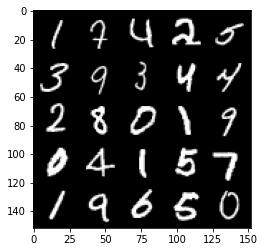

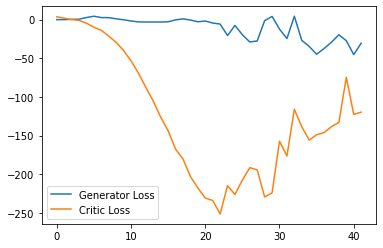

Step 900: Generator loss: -8.191761773824691, critic loss: 11.016071255683896


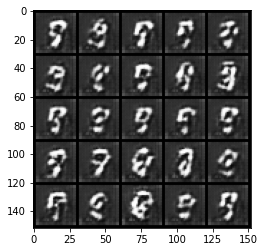

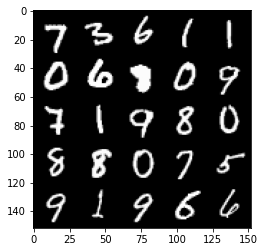

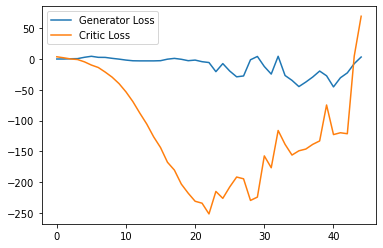

Step 950: Generator loss: -1.4070051355659963, critic loss: 94.87178305053712


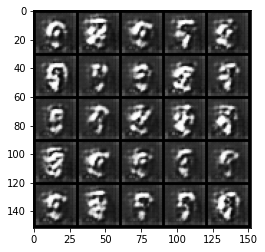

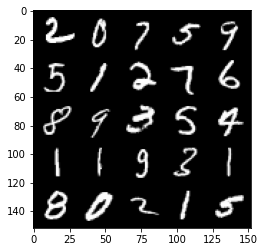

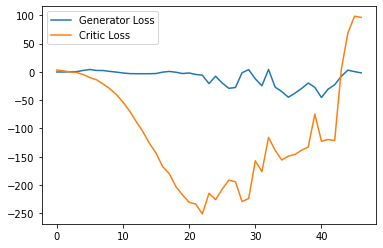

Step 1000: Generator loss: -7.969358615875244, critic loss: 62.8680927429199


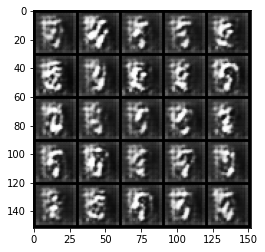

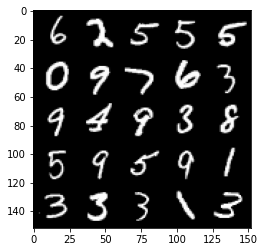

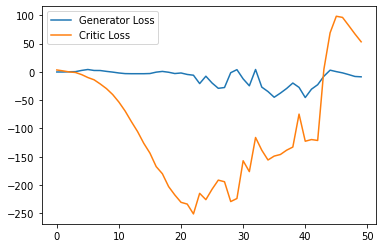

Step 1050: Generator loss: -8.577866106033325, critic loss: 39.25902293395995


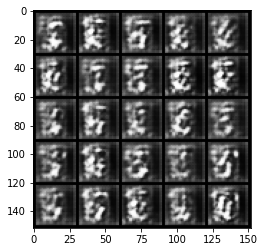

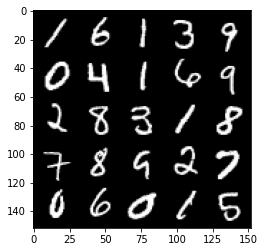

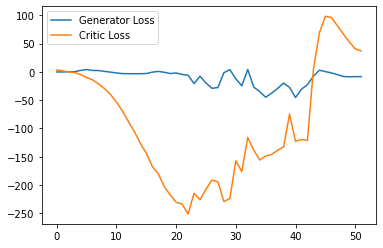

Step 1100: Generator loss: -10.859408378601074, critic loss: 40.87624552917482


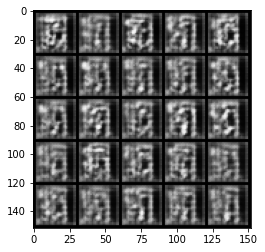

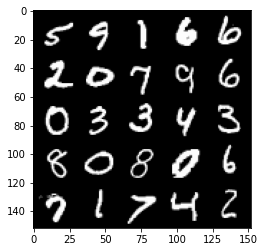

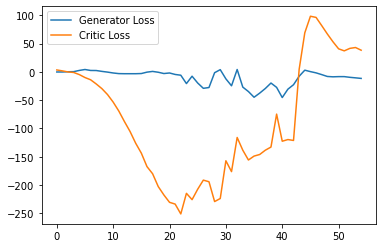

Step 1150: Generator loss: -9.138815803527832, critic loss: 3.6946225117444995


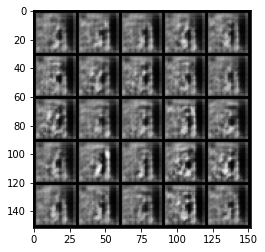

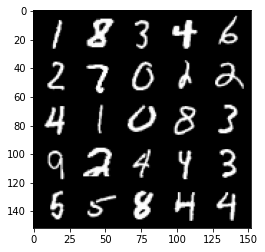

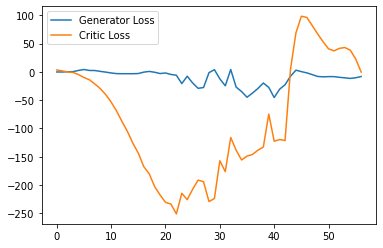

Step 1200: Generator loss: -11.517190170288085, critic loss: -52.953624229431135


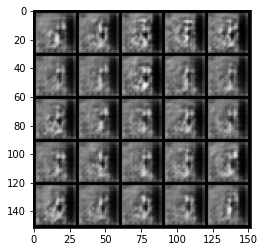

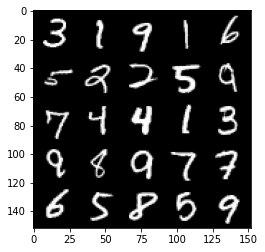

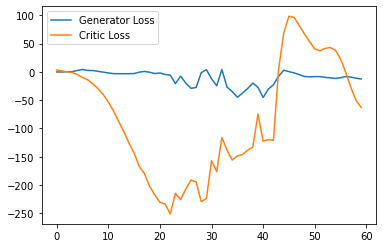

Step 1250: Generator loss: -12.096012592315674, critic loss: -95.29732919311523


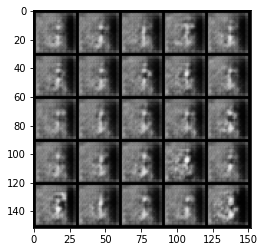

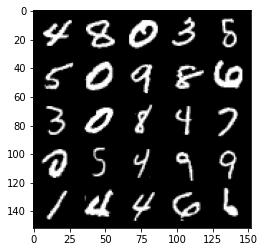

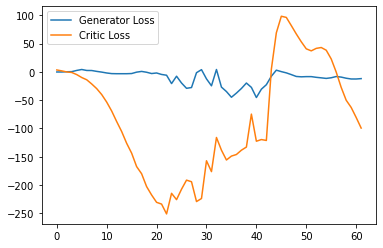

Step 1300: Generator loss: -11.588451614379883, critic loss: -132.15269827270507


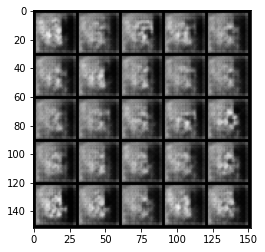

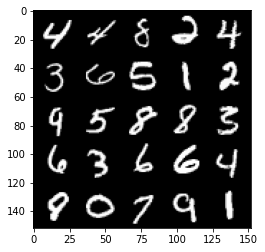

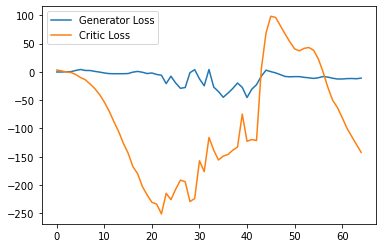

Step 1350: Generator loss: -9.534203300476074, critic loss: -169.35924890136712


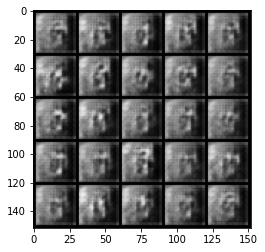

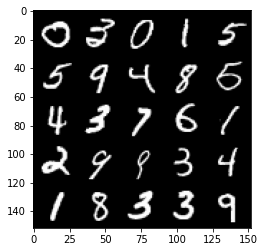

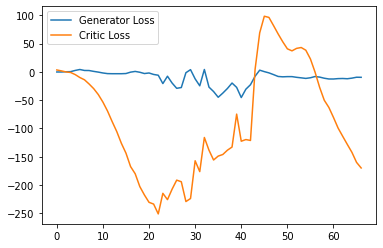

Step 1400: Generator loss: -10.039916458129882, critic loss: -202.2973786010742


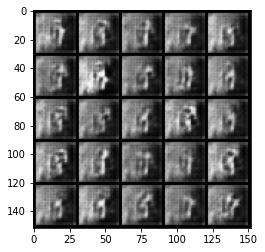

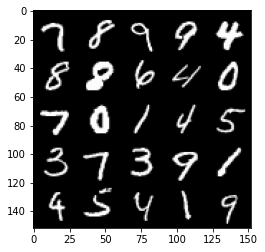

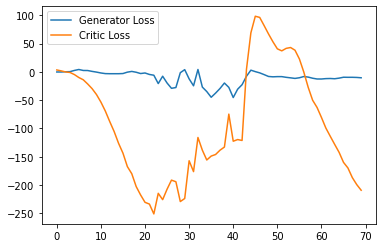

Step 1450: Generator loss: -12.74605073928833, critic loss: -222.53098541259766


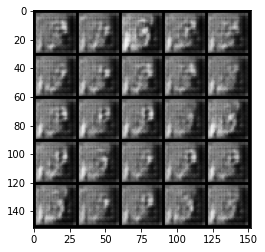

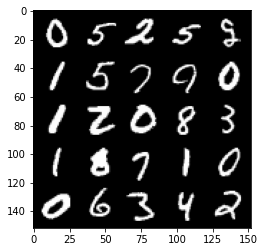

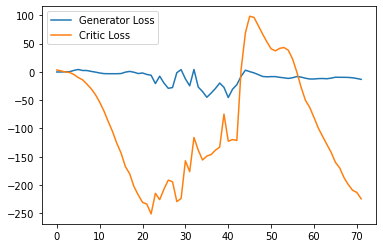

Step 1500: Generator loss: -13.252804012298585, critic loss: -239.41699395751957


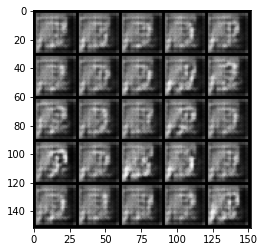

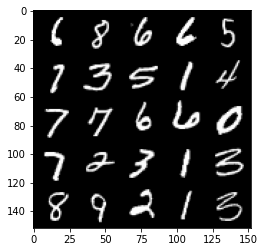

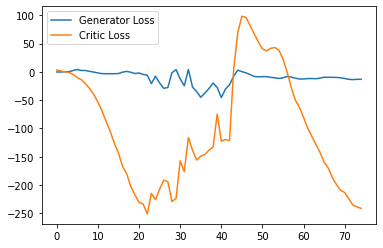

Step 1550: Generator loss: -20.458947801589964, critic loss: -122.08777311801913


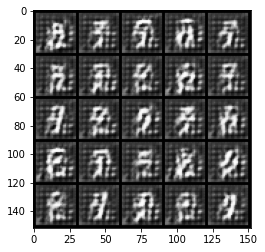

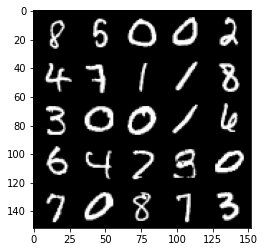

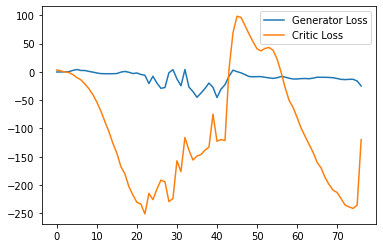

Step 1600: Generator loss: -26.211867065429686, critic loss: 29.887625564575202


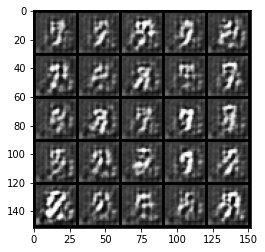

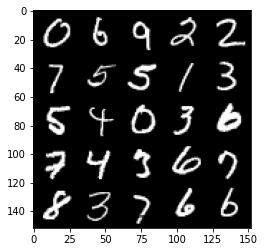

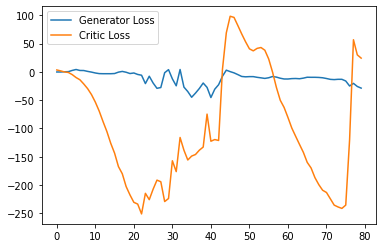

Step 1650: Generator loss: -29.298429908752443, critic loss: 17.21816174697876


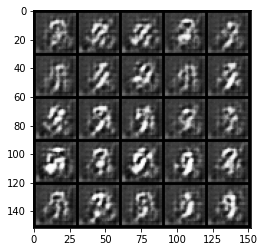

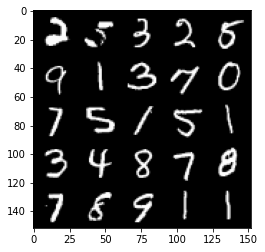

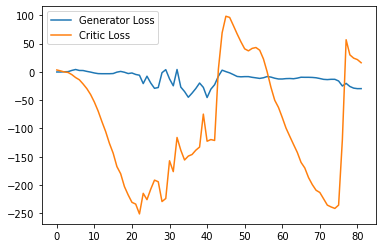

Step 1700: Generator loss: -25.912524108886718, critic loss: 7.220138577461241


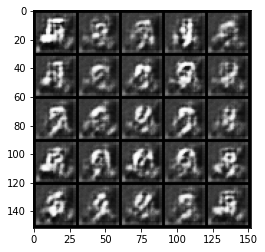

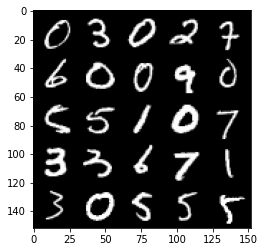

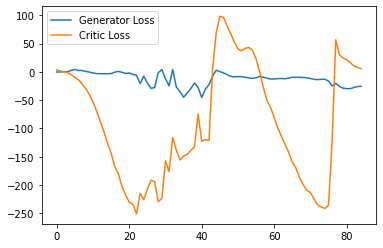

Step 1750: Generator loss: -26.48851501464844, critic loss: 2.579849168866873


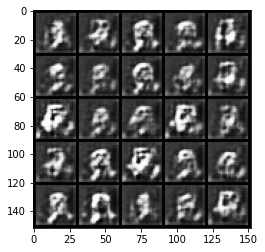

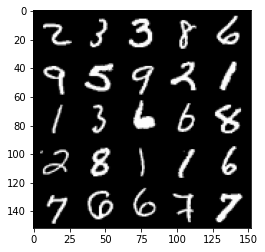

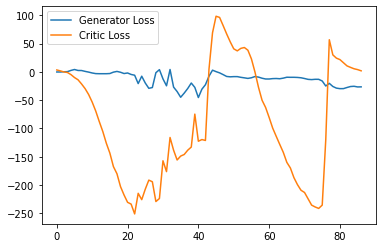

Step 1800: Generator loss: -25.808917655944825, critic loss: 0.09507914650440219


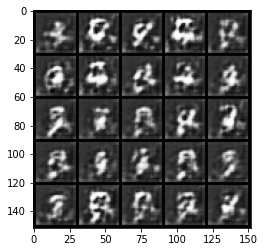

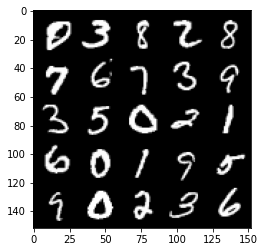

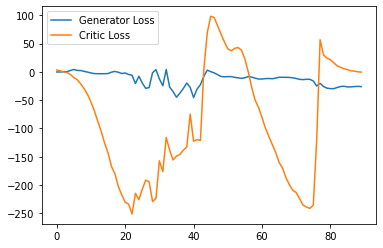

Step 1850: Generator loss: -27.102202186584474, critic loss: -0.521222426354885


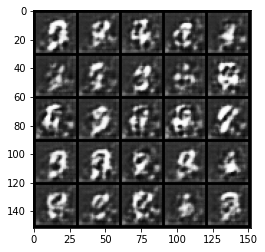

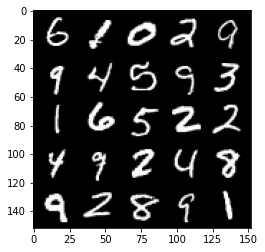

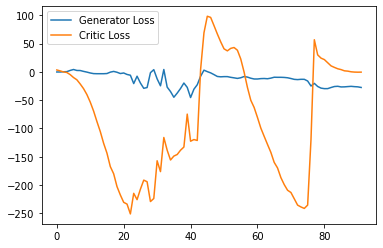

Step 1900: Generator loss: -27.656760330200196, critic loss: -2.3982775615453717


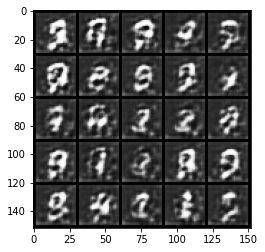

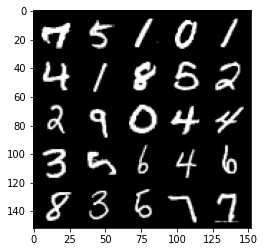

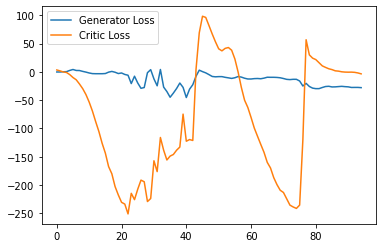

Step 1950: Generator loss: -27.761397438049315, critic loss: -4.960205790758135


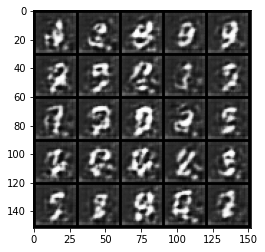

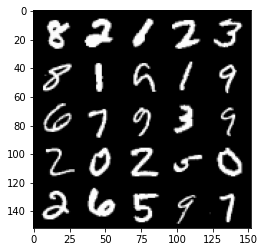

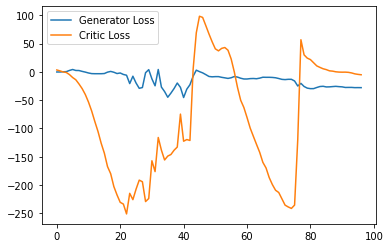

Step 2000: Generator loss: -26.616348609924316, critic loss: -8.547876104354858


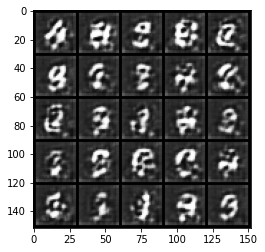

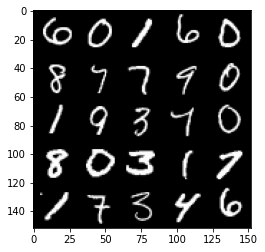

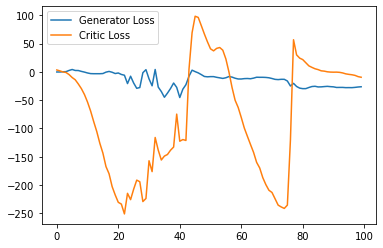

Step 2050: Generator loss: -24.043670082092284, critic loss: -11.224506694316863


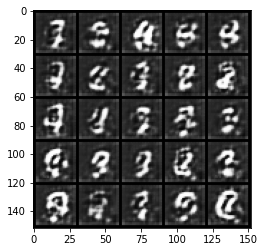

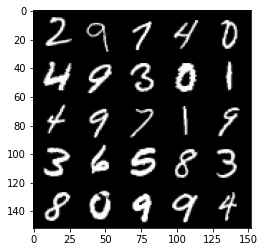

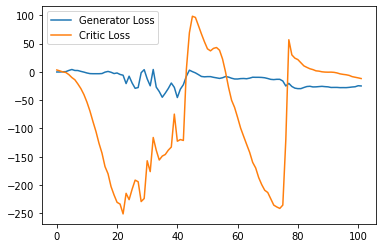

Step 2100: Generator loss: -22.22184185028076, critic loss: -12.99284491443634


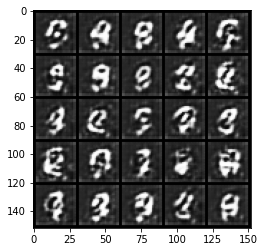

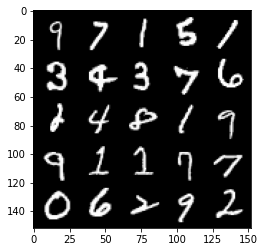

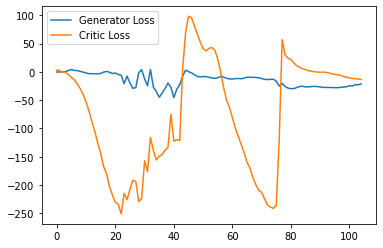

Step 2150: Generator loss: -20.130682849884032, critic loss: -13.68443184924125


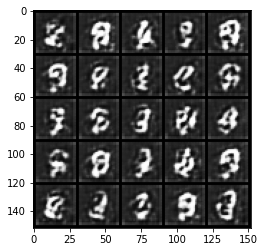

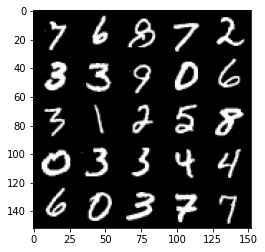

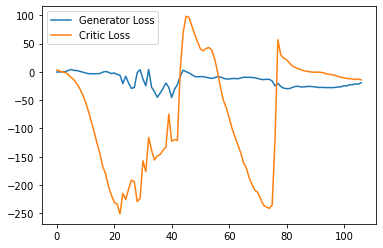

Step 2200: Generator loss: -18.059818019866942, critic loss: -14.911791367769238


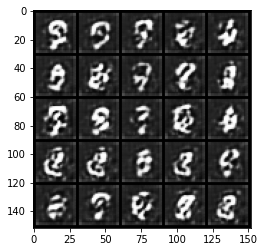

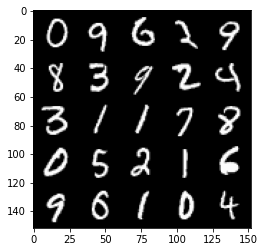

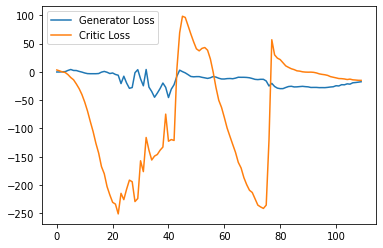

Step 2250: Generator loss: -17.187857036590575, critic loss: -15.7541990942359


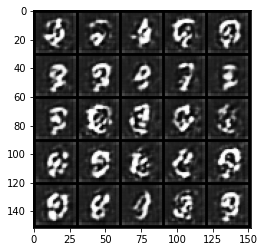

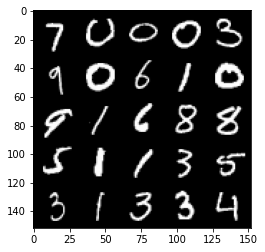

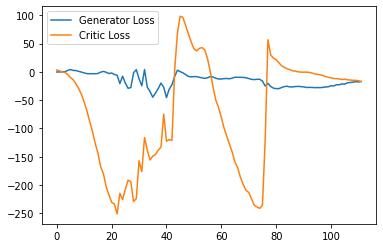

Step 2300: Generator loss: -15.971291608810425, critic loss: -16.371803545713423


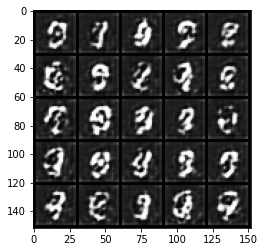

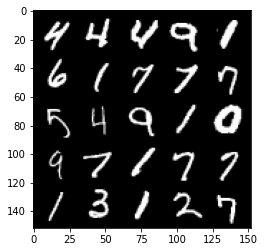

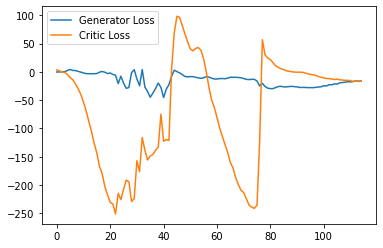

Step 2350: Generator loss: -14.859784898757935, critic loss: -18.13064936304092


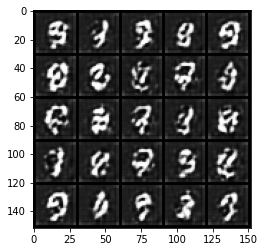

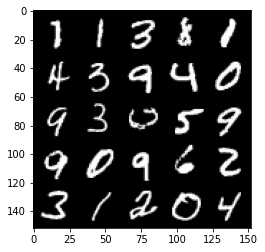

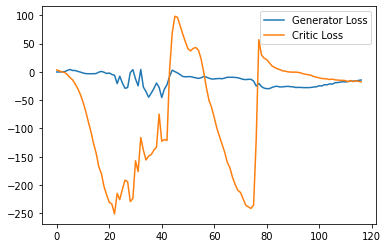

Step 2400: Generator loss: -13.39200590491295, critic loss: -18.359434011220934


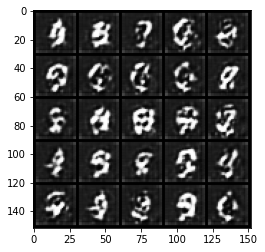

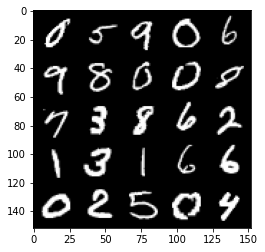

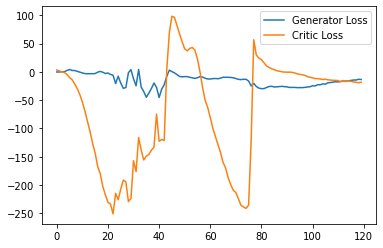

Step 2450: Generator loss: -11.067198657989502, critic loss: -18.37586077404022


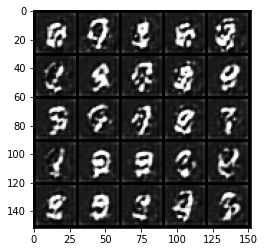

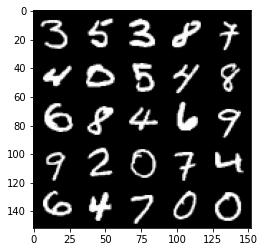

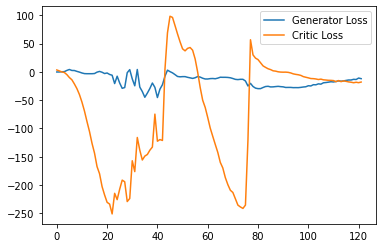

Step 2500: Generator loss: -9.519955954551698, critic loss: -18.121024101018904


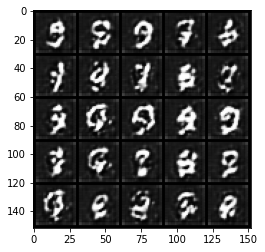

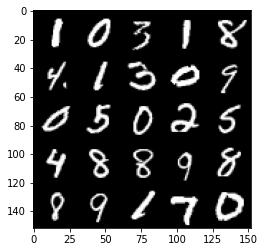

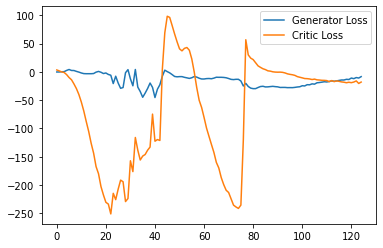

Step 2550: Generator loss: -8.16280405640602, critic loss: -18.76286453676224


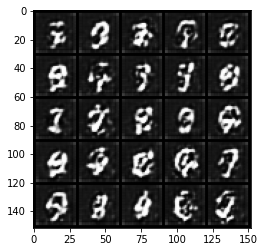

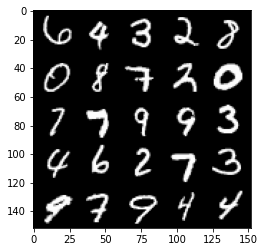

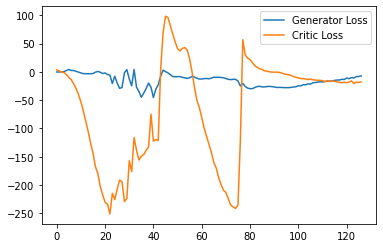

Step 2600: Generator loss: -7.261165614426136, critic loss: -18.78946842050552


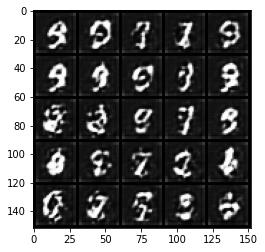

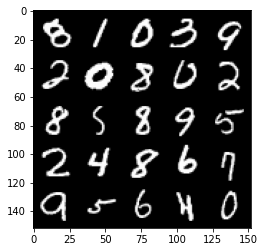

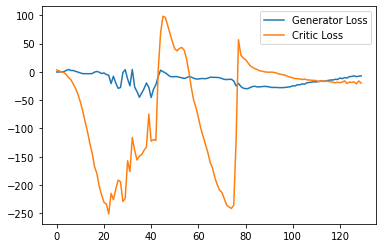

Step 2650: Generator loss: -5.029584921598435, critic loss: -19.429463443756102


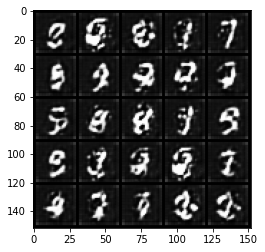

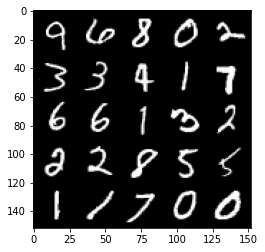

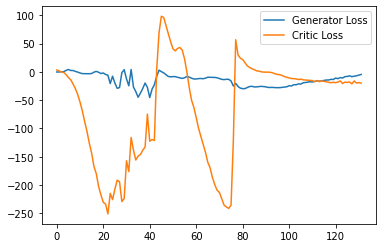

Step 2700: Generator loss: -3.962494017481804, critic loss: -18.605057039260863


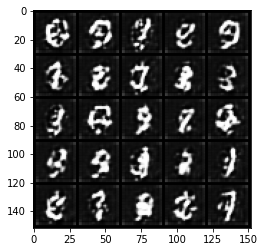

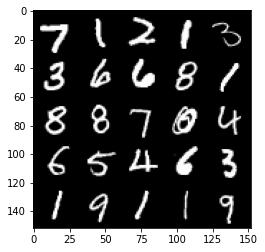

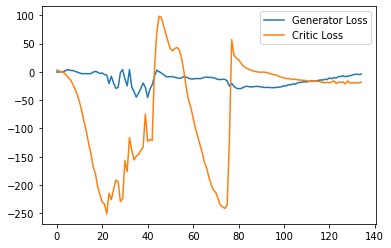

Step 2750: Generator loss: -2.386249576508999, critic loss: -19.88507583618164


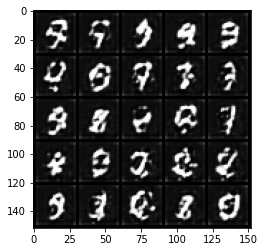

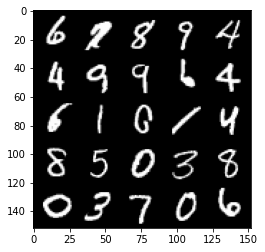

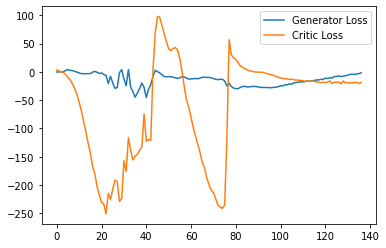

Step 2800: Generator loss: 3.846945112347603, critic loss: -5.287430166840554


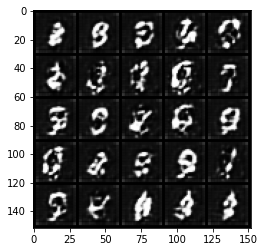

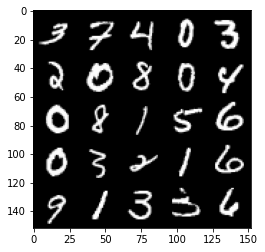

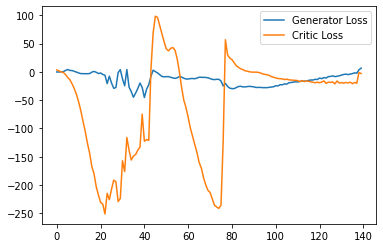

Step 2850: Generator loss: 4.223446578979492, critic loss: -4.682090764045715


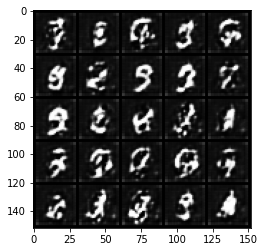

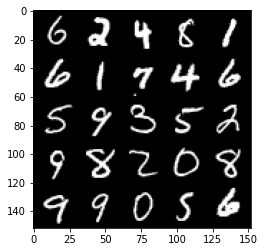

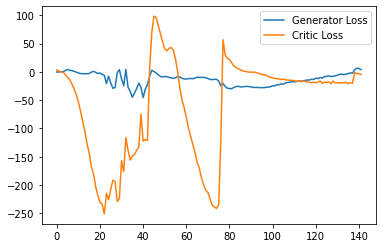

Step 2900: Generator loss: -0.241079098880291, critic loss: -14.640733602523802


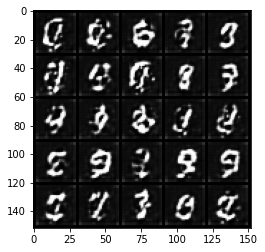

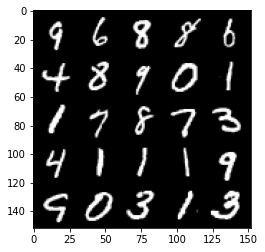

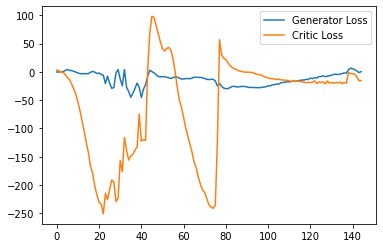

Step 2950: Generator loss: 5.4042221981287, critic loss: -9.246871601104738


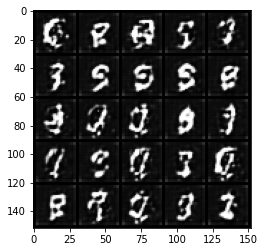

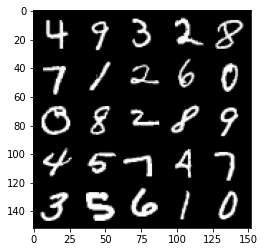

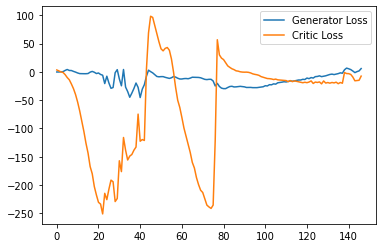

Step 3000: Generator loss: 9.216611890792846, critic loss: -4.67189120578766


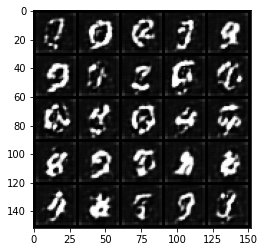

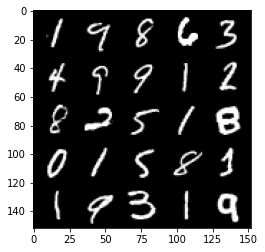

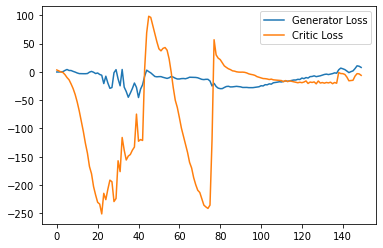

Step 3050: Generator loss: 5.615315403938293, critic loss: -12.164513122558592


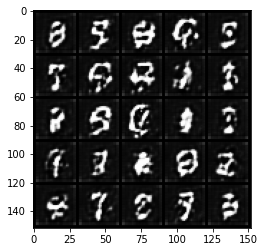

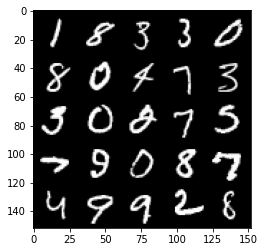

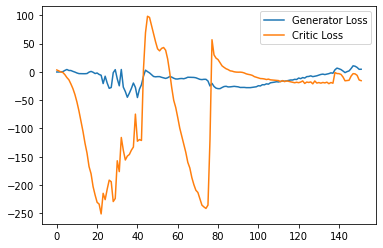

Step 3100: Generator loss: 11.819097995758057, critic loss: -3.010362969398498


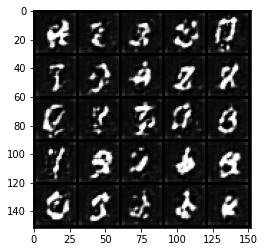

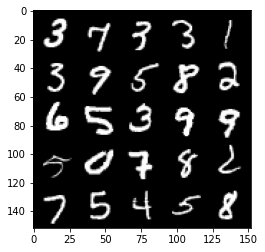

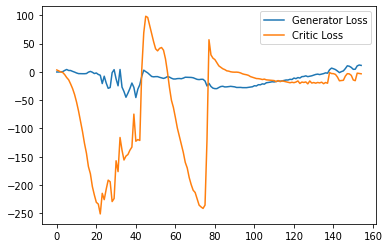

Step 3150: Generator loss: 7.8752291297912596, critic loss: -10.147109816372394


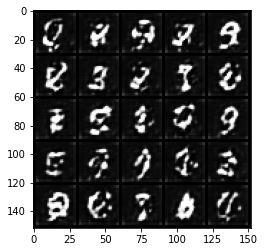

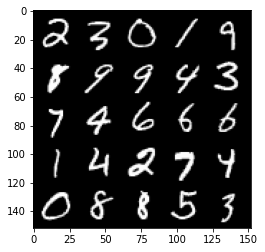

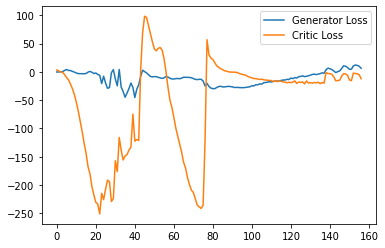

Step 3200: Generator loss: 8.09580117702484, critic loss: -15.1078593532443


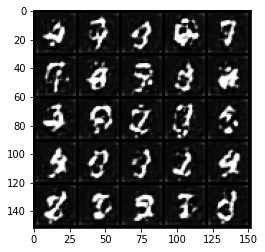

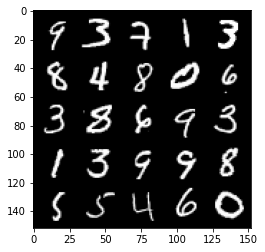

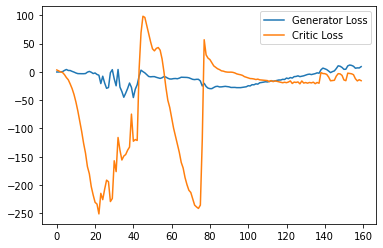

Step 3250: Generator loss: 11.267936315536499, critic loss: -17.04112627363204


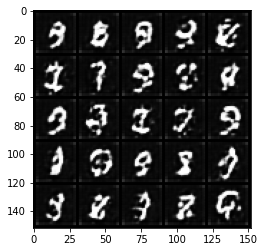

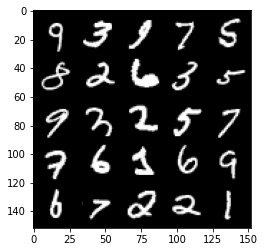

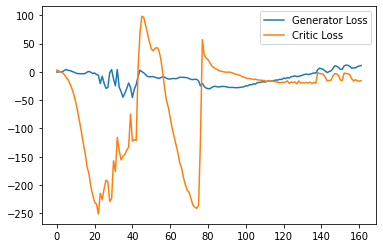

Step 3300: Generator loss: 12.141617956161499, critic loss: -17.661525930047038


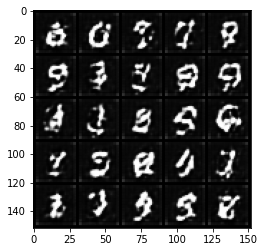

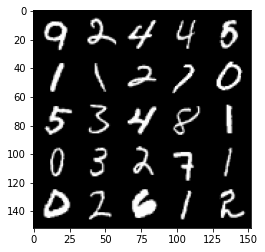

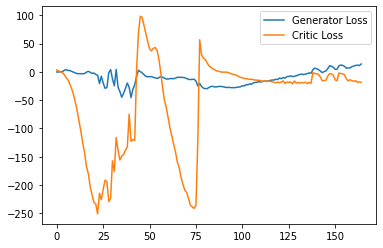

Step 3350: Generator loss: 14.309769945144653, critic loss: -14.731115267276763


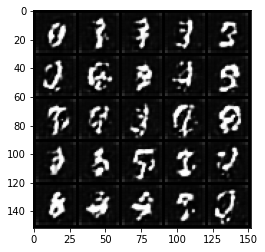

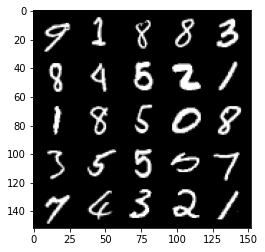

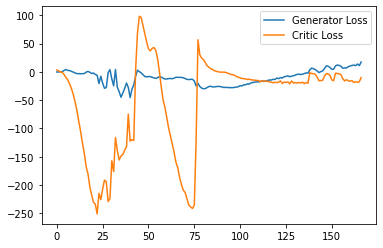

Step 3400: Generator loss: 18.2944913482666, critic loss: -10.07705884027481


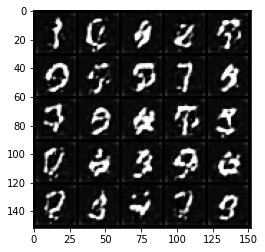

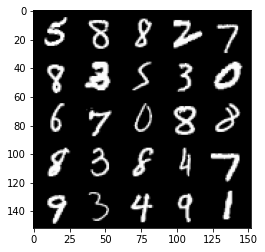

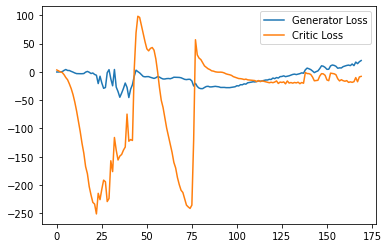

Step 3450: Generator loss: 16.923422832489013, critic loss: -17.872284173488616


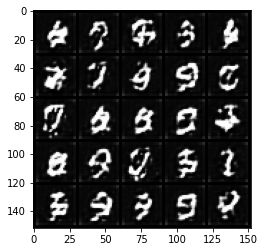

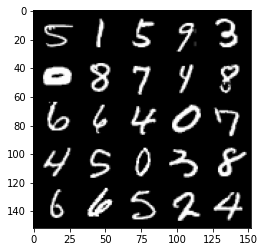

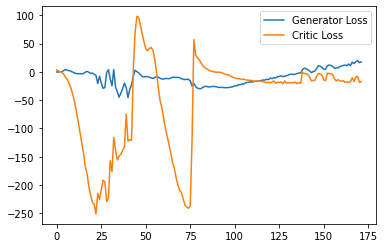

Step 3500: Generator loss: 23.237165412902833, critic loss: -7.445069431781771


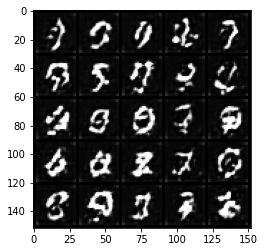

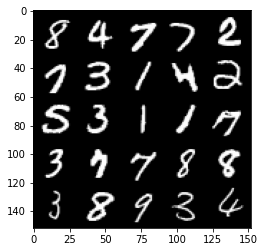

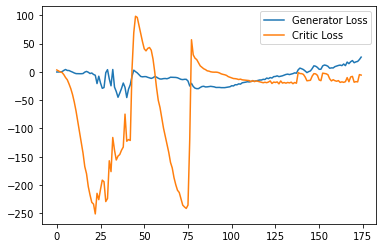

Step 3550: Generator loss: 20.827714462280273, critic loss: -17.484723284602165


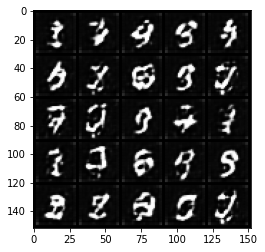

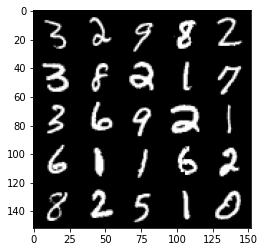

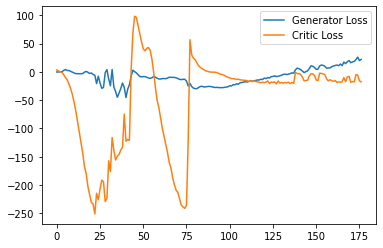

Step 3600: Generator loss: 23.473179435729982, critic loss: -17.127786523342134


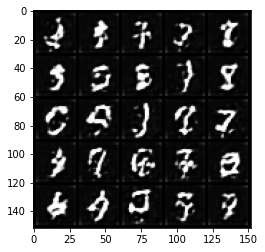

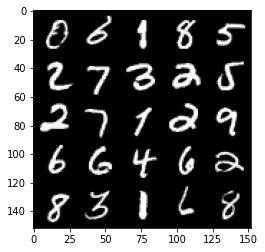

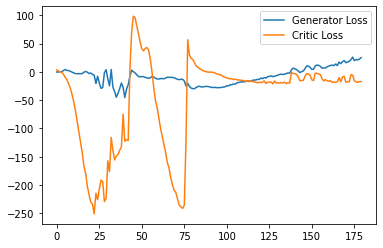

Step 3650: Generator loss: 24.742889366149903, critic loss: -17.05278507566452


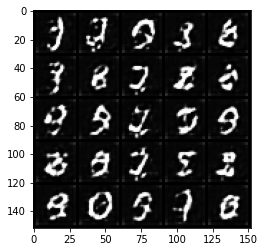

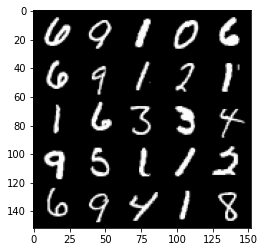

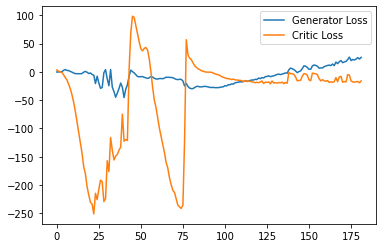

Step 3700: Generator loss: 26.035530853271485, critic loss: -14.529571517467497


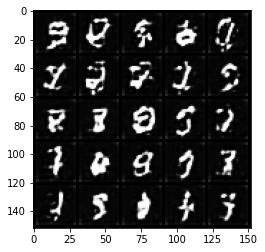

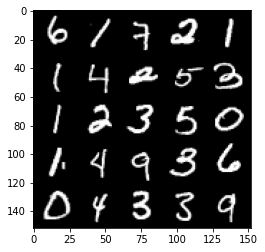

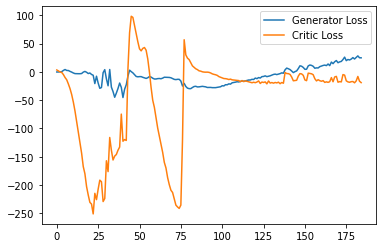

Step 3750: Generator loss: 27.108107604980468, critic loss: -17.766440113306043


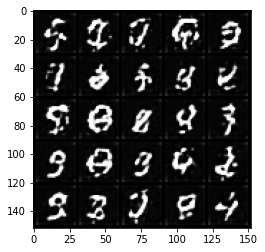

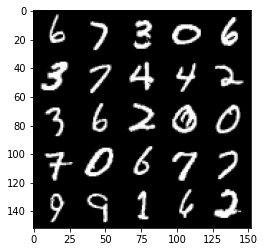

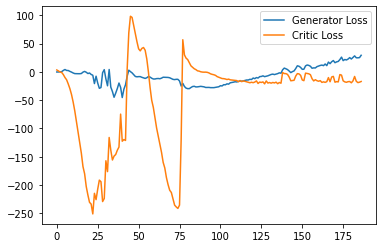

Step 3800: Generator loss: 27.954178657531738, critic loss: -17.373238627791405


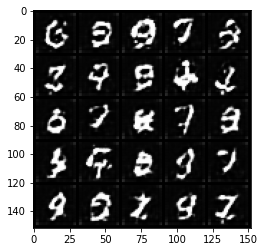

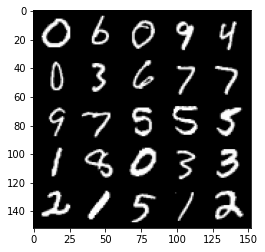

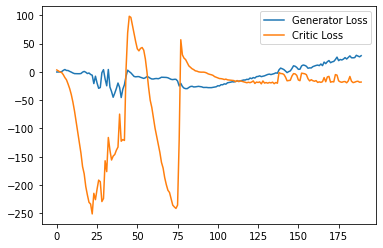

Step 3850: Generator loss: 28.10106216430664, critic loss: -18.399934983313084


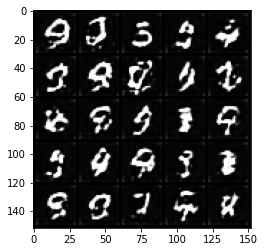

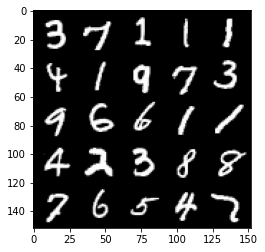

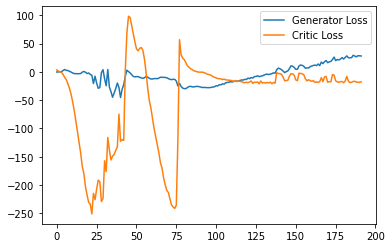

Step 3900: Generator loss: 30.947694129943848, critic loss: -16.151114551782612


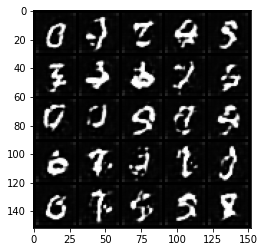

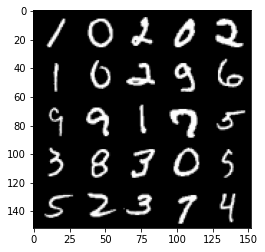

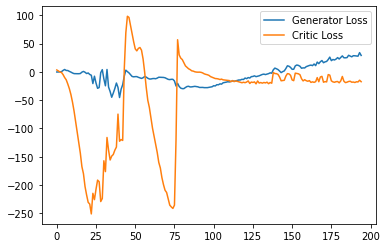

Step 3950: Generator loss: 34.09870040893555, critic loss: -3.545510959863663


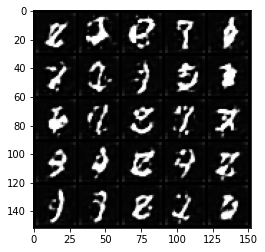

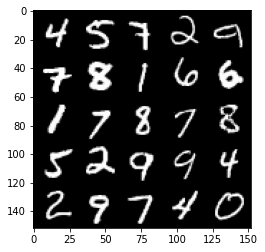

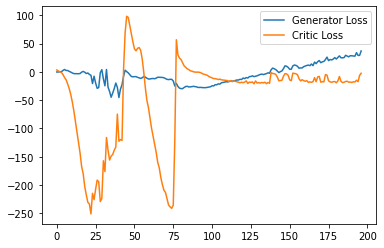

Step 4000: Generator loss: 35.78838218688965, critic loss: -3.1229081840515147


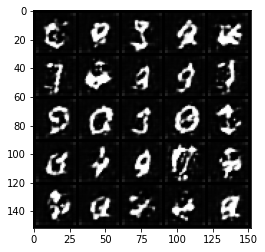

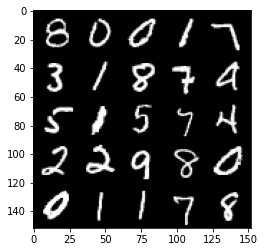

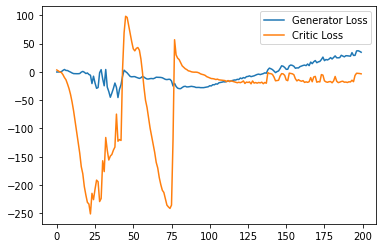

Step 4050: Generator loss: 29.32585231781006, critic loss: -12.67353048229217


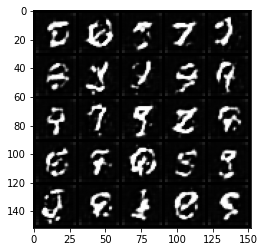

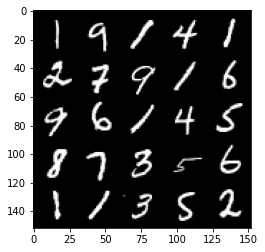

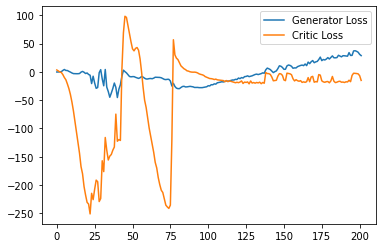

Step 4100: Generator loss: 30.91063430786133, critic loss: -15.835717197418214


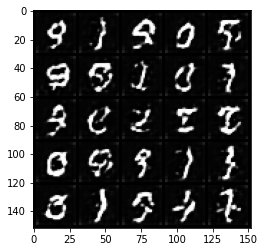

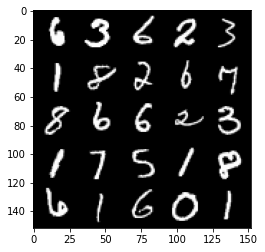

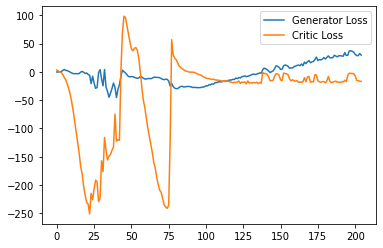

Step 4150: Generator loss: 32.216182441711425, critic loss: -13.952874877929684


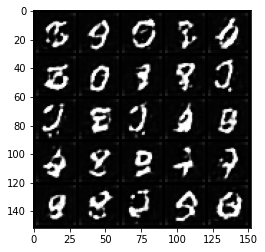

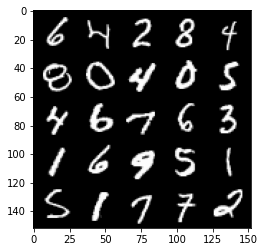

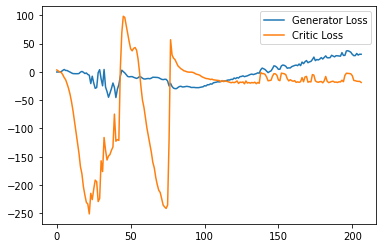

Step 4200: Generator loss: 38.99742179870606, critic loss: -2.7958777084350577


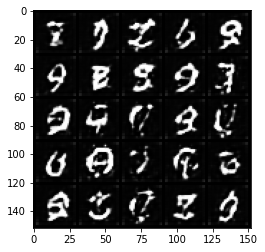

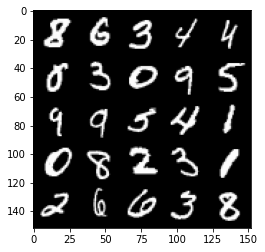

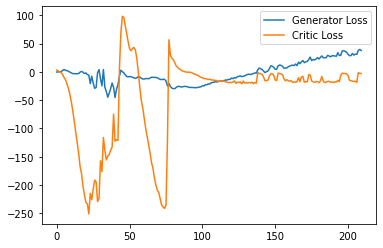

Step 4250: Generator loss: 33.78814350128174, critic loss: -6.141339189529418


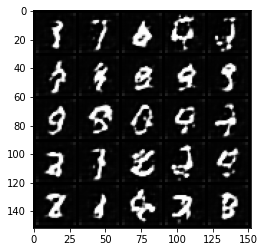

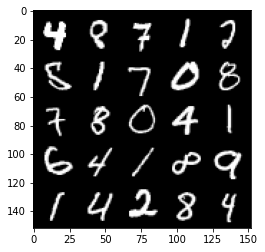

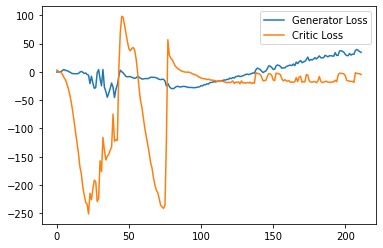

Step 4300: Generator loss: 29.797955436706545, critic loss: -17.375399528682227


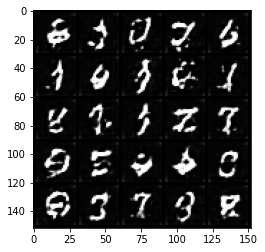

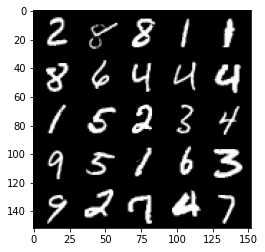

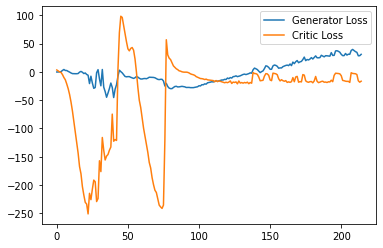

Step 4350: Generator loss: 34.90050300598145, critic loss: -16.281653623342518


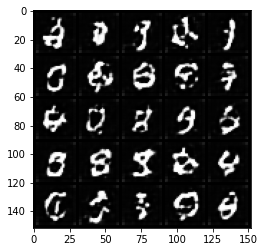

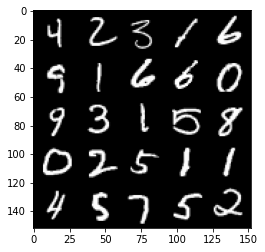

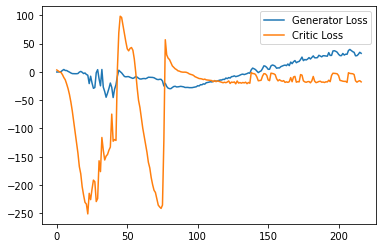

Step 4400: Generator loss: 35.97957805633545, critic loss: -10.472580570310361


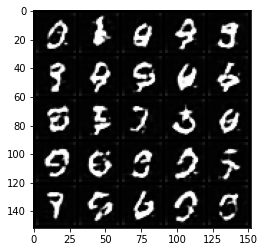

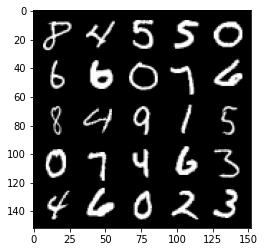

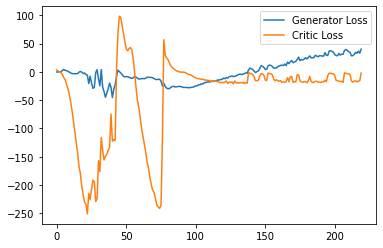

Step 4450: Generator loss: 38.31547325134277, critic loss: -2.848099742889405


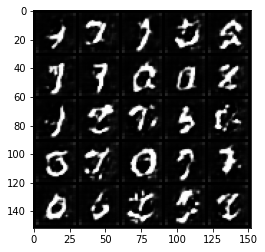

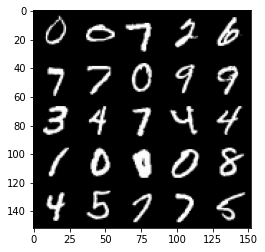

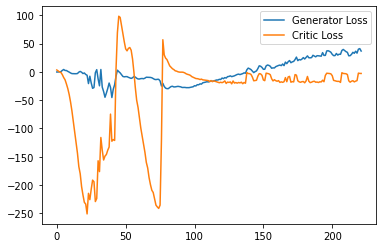

Step 4500: Generator loss: 35.13999134063721, critic loss: -9.09600172305107


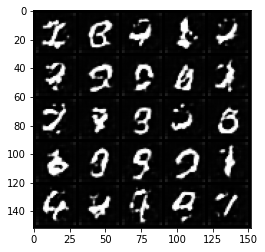

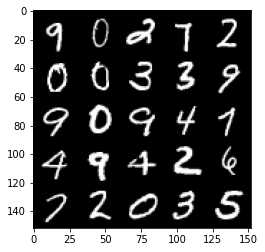

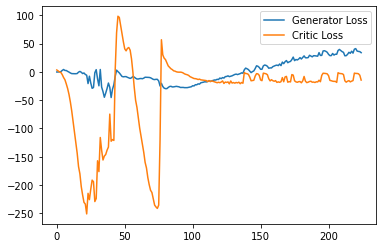

Step 4550: Generator loss: 33.588348960876466, critic loss: -17.51948866558075


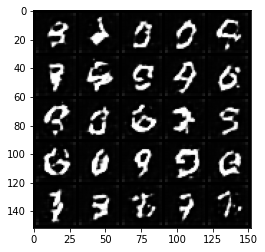

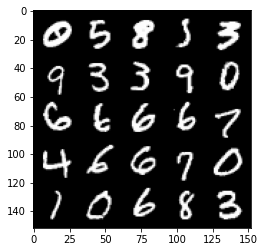

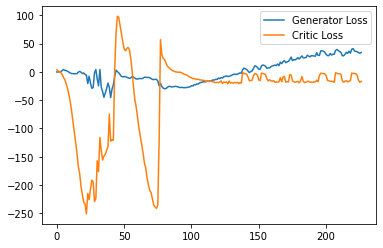

Step 4600: Generator loss: 37.012593803405764, critic loss: -16.99011337518692


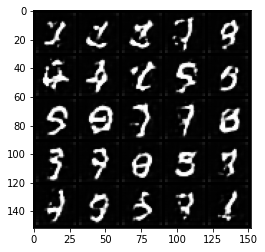

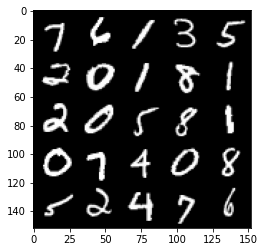

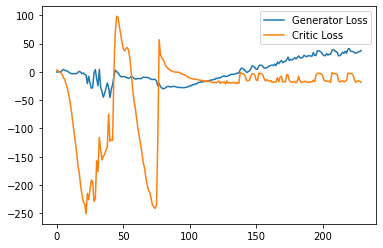

Step 4650: Generator loss: 37.87041247367859, critic loss: -12.476293368816378


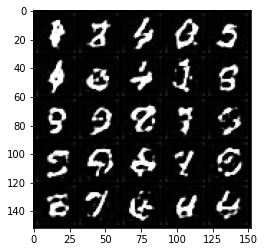

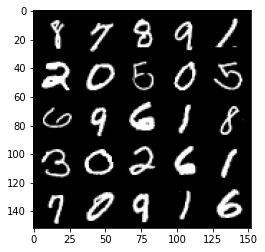

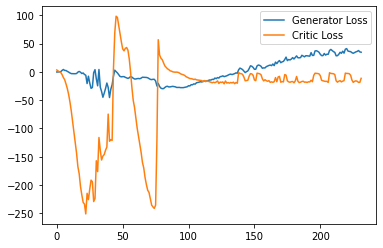

Step 4700: Generator loss: 39.93716896057129, critic loss: -13.72239632451534


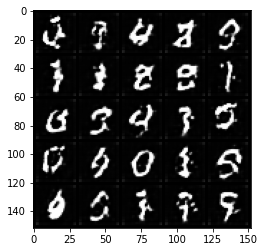

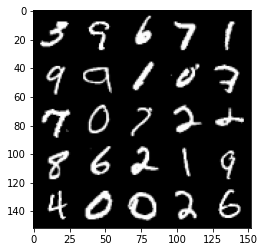

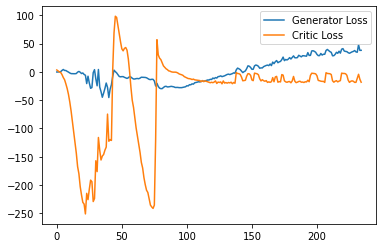

Step 4750: Generator loss: 40.37157783508301, critic loss: -17.020781167268748


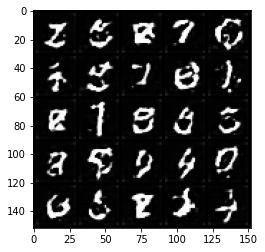

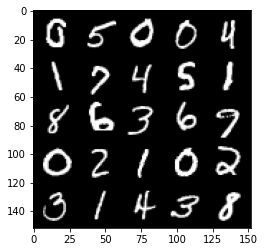

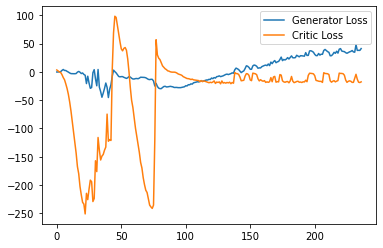

Step 4800: Generator loss: 36.78375953674316, critic loss: -18.92350791954994


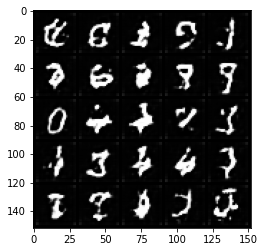

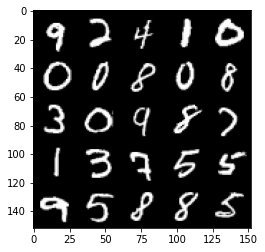

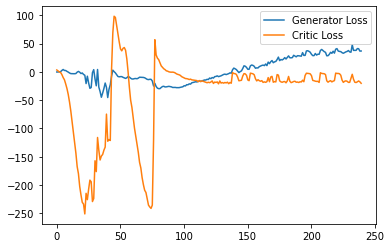

Step 4850: Generator loss: 43.55903347015381, critic loss: -8.250178486824034


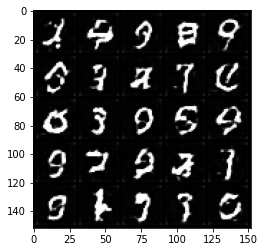

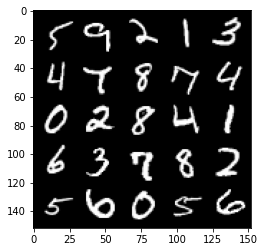

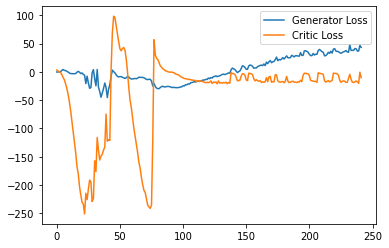

Step 4900: Generator loss: 43.02827140808105, critic loss: -10.036949131488806


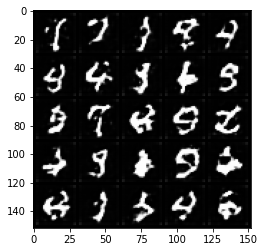

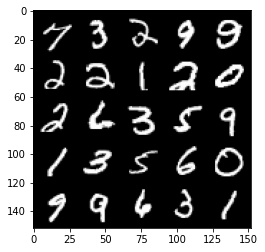

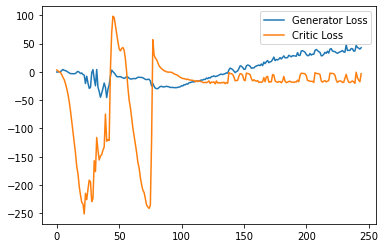

Step 4950: Generator loss: 39.20113914489746, critic loss: -14.264166792631153


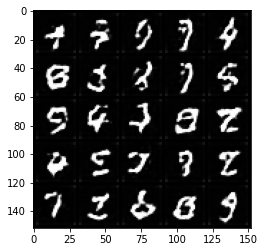

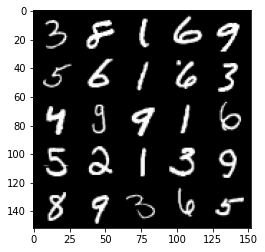

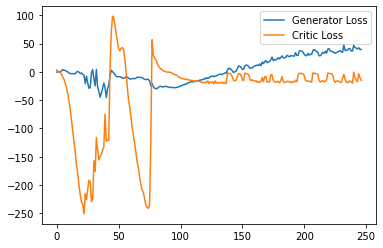

Step 5000: Generator loss: 38.78274524688721, critic loss: -19.050987088441854


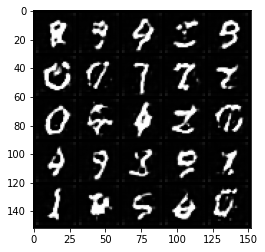

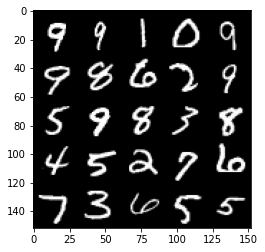

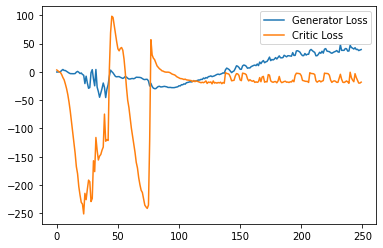

Step 5050: Generator loss: 39.361460494995114, critic loss: -18.744912752628327


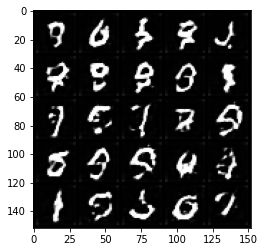

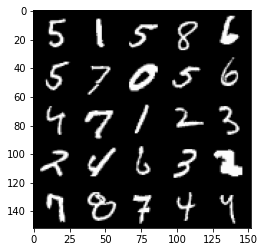

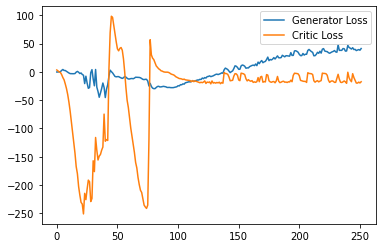

Step 5100: Generator loss: 40.5322859954834, critic loss: -18.803247217833995


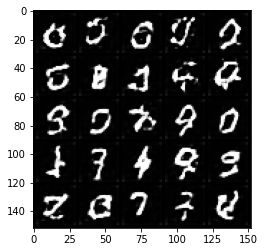

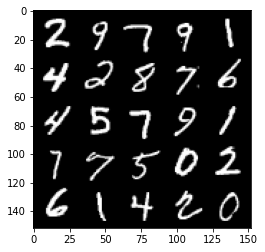

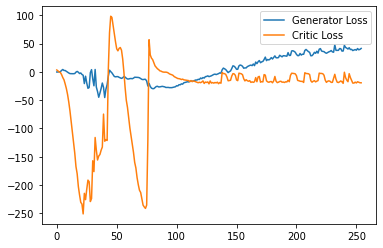

Step 5150: Generator loss: 41.18908325195312, critic loss: -18.600550064325333


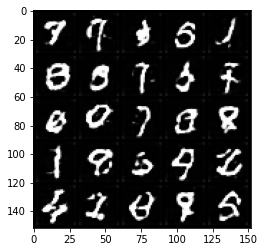

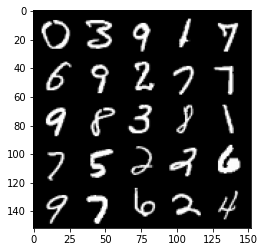

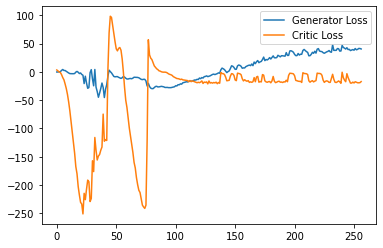

Step 5200: Generator loss: 44.71568778991699, critic loss: -18.748438658952708


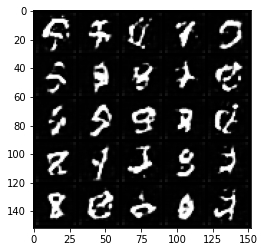

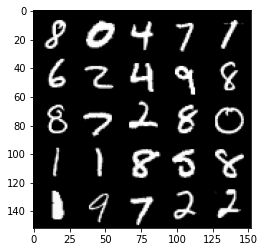

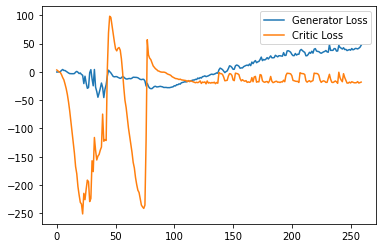

Step 5250: Generator loss: 50.57254875183106, critic loss: 0.3979516551494599


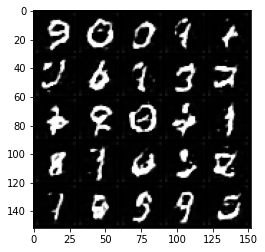

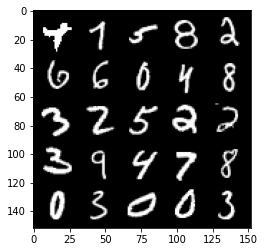

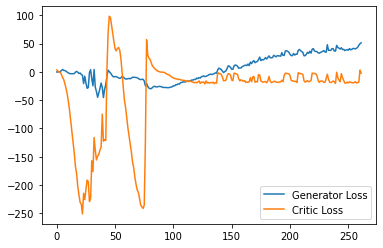

Step 5300: Generator loss: 48.63312507629394, critic loss: -2.4069830965995784


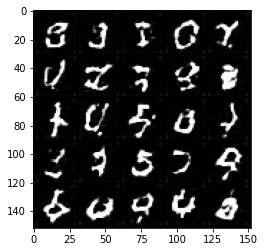

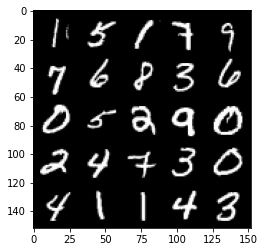

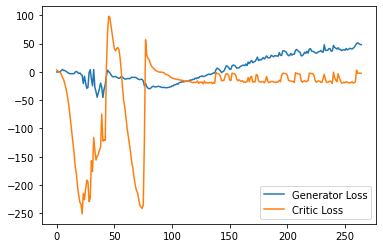

Step 5350: Generator loss: 47.2217268371582, critic loss: -2.653559448242188


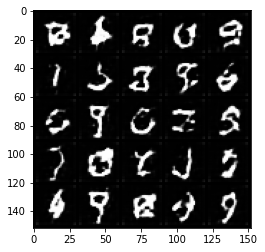

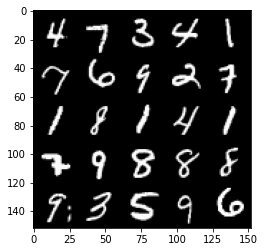

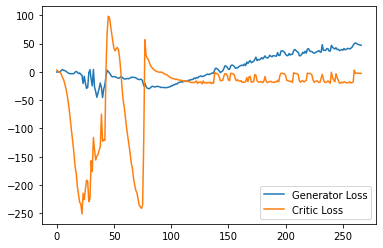

Step 5400: Generator loss: 47.49285179138184, critic loss: -3.069531790733338


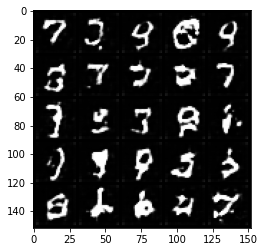

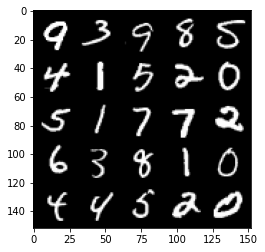

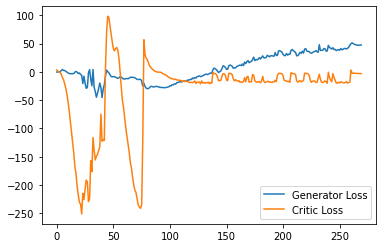

Step 5450: Generator loss: 47.119953079223635, critic loss: -3.825900902748107


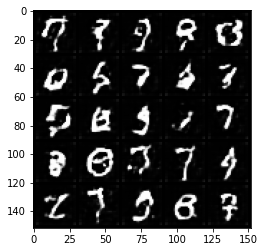

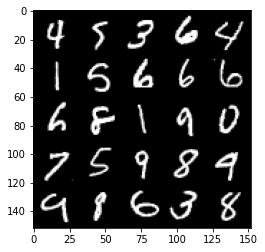

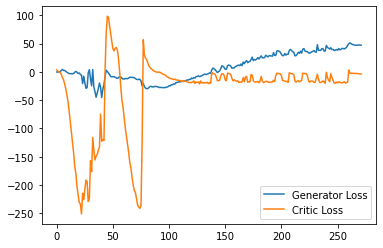

Step 5500: Generator loss: 44.46201126098633, critic loss: -8.752334650039673


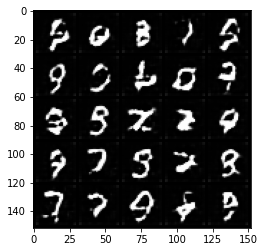

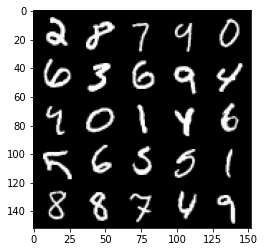

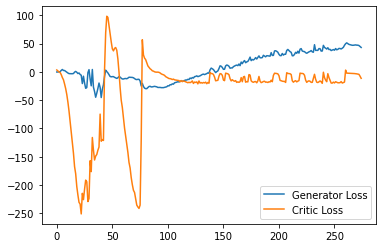

Step 5550: Generator loss: 43.28770622253418, critic loss: -11.640827716559173


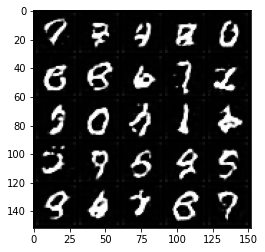

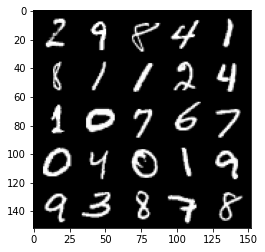

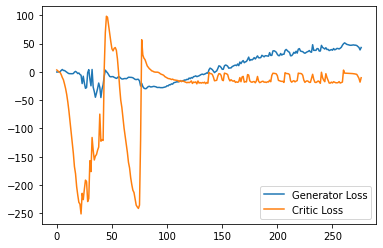

Step 5600: Generator loss: 51.347498397827145, critic loss: -3.3887097234725956


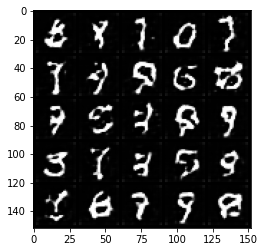

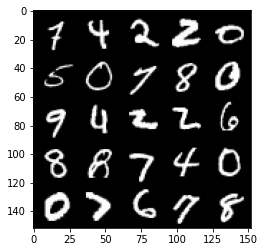

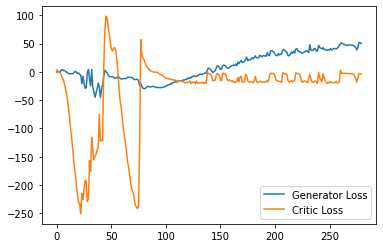

Step 5650: Generator loss: 43.388788299560545, critic loss: -17.600501811027524


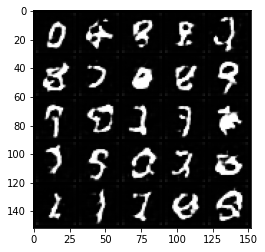

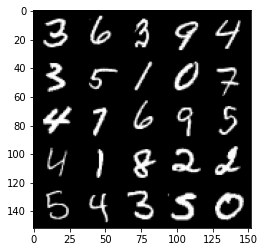

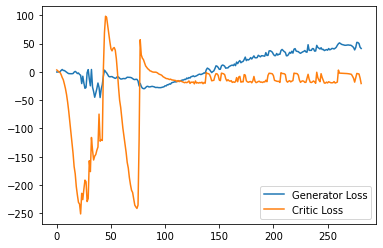

Step 5700: Generator loss: 42.48013343811035, critic loss: -17.94287919068337


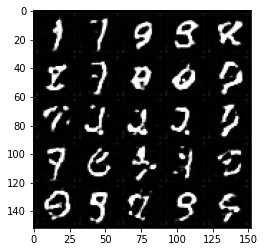

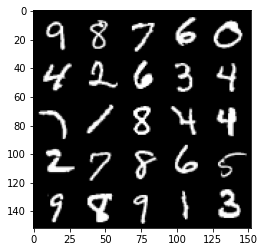

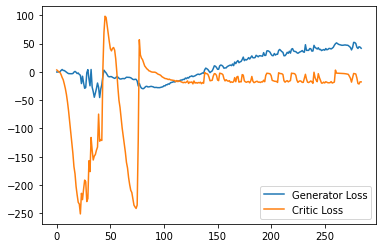

Step 5750: Generator loss: 43.638260192871094, critic loss: -19.180058771848675


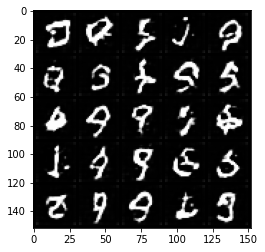

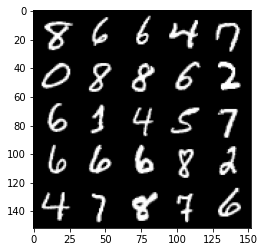

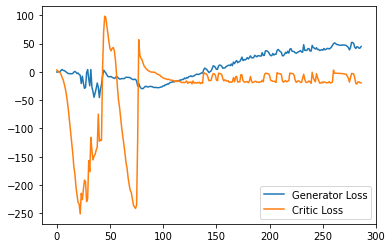

Step 5800: Generator loss: 44.388614654541016, critic loss: -20.285769274234777


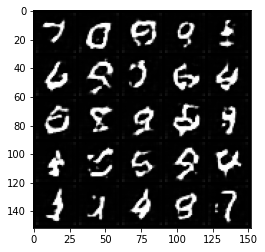

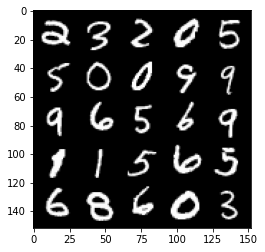

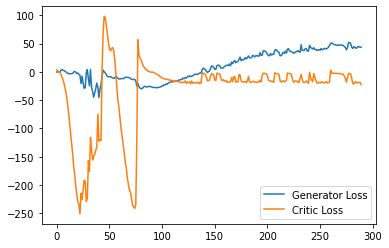

Step 5850: Generator loss: 45.75863410949707, critic loss: -18.579566904902464


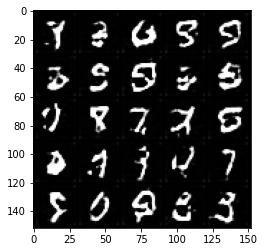

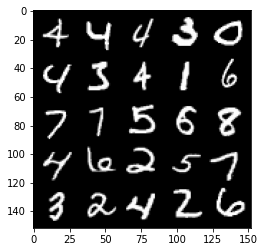

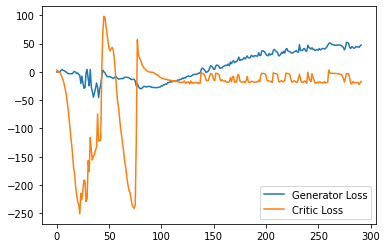

Step 5900: Generator loss: 45.41038223266602, critic loss: -19.2608685952425


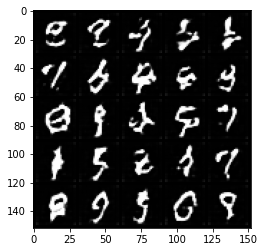

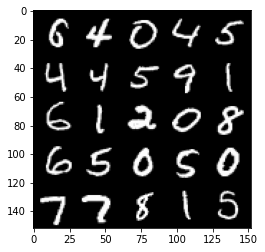

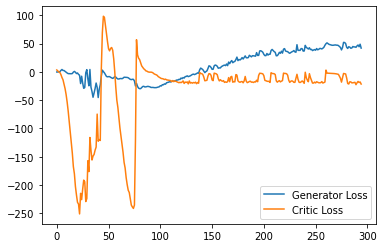

Step 5950: Generator loss: 47.996632766723636, critic loss: -13.153420807242398


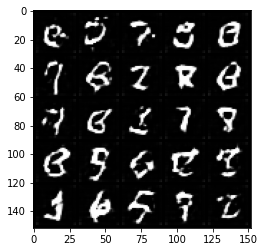

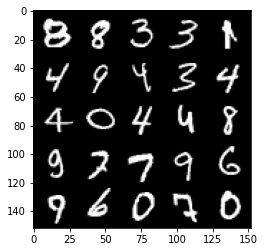

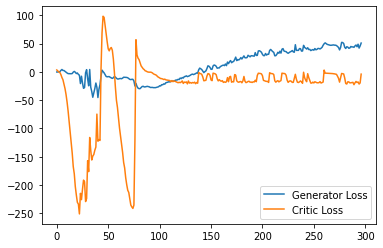

Step 6000: Generator loss: 49.68553985595703, critic loss: -6.08229090923071


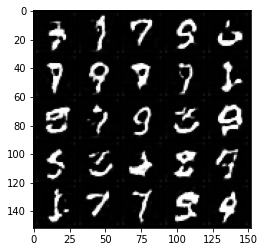

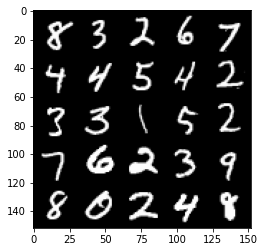

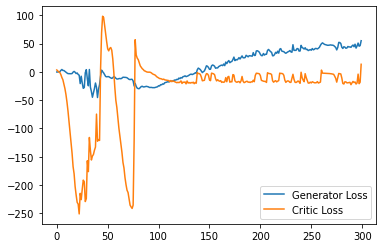

Step 6050: Generator loss: 52.43477172851563, critic loss: -2.9335215692520147


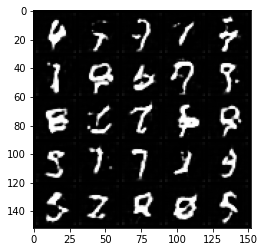

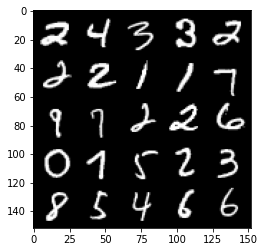

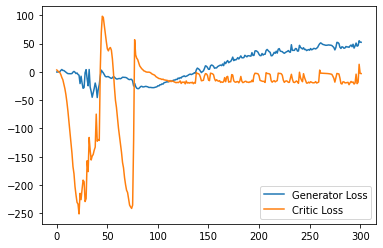

Step 6100: Generator loss: 50.631924057006835, critic loss: -3.4567369489669795


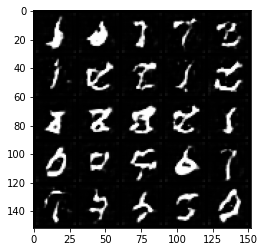

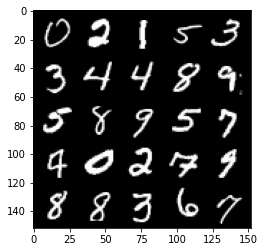

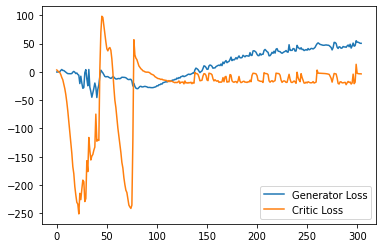

Step 6150: Generator loss: 49.24879203796387, critic loss: -8.991746512532234


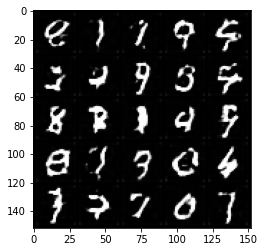

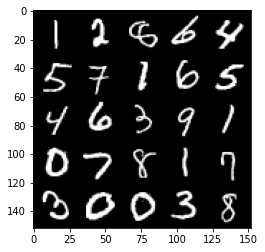

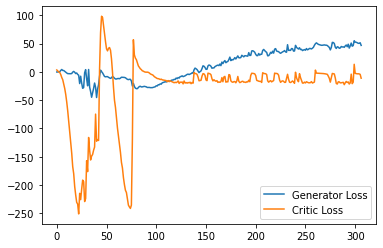

Step 6200: Generator loss: 47.36777923583984, critic loss: -17.42739730012417


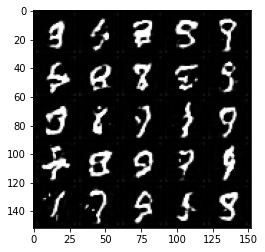

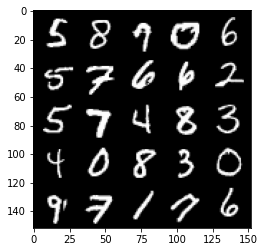

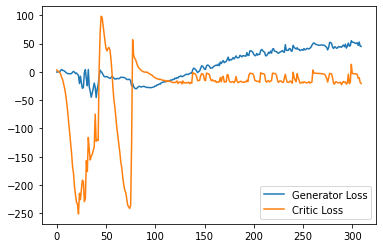

Step 6250: Generator loss: 45.33823692321777, critic loss: -20.326591019988058


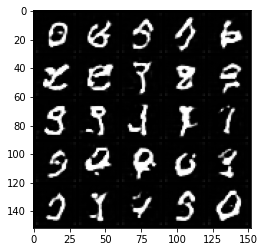

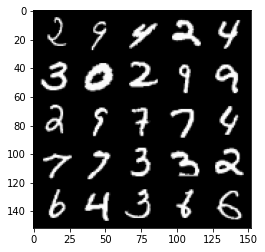

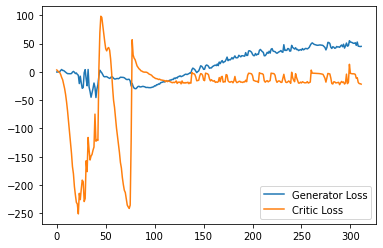

Step 6300: Generator loss: 46.18894012451172, critic loss: -20.47492931830883


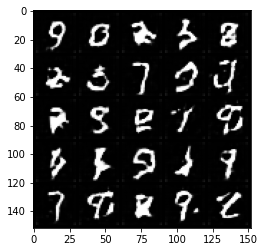

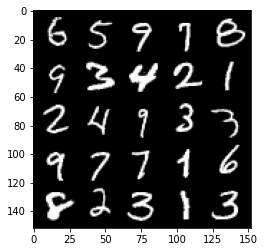

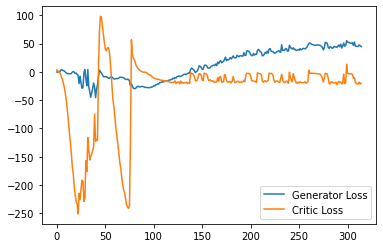

Step 6350: Generator loss: 47.73974632263184, critic loss: -18.356893116950985


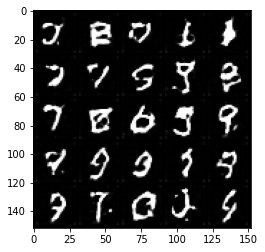

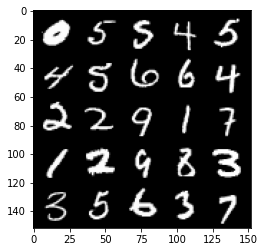

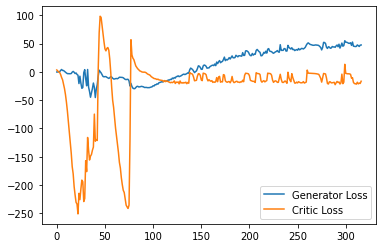

Step 6400: Generator loss: 46.72006088256836, critic loss: -18.682338133811953


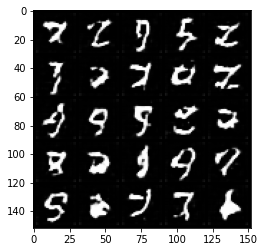

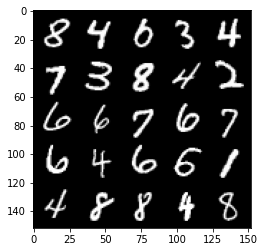

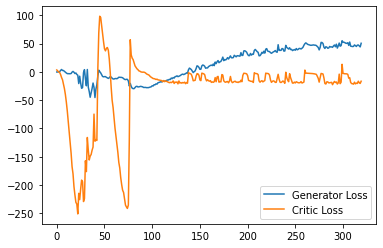

Step 6450: Generator loss: 46.099134063720705, critic loss: -20.61312746691704


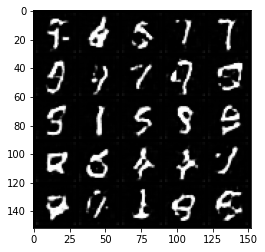

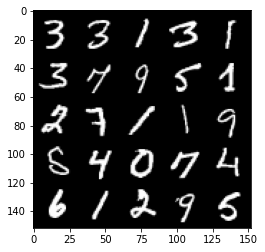

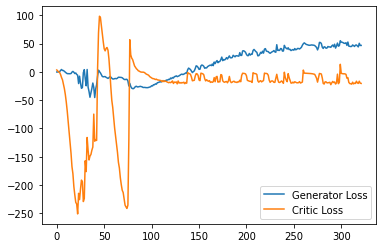

Step 6500: Generator loss: 45.70229263305664, critic loss: -17.181563794612877


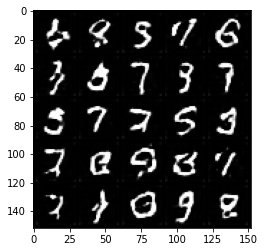

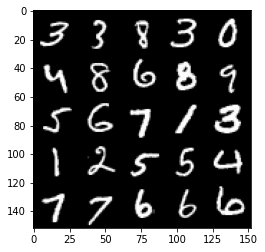

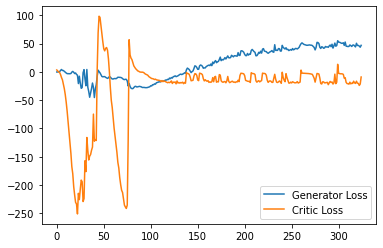

Step 6550: Generator loss: 47.84558753967285, critic loss: -14.086310760736467


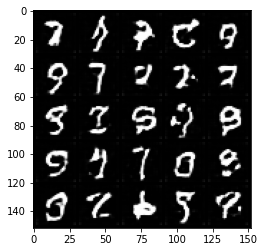

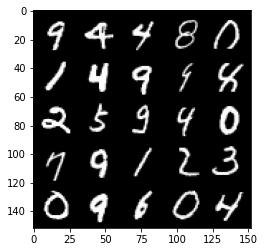

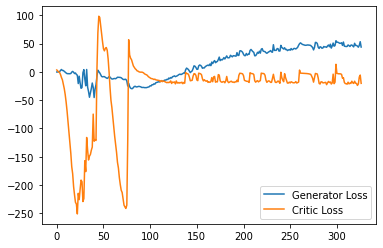

Step 6600: Generator loss: 45.27413558959961, critic loss: -22.063964704751967


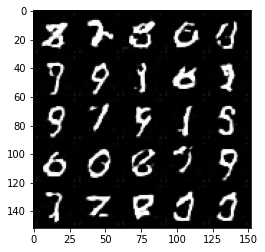

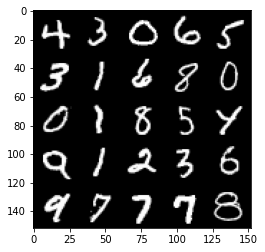

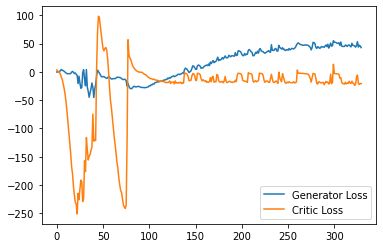

Step 6650: Generator loss: 44.94956642150879, critic loss: -21.268211956977844


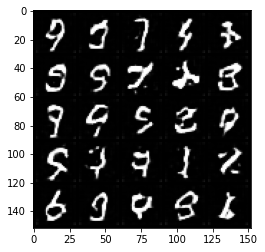

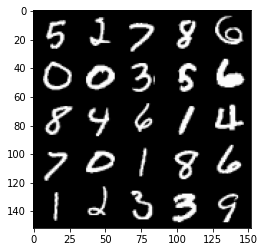

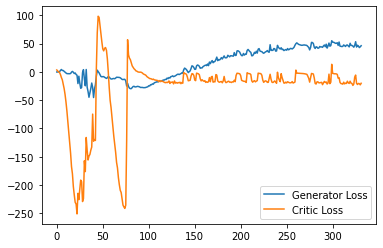

Step 6700: Generator loss: 46.4203377532959, critic loss: -20.161831435203553


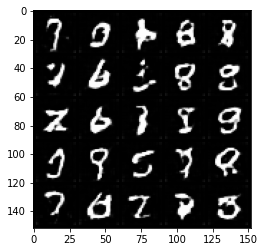

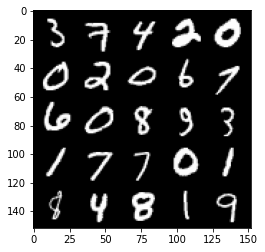

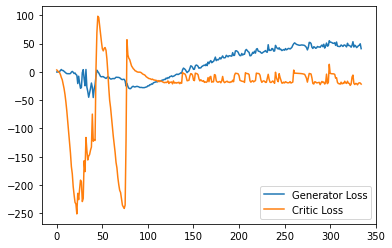

Step 6750: Generator loss: 44.245367202758786, critic loss: -21.658754264116283


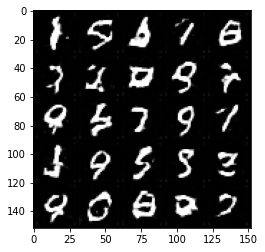

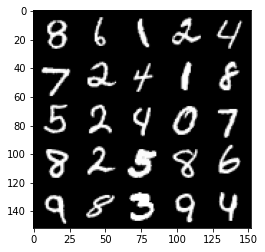

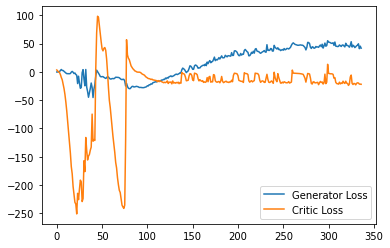

Step 6800: Generator loss: 55.777858352661134, critic loss: 4.496301214456557


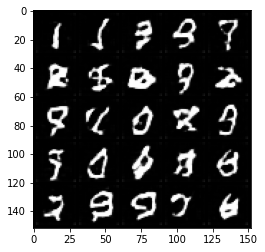

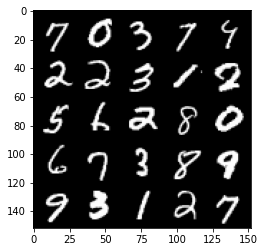

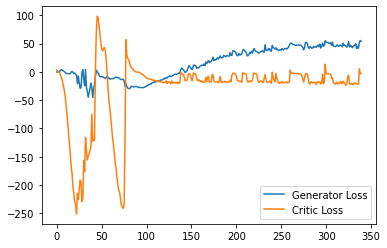

Step 6850: Generator loss: 52.228671340942384, critic loss: -3.6221029577255246


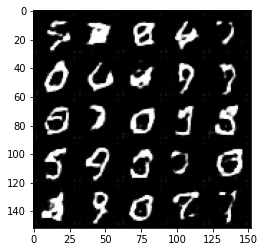

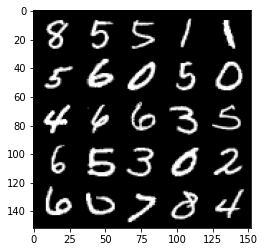

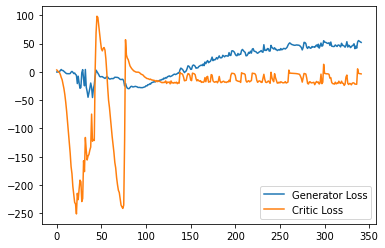

Step 6900: Generator loss: 48.034789123535155, critic loss: -10.35072389948368


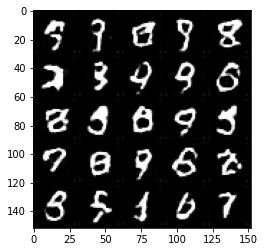

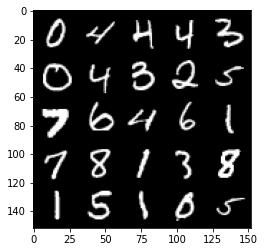

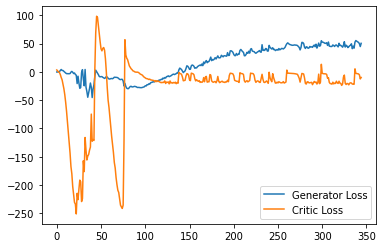

Step 6950: Generator loss: 47.450982360839845, critic loss: -14.557076013565062


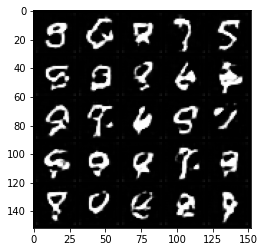

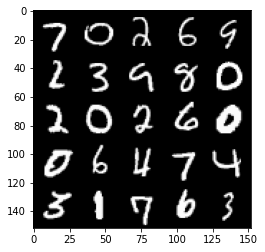

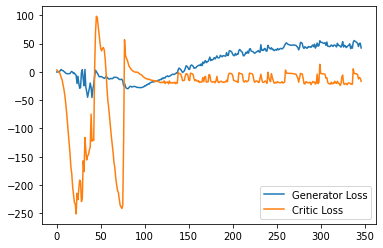

Step 7000: Generator loss: 46.24537441253662, critic loss: -16.109009101510047


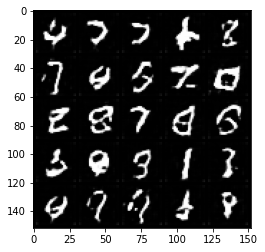

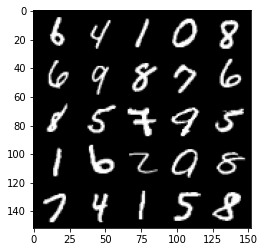

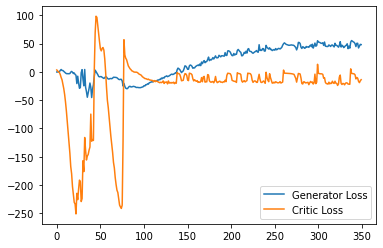

Step 7050: Generator loss: 46.359509315490726, critic loss: -18.440241712331773


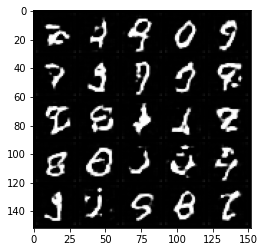

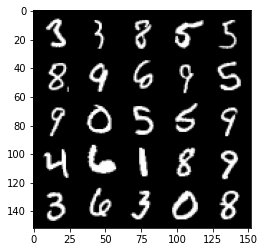

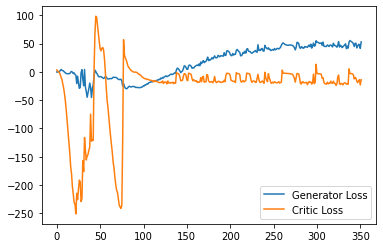

Step 7100: Generator loss: 46.35267478942871, critic loss: -18.930695106506345


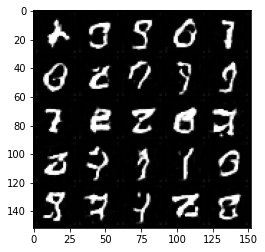

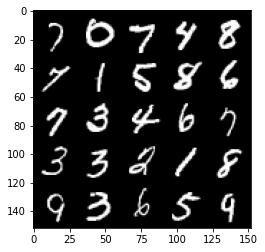

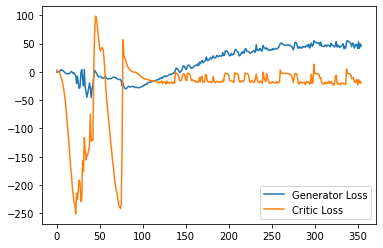

Step 7150: Generator loss: 49.583512420654294, critic loss: -16.54710863018036


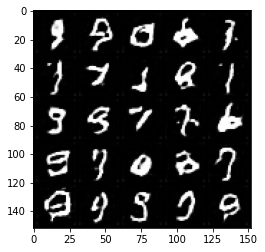

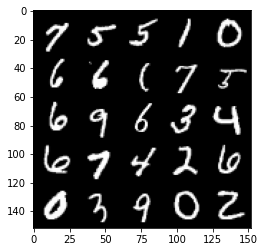

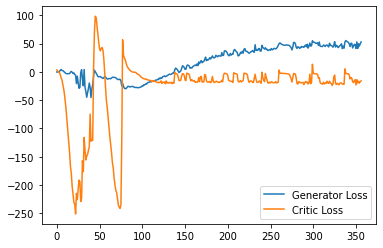

Step 7200: Generator loss: 46.208342418670654, critic loss: -11.844883003950118


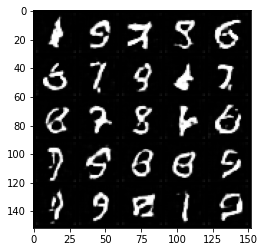

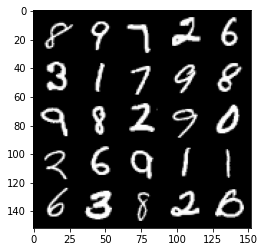

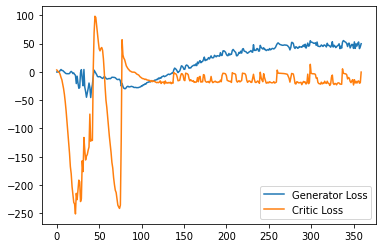

Step 7250: Generator loss: 54.13670463562012, critic loss: -7.339832722187044


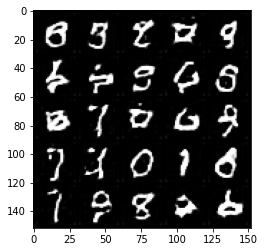

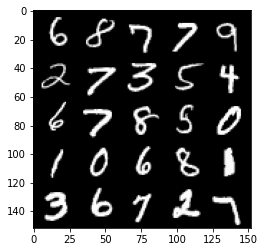

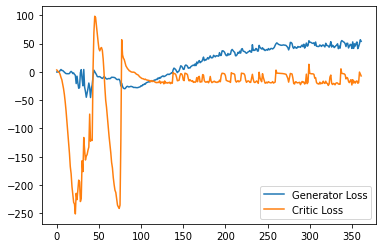

Step 7300: Generator loss: 47.88423583984375, critic loss: -19.935361433297395


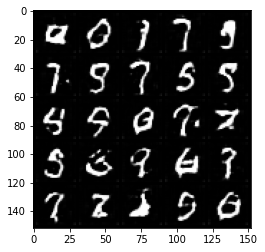

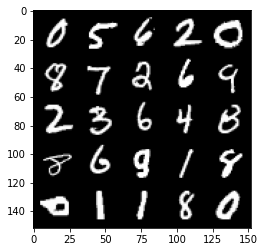

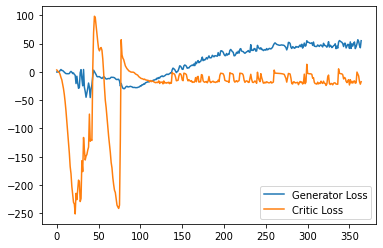

Step 7350: Generator loss: 47.649477310180664, critic loss: -16.57240682351589


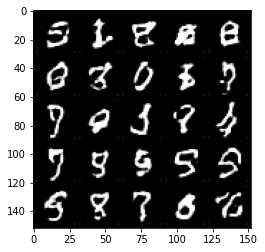

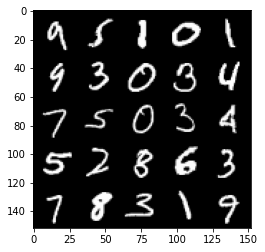

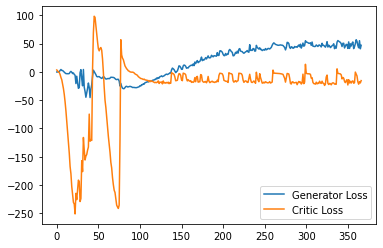

Step 7400: Generator loss: 44.8115885925293, critic loss: -20.230090508401393


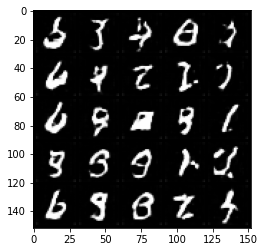

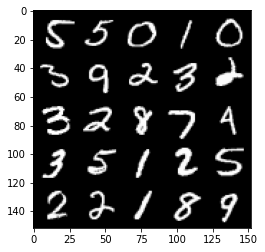

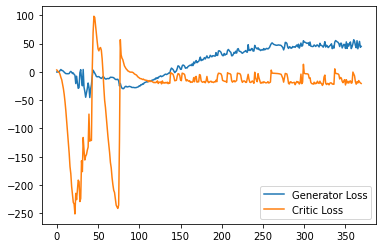

Step 7450: Generator loss: 45.03273872375488, critic loss: -15.106692247390747


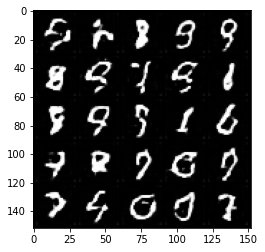

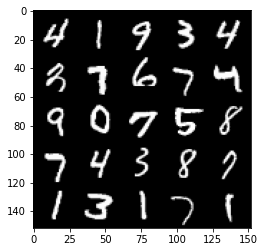

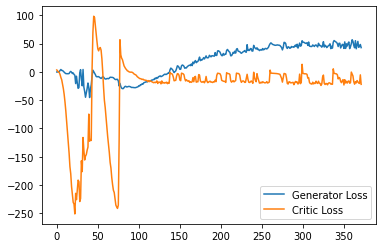

Step 7500: Generator loss: 46.97995719909668, critic loss: -19.39826026713848


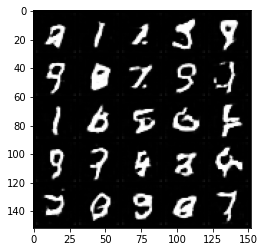

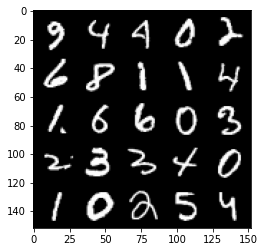

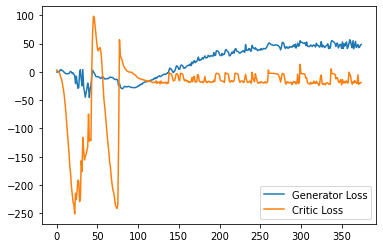

Step 7550: Generator loss: 44.330925674438475, critic loss: -21.644972123861308


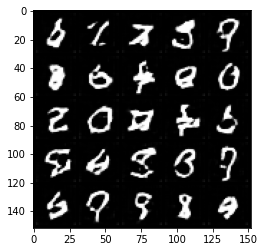

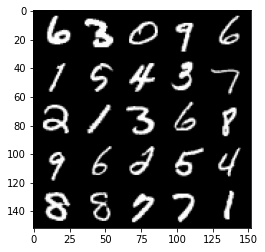

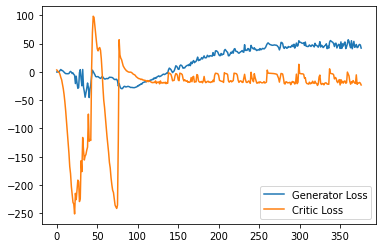

Step 7600: Generator loss: 55.21469787597656, critic loss: -17.18748287668824


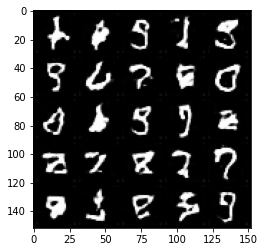

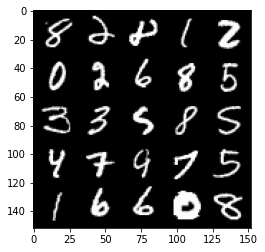

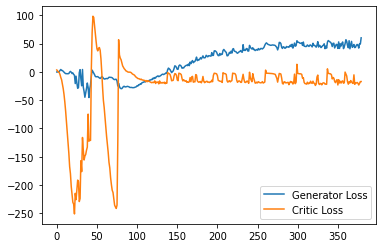

Step 7650: Generator loss: 46.6241760635376, critic loss: -22.56288808918


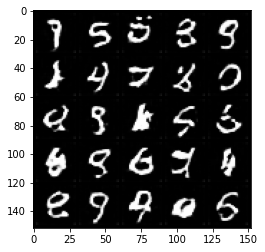

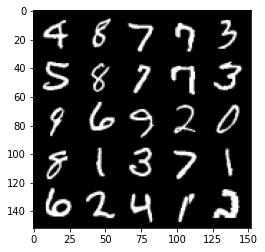

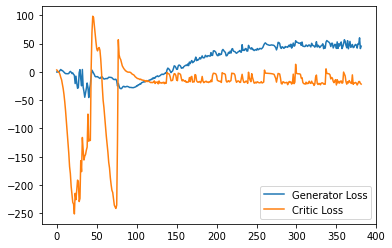

Step 7700: Generator loss: 48.21364849090576, critic loss: -15.561673065245152


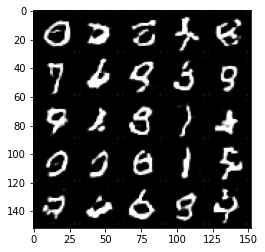

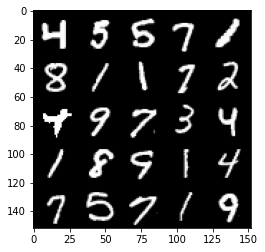

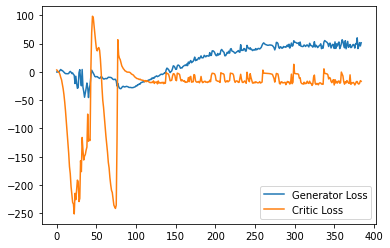

Step 7750: Generator loss: 50.27770793914795, critic loss: -8.529359455168253


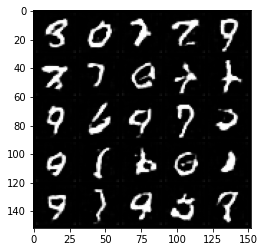

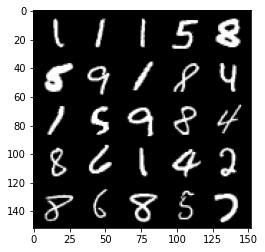

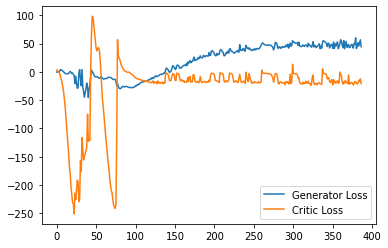

Step 7800: Generator loss: 56.34156585693359, critic loss: -3.191318961143493


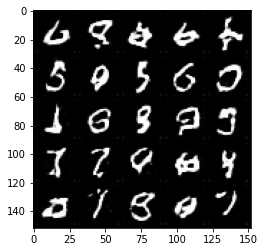

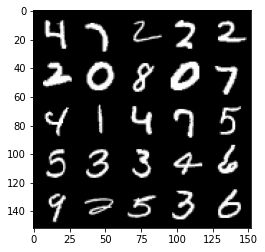

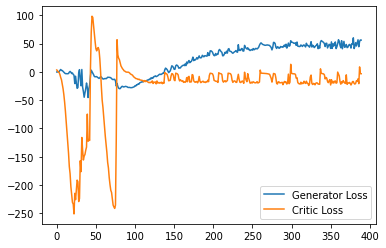

Step 7850: Generator loss: 54.31028594970703, critic loss: -3.8770550889968867


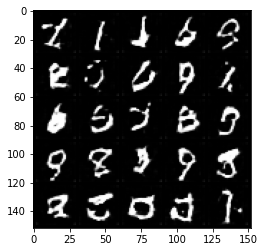

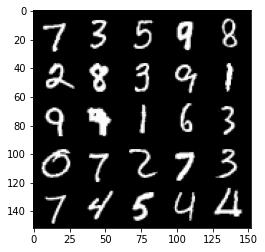

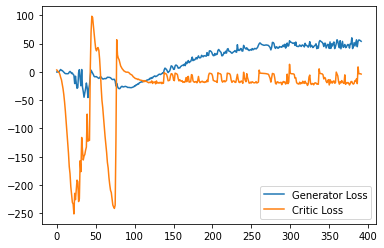

Step 7900: Generator loss: 43.84631065368652, critic loss: -19.484910407066344


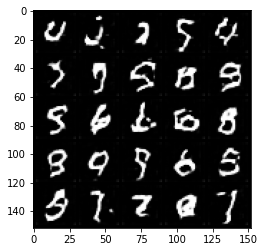

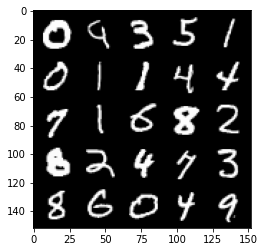

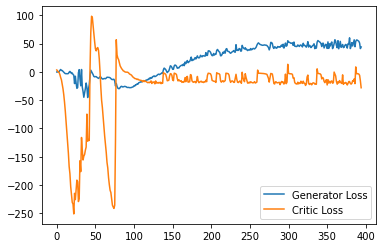

Step 7950: Generator loss: 50.39214275360107, critic loss: -6.080298131942744


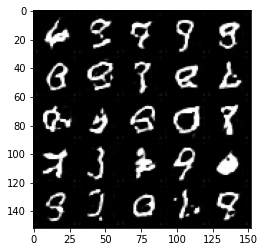

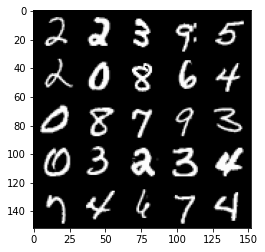

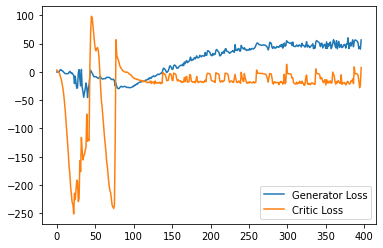

Step 8000: Generator loss: 56.509740295410154, critic loss: -3.4077009887695326


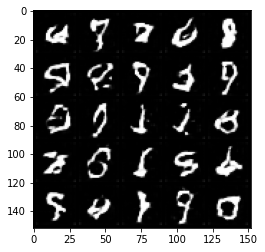

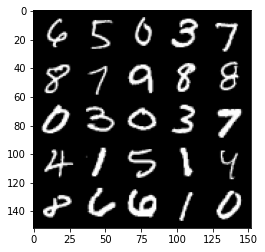

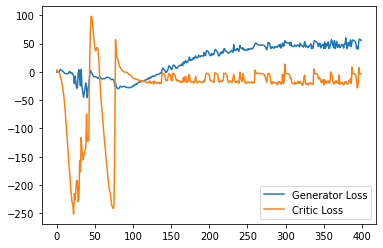

Step 8050: Generator loss: 48.80102378845215, critic loss: -14.475947572827335


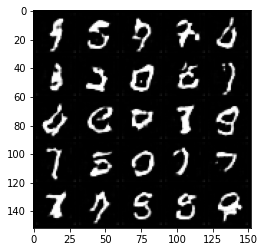

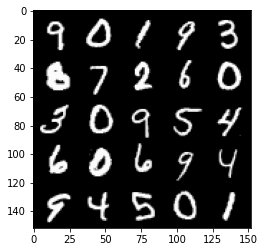

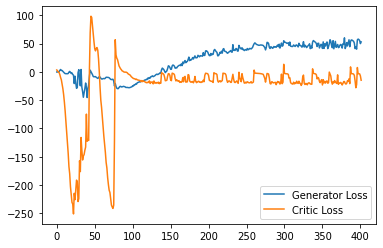

Step 8100: Generator loss: 51.92396934509277, critic loss: -2.211312037229537


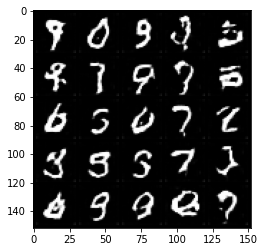

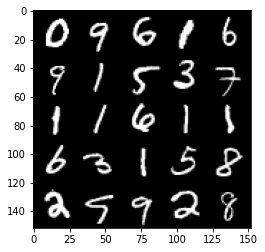

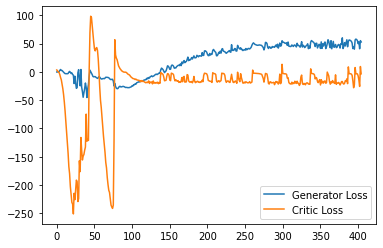

Step 8150: Generator loss: 49.086232299804685, critic loss: -11.513294622957705


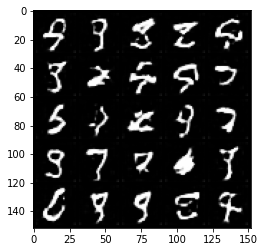

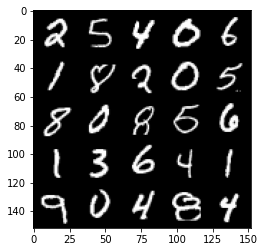

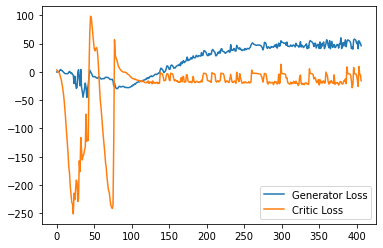

Step 8200: Generator loss: 42.97534130096435, critic loss: -23.018468239784237


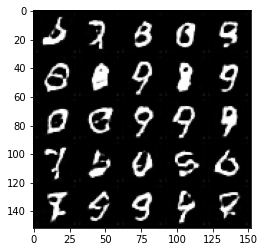

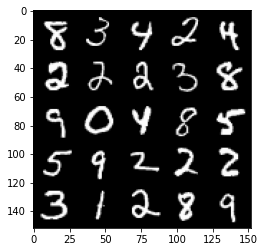

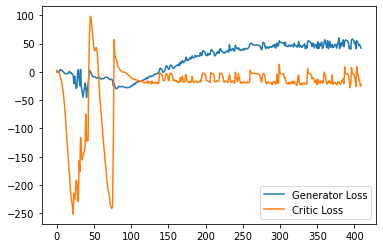

Step 8250: Generator loss: 47.61740463256836, critic loss: -18.455891603350636


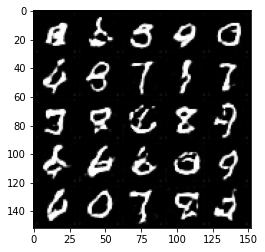

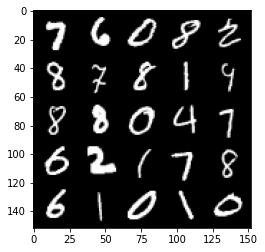

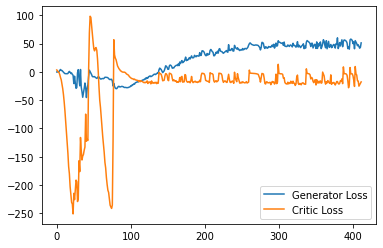

Step 8300: Generator loss: 47.54285758972168, critic loss: -18.442862197935586


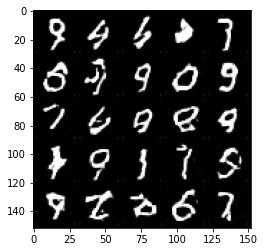

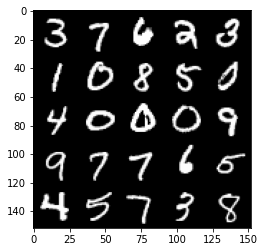

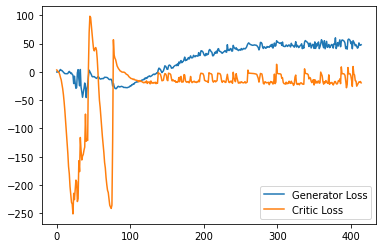

Step 8350: Generator loss: 45.398452835083006, critic loss: -19.856025437116624


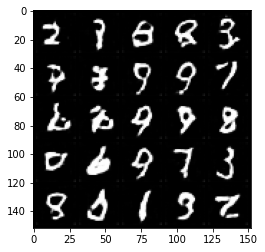

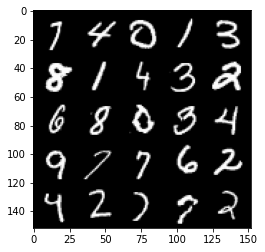

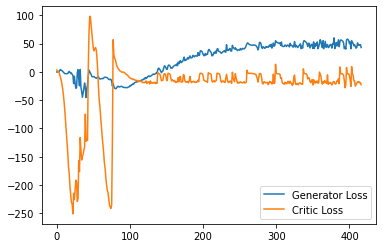

Step 8400: Generator loss: 57.15927864074707, critic loss: 1.6269850516319264


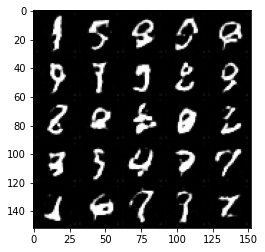

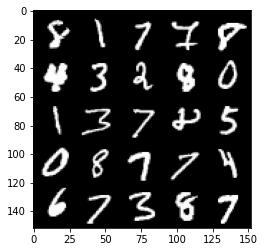

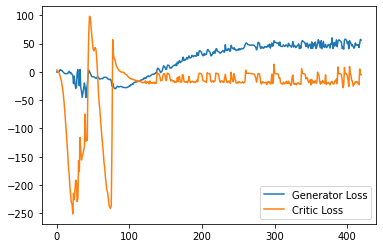

Step 8450: Generator loss: 48.12760284423828, critic loss: -13.585203516483311


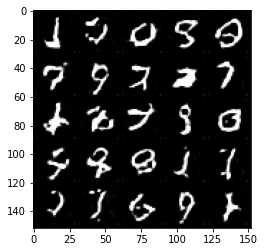

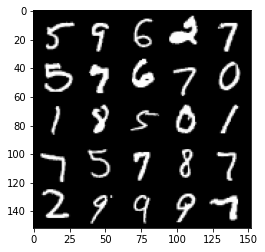

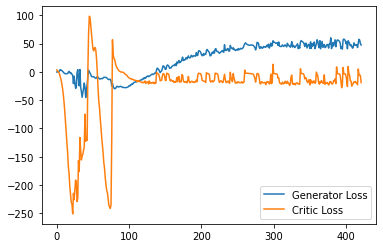

Step 8500: Generator loss: 55.58984535217285, critic loss: -11.2385533387661


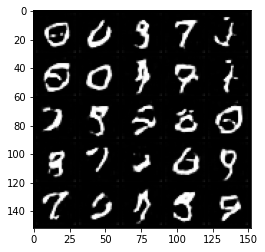

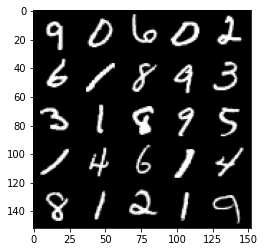

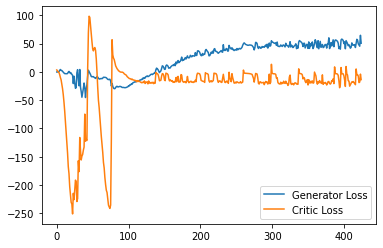

Step 8550: Generator loss: 51.12523551940918, critic loss: -17.513334960103034


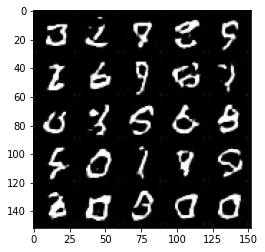

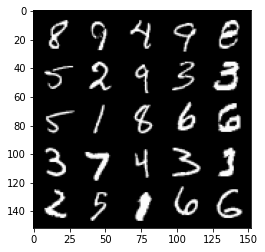

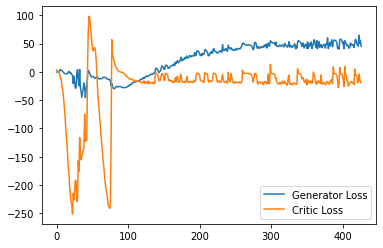

Step 8600: Generator loss: 49.44142234802246, critic loss: -21.490586916804315


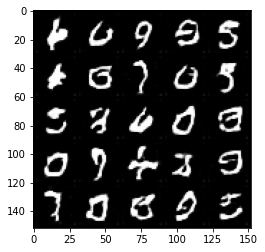

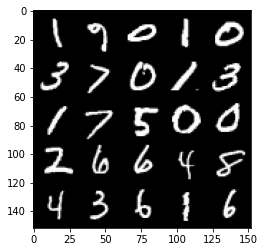

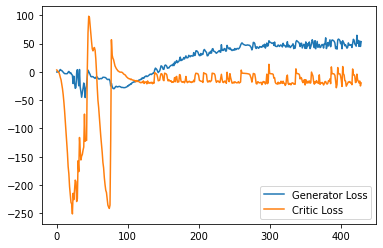

Step 8650: Generator loss: 55.75870910644531, critic loss: -10.733899460196497


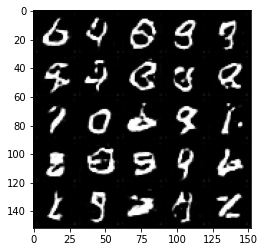

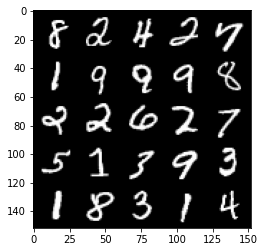

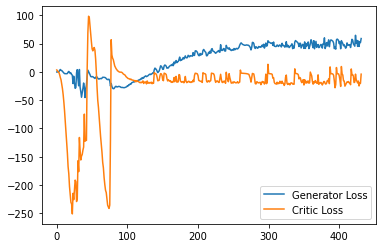

Step 8700: Generator loss: 51.916503257751465, critic loss: -18.995001672744753


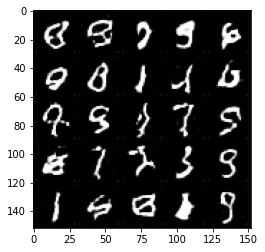

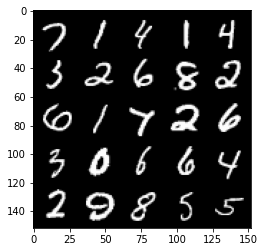

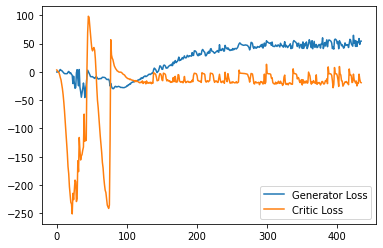

Step 8750: Generator loss: 44.54343994140625, critic loss: -22.129327858090402


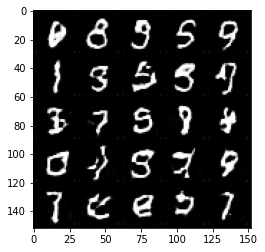

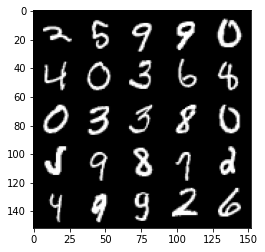

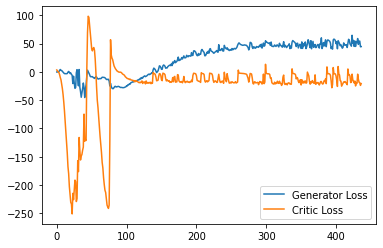

Step 8800: Generator loss: 50.832542457580566, critic loss: -17.942162942171095


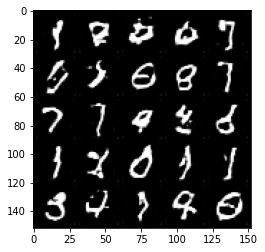

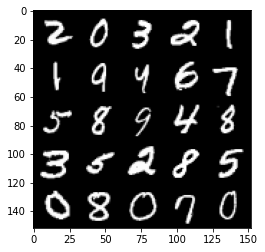

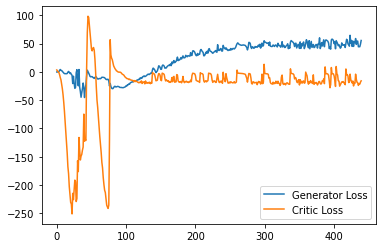

Step 8850: Generator loss: 48.390454330444335, critic loss: -13.721175682544711


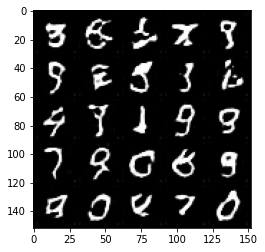

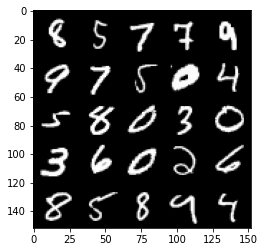

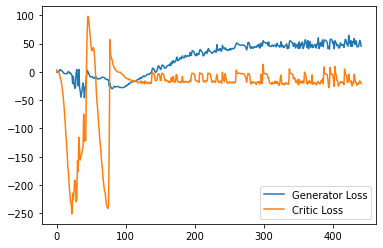

Step 8900: Generator loss: 59.490628509521486, critic loss: -3.224184590578079


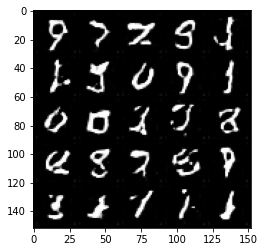

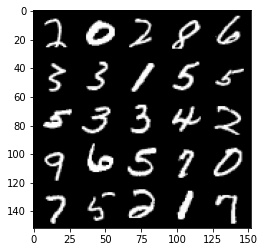

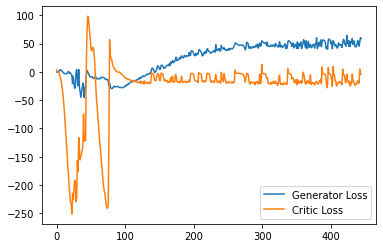

Step 8950: Generator loss: 51.92669227600098, critic loss: -15.231853225231175


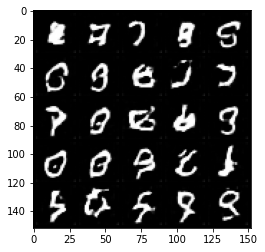

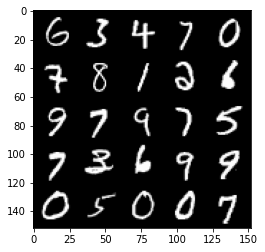

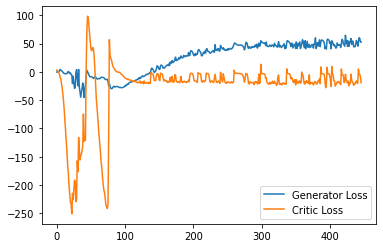

Step 9000: Generator loss: 49.488040084838865, critic loss: -20.384141352891923


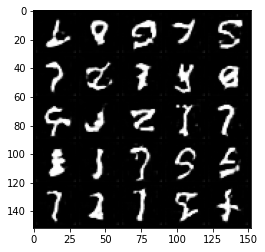

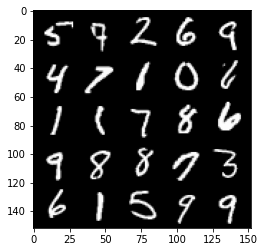

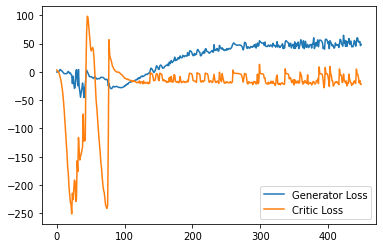

Step 9050: Generator loss: 51.22275127410889, critic loss: -18.9094960796833


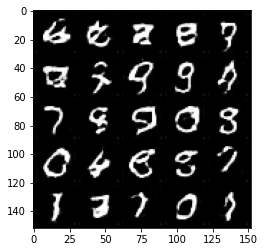

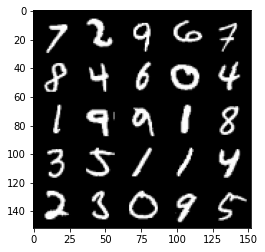

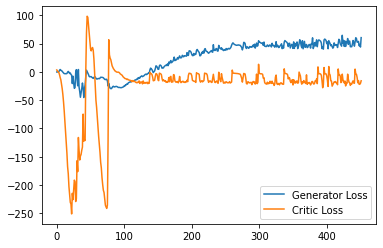

Step 9100: Generator loss: 53.61400524139404, critic loss: -12.125214631319047


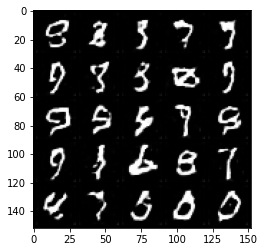

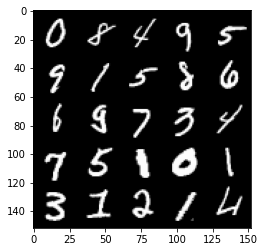

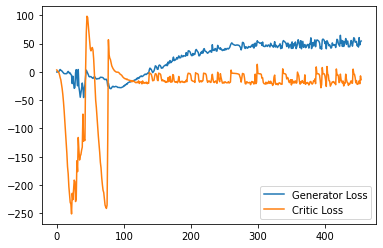

Step 9150: Generator loss: 54.75676937103272, critic loss: -15.815800728440287


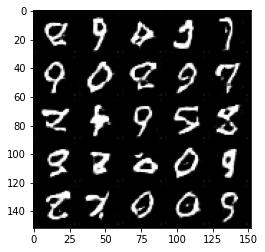

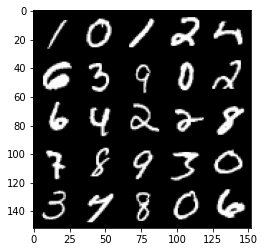

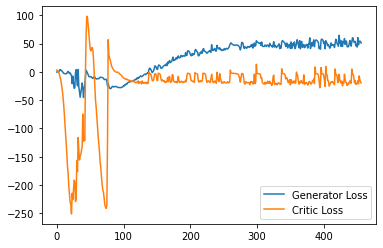

Step 9200: Generator loss: 51.95202091217041, critic loss: -18.979565445780754


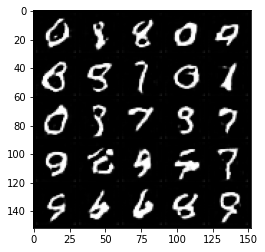

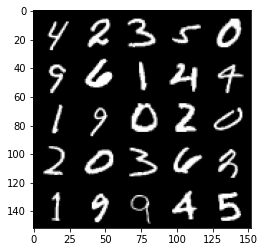

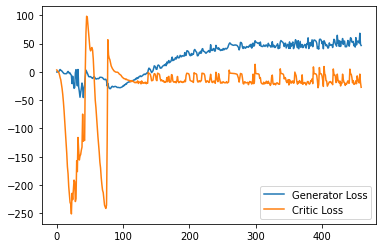

Step 9250: Generator loss: 53.534493865966795, critic loss: -21.846452103376386


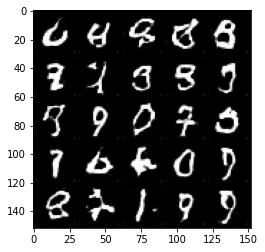

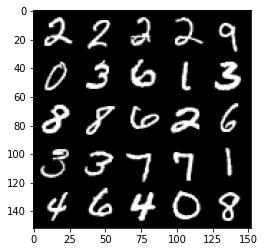

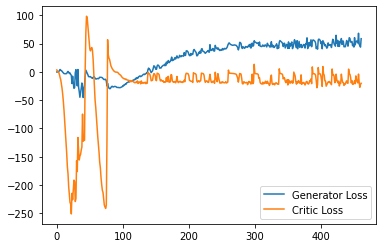

Step 9300: Generator loss: 49.634357872009275, critic loss: -12.451692119598384


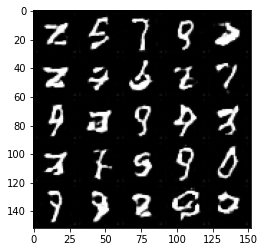

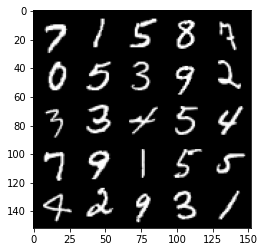

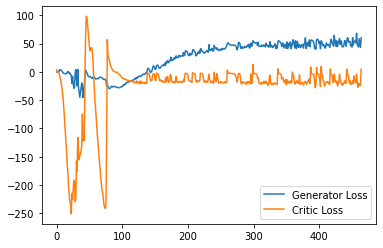

Step 9350: Generator loss: 54.45091274261475, critic loss: -13.44271796220541


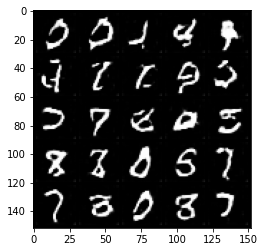

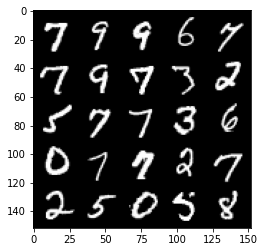

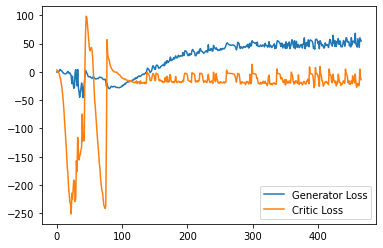

Step 9400: Generator loss: 53.89919334411621, critic loss: -17.42347975867987


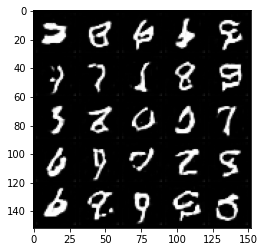

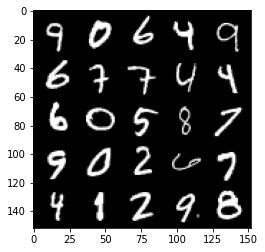

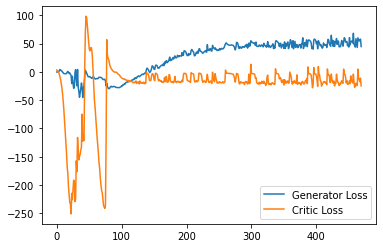

Step 9450: Generator loss: 60.66734687805176, critic loss: -14.923948676109312


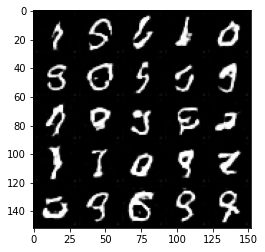

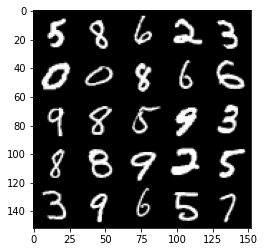

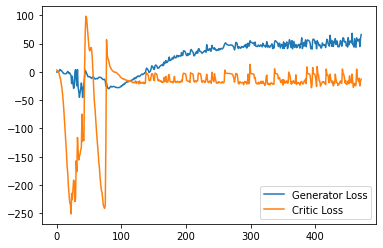

Step 9500: Generator loss: 55.02773139953613, critic loss: -16.31881471478939


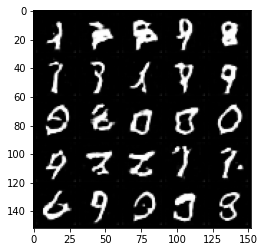

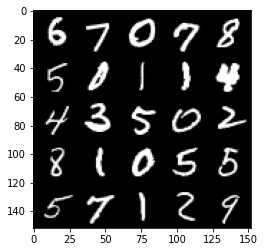

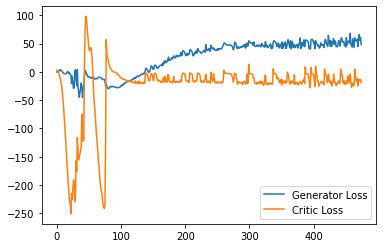

Step 9550: Generator loss: 47.42235145568848, critic loss: -22.36239796781539


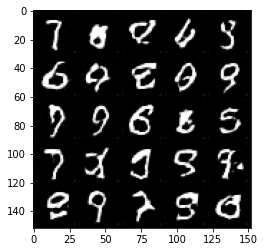

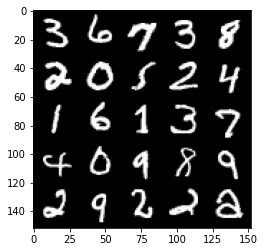

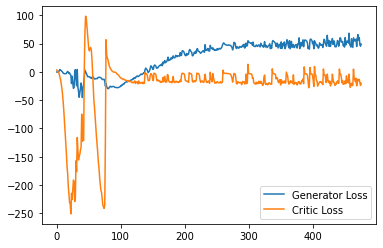

Step 9600: Generator loss: 51.97094833374023, critic loss: -19.846049779653548


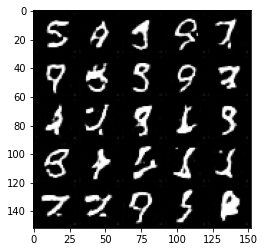

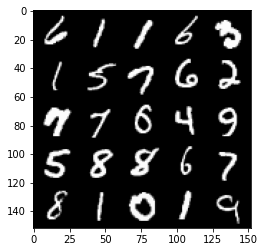

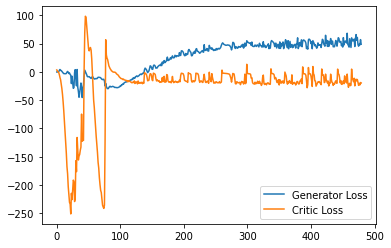

Step 9650: Generator loss: 59.87313575744629, critic loss: -17.107298739194874


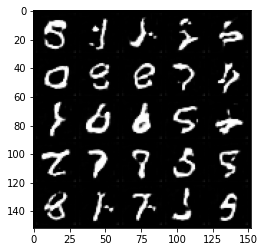

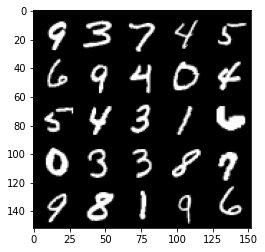

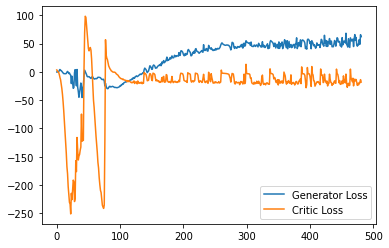

Step 9700: Generator loss: 60.484108200073244, critic loss: -9.459344610929486


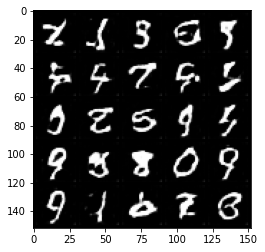

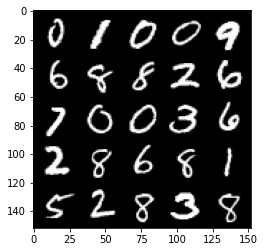

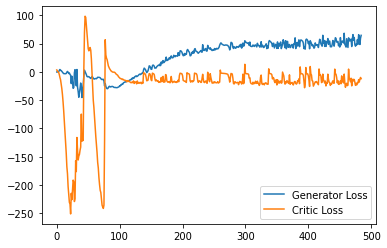

Step 9750: Generator loss: 53.43321319580078, critic loss: -19.328281954944135


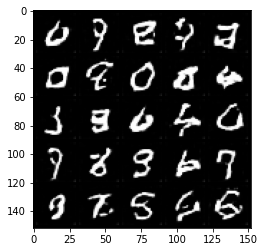

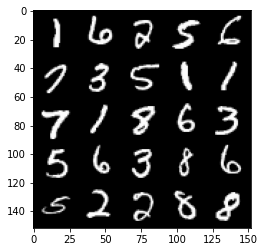

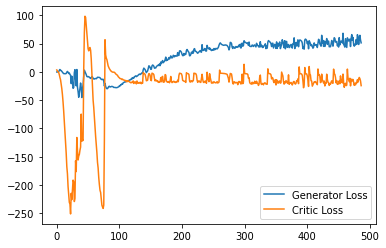

Step 9800: Generator loss: 59.713167686462405, critic loss: -17.62378216695786


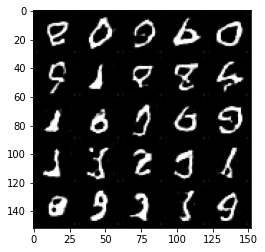

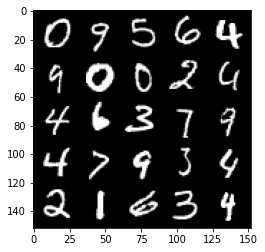

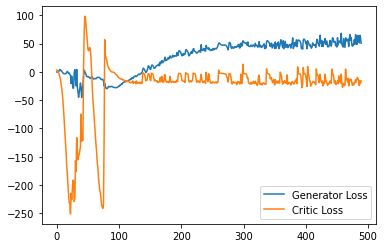

Step 9850: Generator loss: 60.2160139465332, critic loss: -10.745555574715137


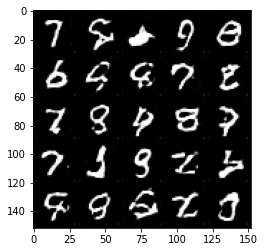

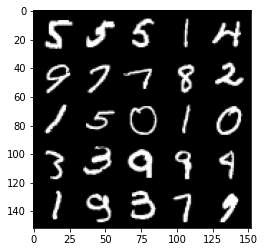

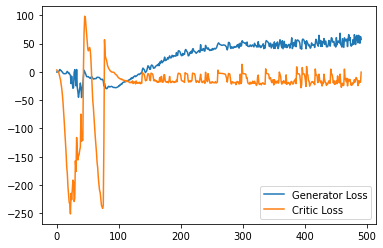

Step 9900: Generator loss: 59.684763259887696, critic loss: -18.842326496839515


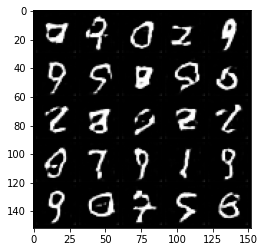

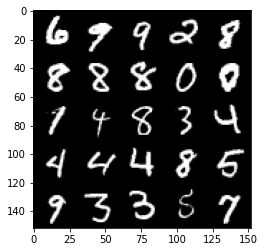

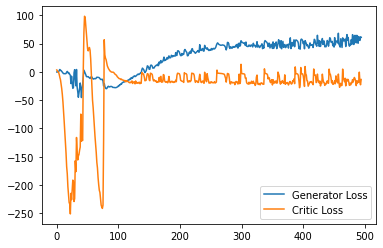

Step 9950: Generator loss: 60.415617599487305, critic loss: -17.354586730360985


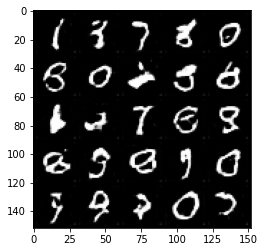

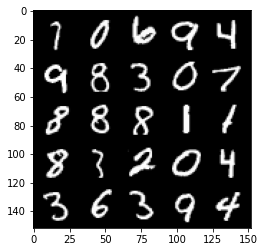

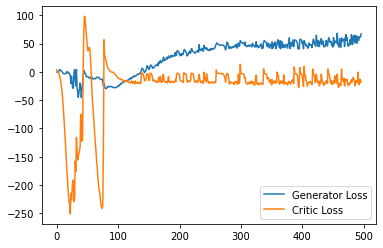

Step 10000: Generator loss: 63.813123321533205, critic loss: -16.677486736416817


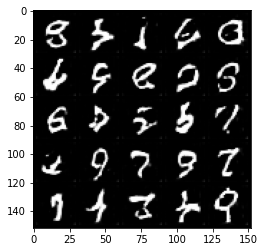

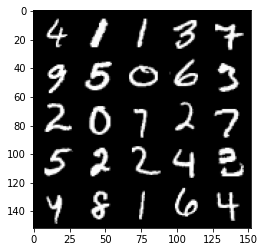

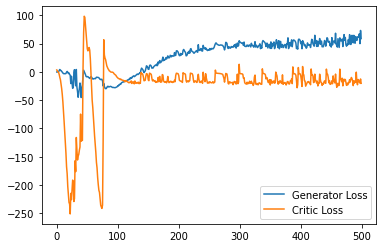

Step 10050: Generator loss: 60.66676570892334, critic loss: -15.974299760818488


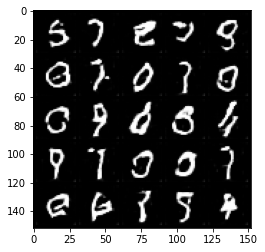

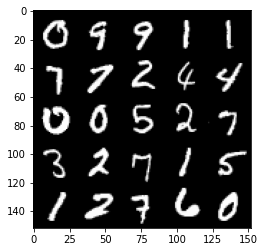

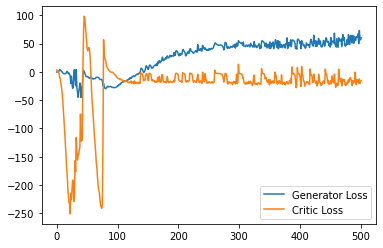

Step 10100: Generator loss: 66.46792190551758, critic loss: -12.925691307425495


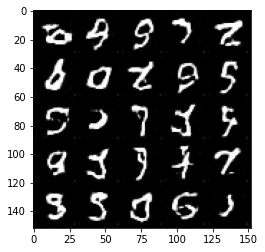

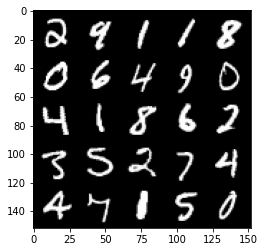

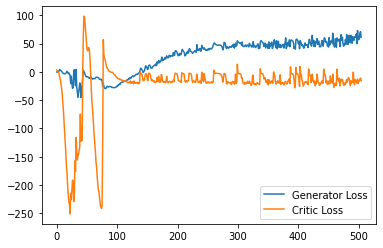

Step 10150: Generator loss: 58.44310447692871, critic loss: -20.183878284215933


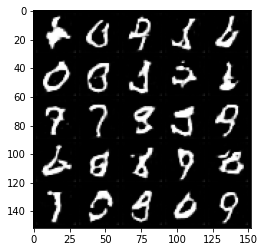

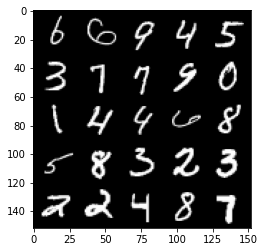

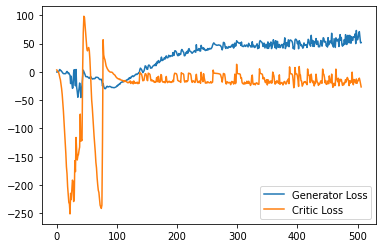

Step 10200: Generator loss: 60.41831527709961, critic loss: -16.532289041996002


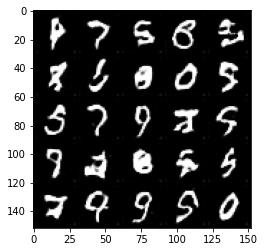

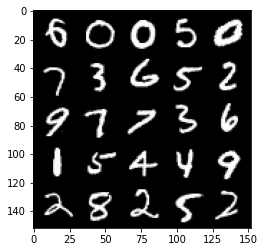

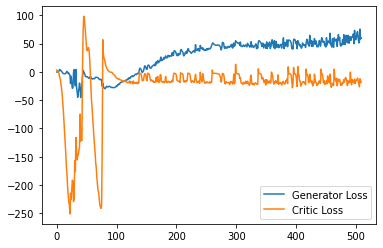

Step 10250: Generator loss: 64.29083465576171, critic loss: -12.894806473970418


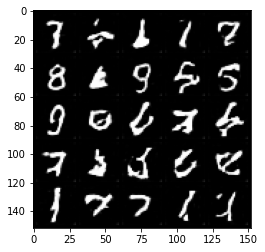

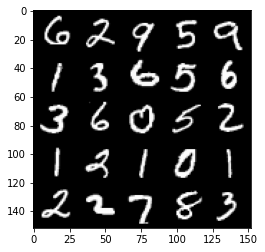

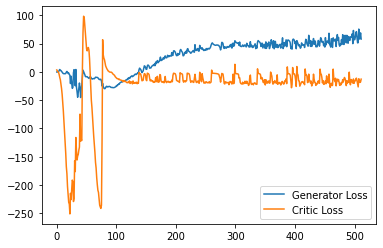

Step 10300: Generator loss: 66.51109130859375, critic loss: -7.990602605104445


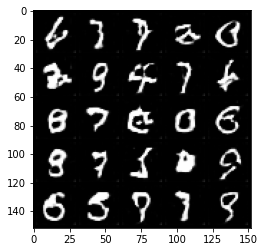

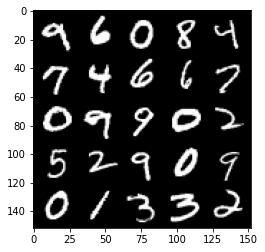

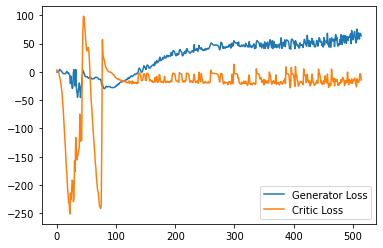

Step 10350: Generator loss: 59.94322738647461, critic loss: -0.6746669349074366


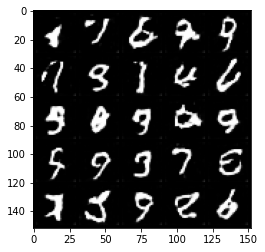

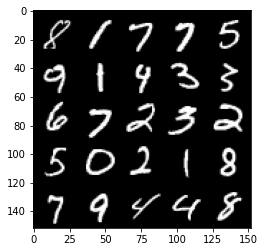

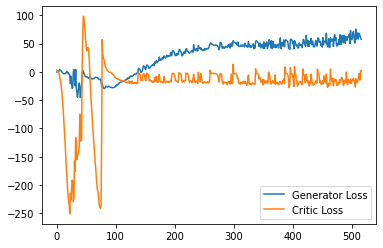

Step 10400: Generator loss: 65.39664085388183, critic loss: -14.493769343972206


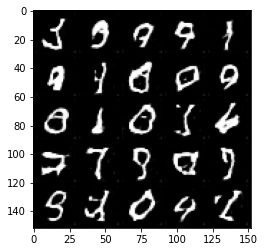

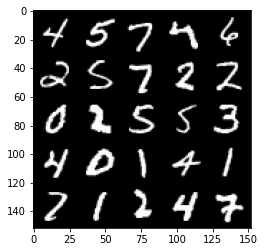

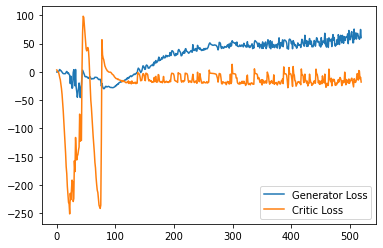

Step 10450: Generator loss: 59.85636772155762, critic loss: -14.801435924172406


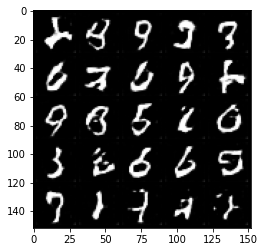

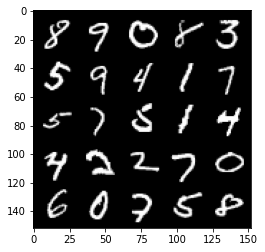

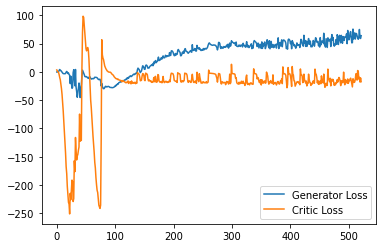

Step 10500: Generator loss: 53.13931121826172, critic loss: -23.388789644837384


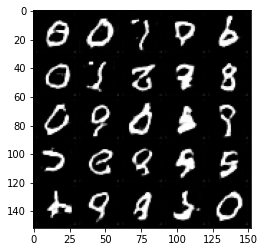

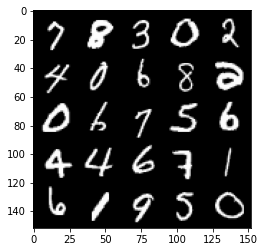

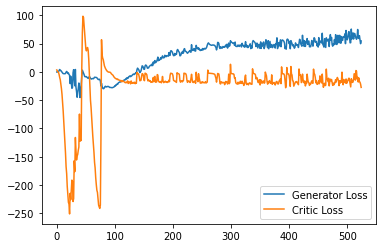

Step 10550: Generator loss: 59.783407096862796, critic loss: -17.34645663547516


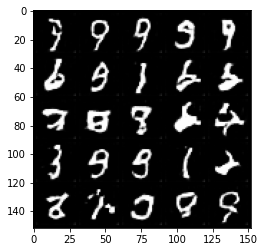

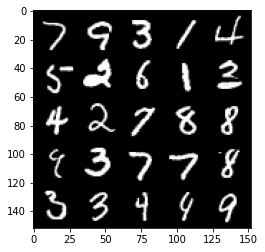

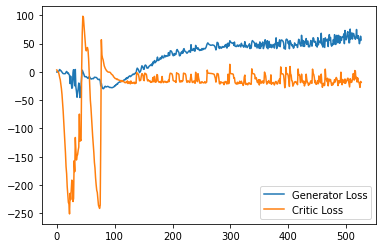

Step 10600: Generator loss: 69.5814542388916, critic loss: -14.576190729200837


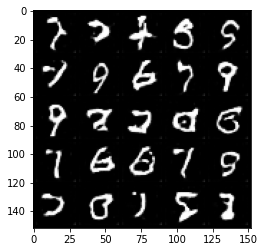

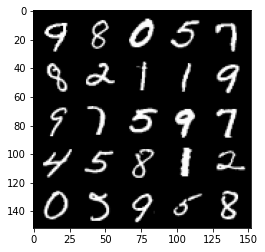

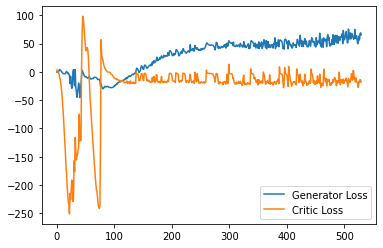

Step 10650: Generator loss: 64.06652221679687, critic loss: -15.267800597906117


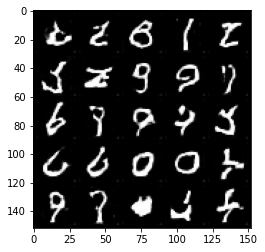

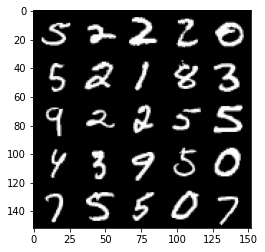

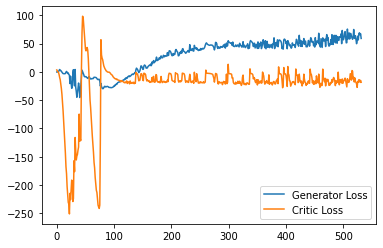

Step 10700: Generator loss: 59.892708930969235, critic loss: -18.79890429878235


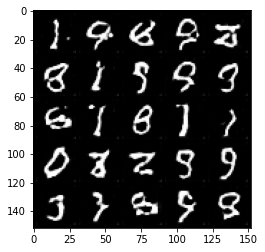

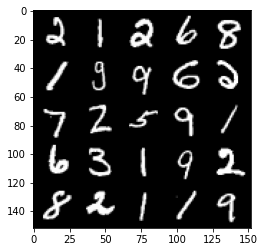

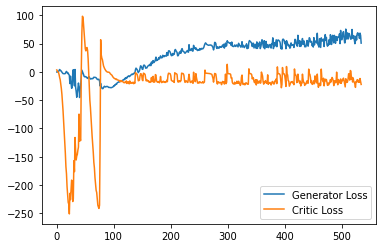

Step 10750: Generator loss: 64.04807289123535, critic loss: -17.29109403932094


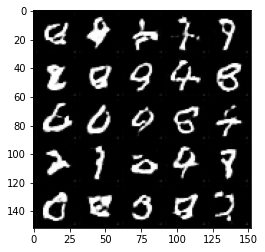

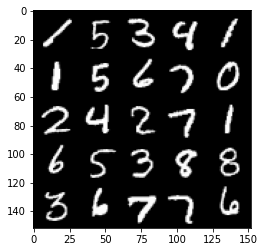

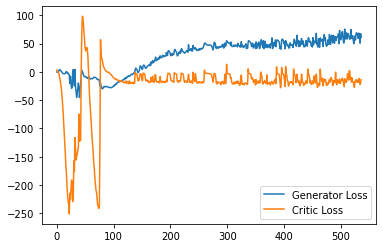

Step 10800: Generator loss: 61.725554656982425, critic loss: -14.731313282728195


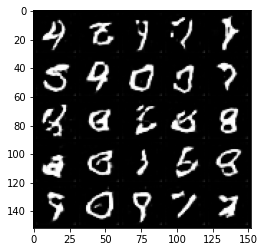

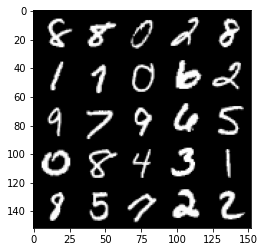

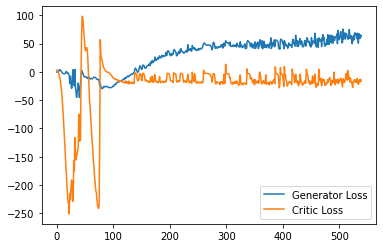

Step 10850: Generator loss: 61.457821655273435, critic loss: -20.004665041089062


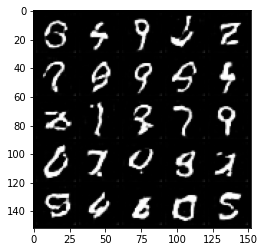

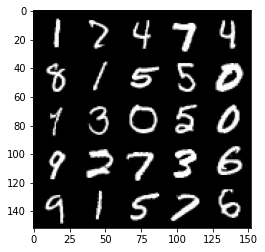

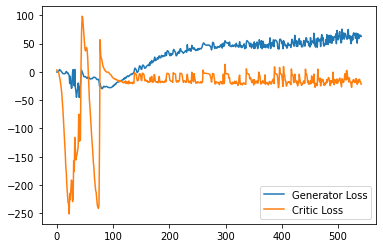

Step 10900: Generator loss: 64.85411014556885, critic loss: -6.907365369558335


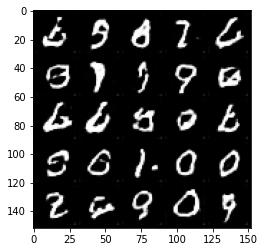

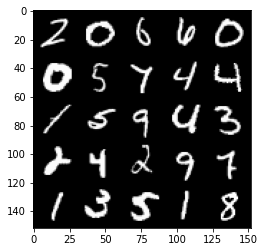

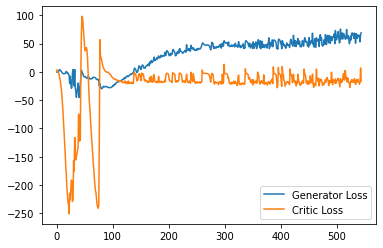

Step 10950: Generator loss: 68.43807243347167, critic loss: -19.277714592218402


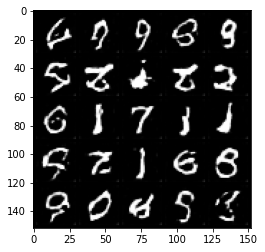

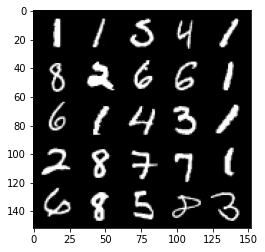

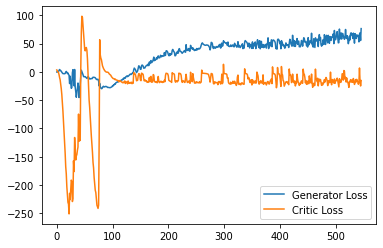

Step 11000: Generator loss: 63.85276611328125, critic loss: -17.06539833307266


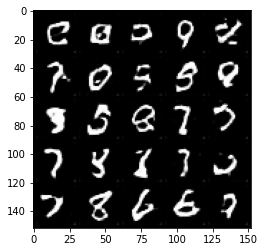

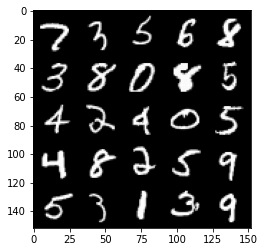

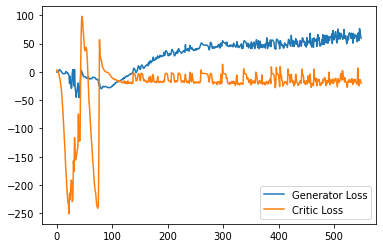

Step 11050: Generator loss: 65.47270805358886, critic loss: -15.36087499547005


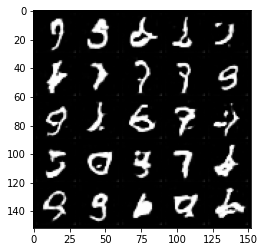

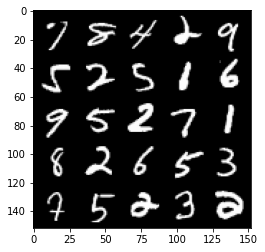

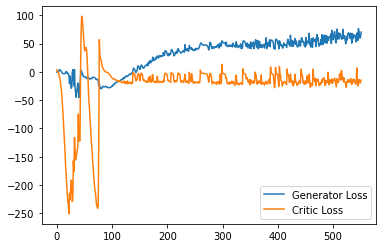

Step 11100: Generator loss: 68.92388786315918, critic loss: -16.89087193161249


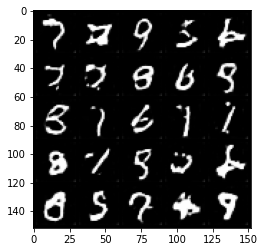

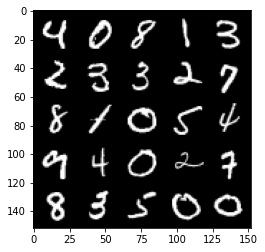

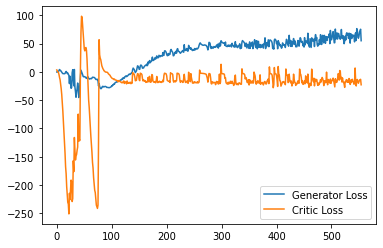

Step 11150: Generator loss: 62.16613998413086, critic loss: -18.30733120715618


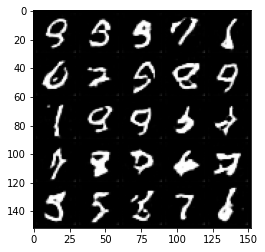

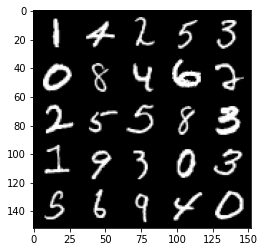

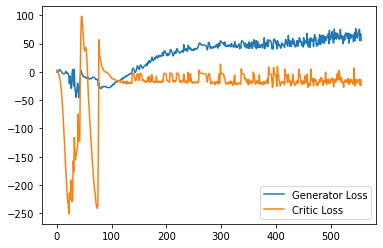

Step 11200: Generator loss: 71.22529571533204, critic loss: -16.369830652236935


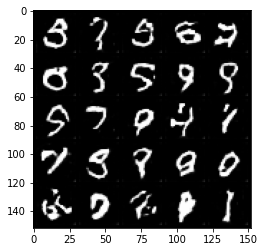

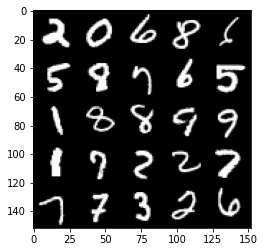

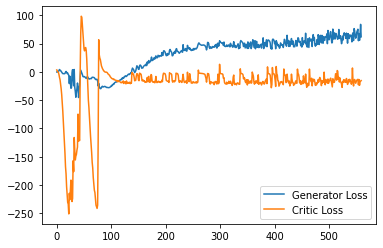

Step 11250: Generator loss: 62.941146545410156, critic loss: -20.26891474962235


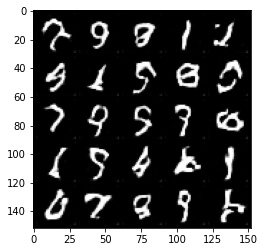

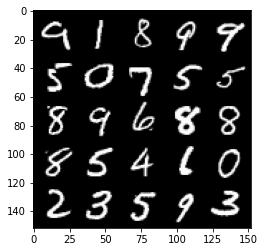

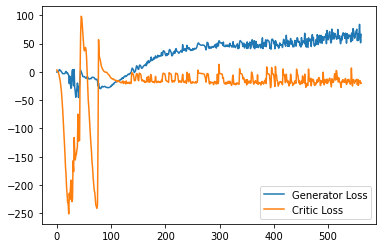

Step 11300: Generator loss: 66.29584518432617, critic loss: -17.895837832927704


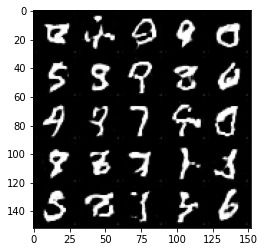

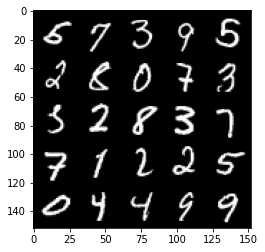

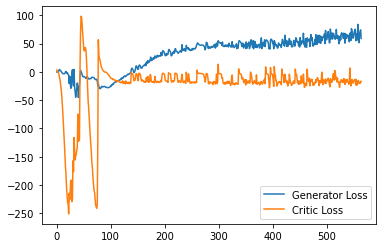

Step 11350: Generator loss: 54.908490295410154, critic loss: -20.865619998693468


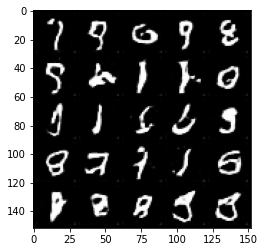

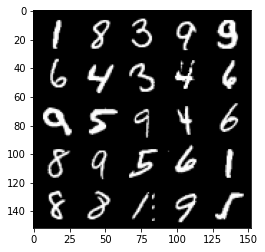

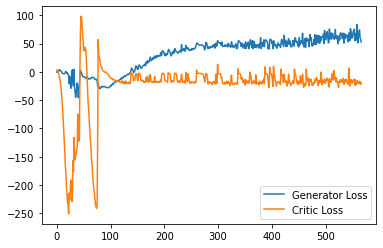

Step 11400: Generator loss: 71.96915565490723, critic loss: -14.50672043526173


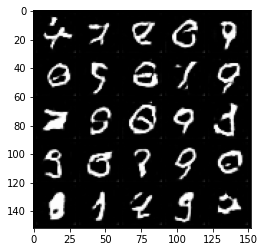

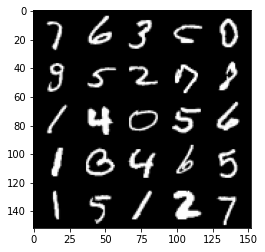

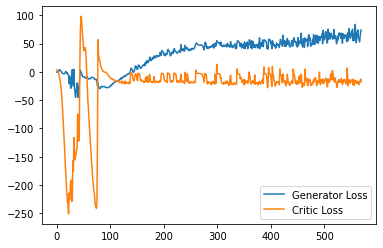

Step 11450: Generator loss: 62.21485954284668, critic loss: -18.44281755590439


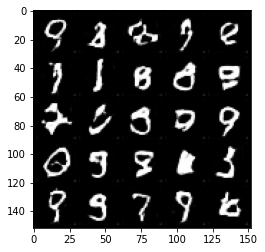

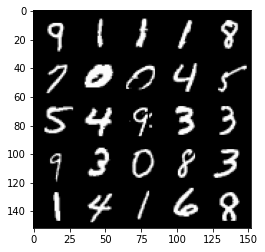

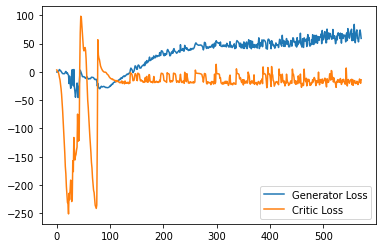

Step 11500: Generator loss: 68.8563111114502, critic loss: -13.836687740802768


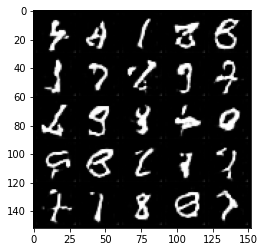

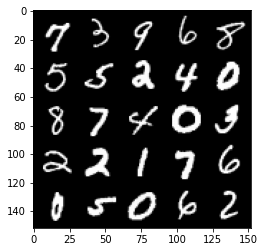

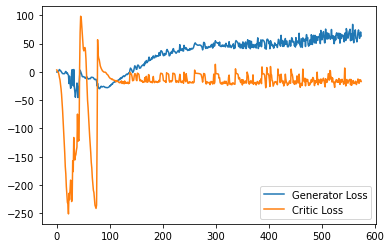

Step 11550: Generator loss: 65.07173907756805, critic loss: -10.016147301495073


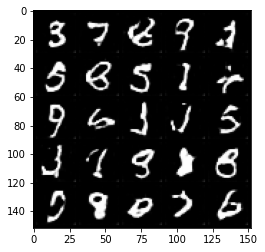

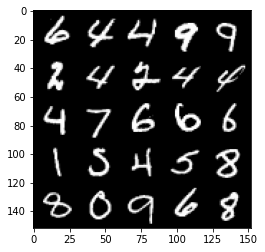

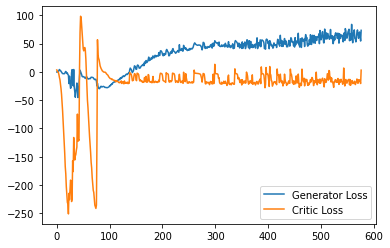

Step 11600: Generator loss: 67.01095008850098, critic loss: -18.149384275436404


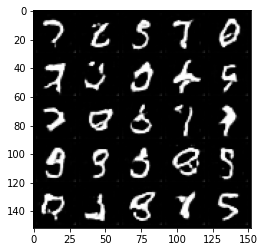

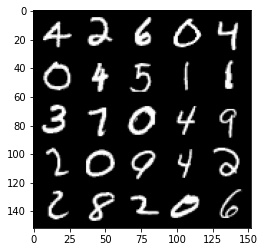

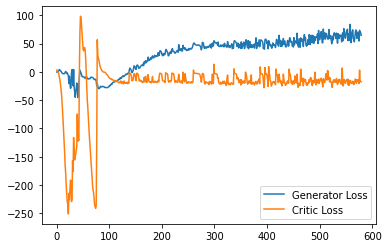

Step 11650: Generator loss: 62.058271484375, critic loss: -19.78116893339157


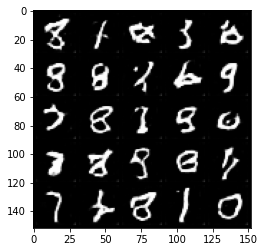

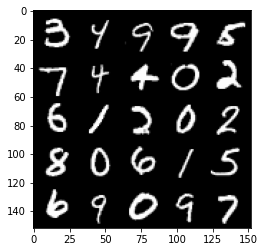

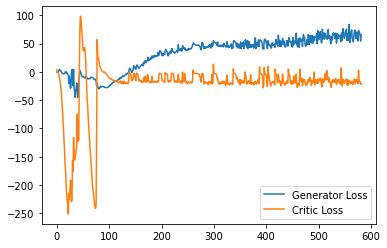

Step 11700: Generator loss: 64.305615234375, critic loss: -7.351794678926468


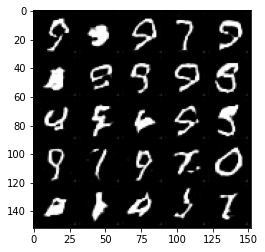

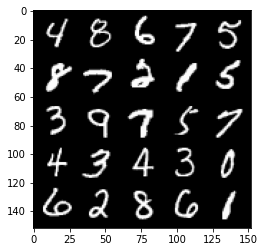

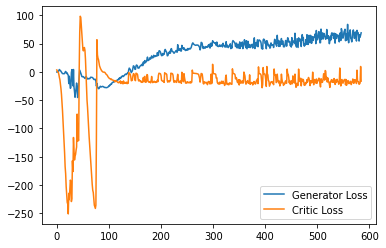

Step 11750: Generator loss: 69.4971672821045, critic loss: -16.63203572523594


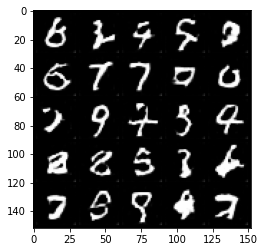

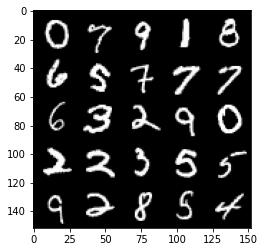

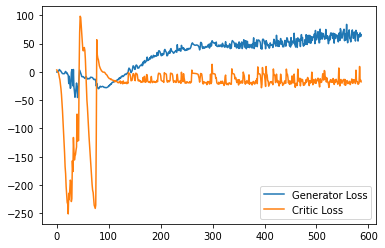

Step 11800: Generator loss: 64.30972366333008, critic loss: -19.45281629395485


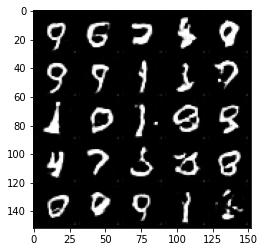

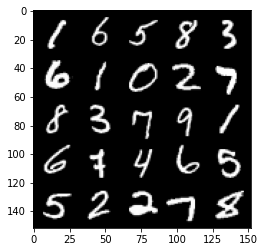

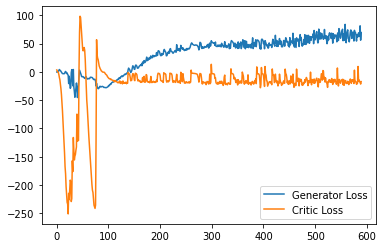

Step 11850: Generator loss: 64.93436134338378, critic loss: -15.362029607534403


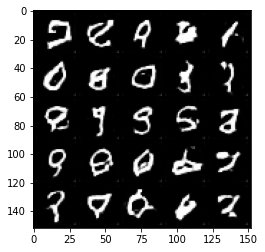

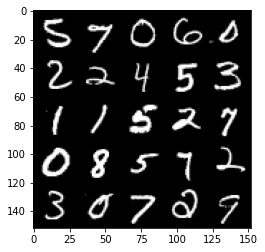

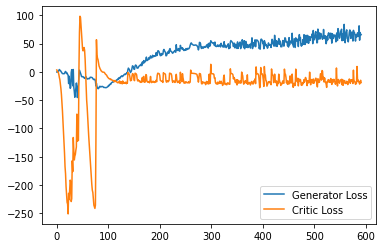

Step 11900: Generator loss: 71.43361221313477, critic loss: -15.68423770284653


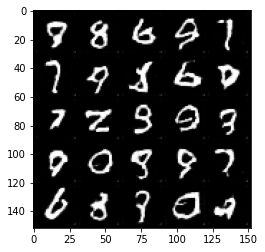

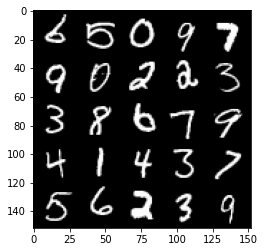

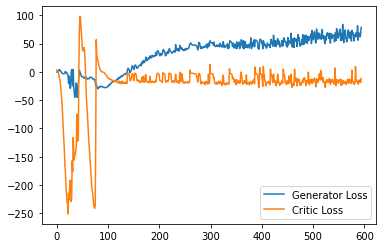

Step 11950: Generator loss: 71.58796222686767, critic loss: -18.726047154664993


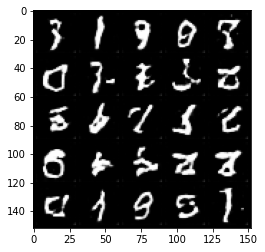

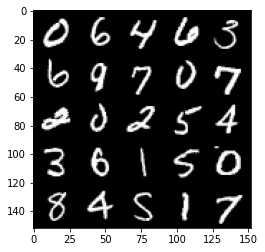

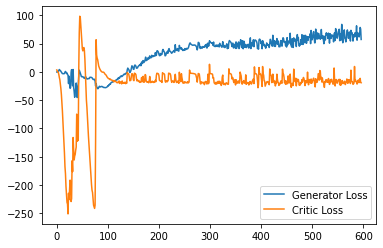

Step 12000: Generator loss: 62.86420120239258, critic loss: -17.866865797281264


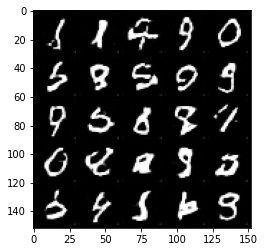

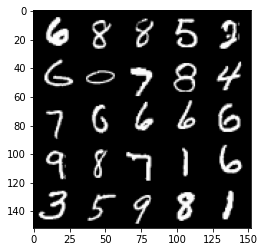

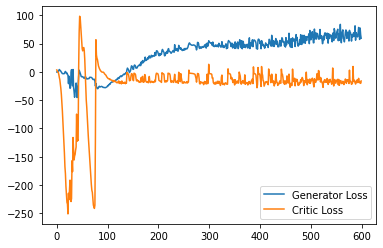

Step 12050: Generator loss: 60.24627113342285, critic loss: -24.184775152802466


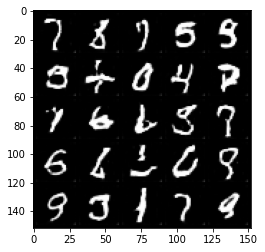

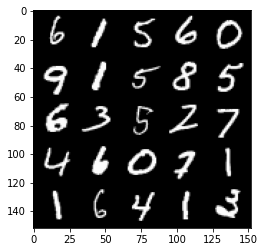

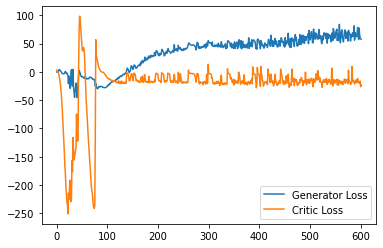

Step 12100: Generator loss: 72.37056060791015, critic loss: -19.51525575780869


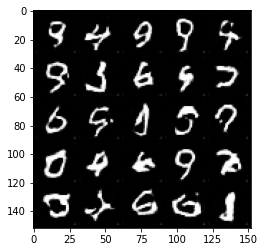

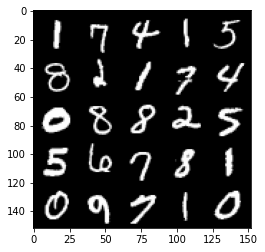

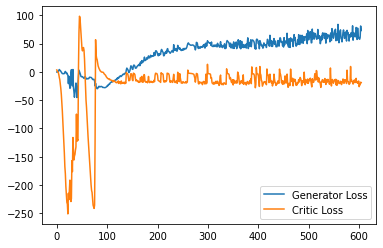

Step 12150: Generator loss: 70.39785873413086, critic loss: -17.14514438414574


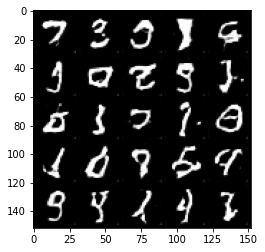

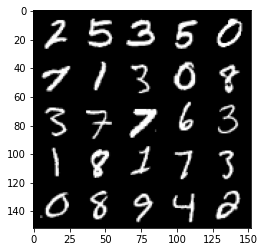

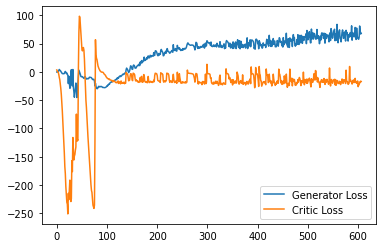

Step 12200: Generator loss: 67.29675903320313, critic loss: -20.96364463114739


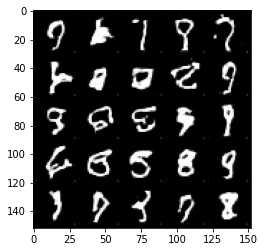

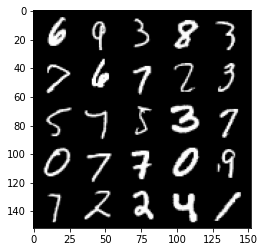

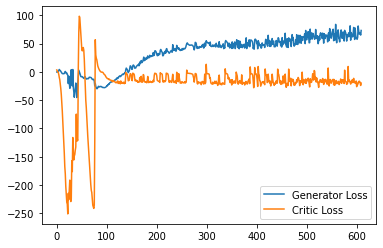

Step 12250: Generator loss: 60.220672607421875, critic loss: -28.574980401039127


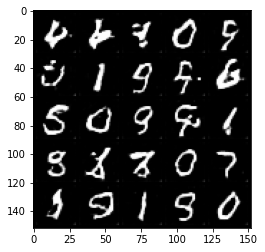

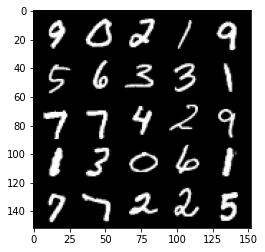

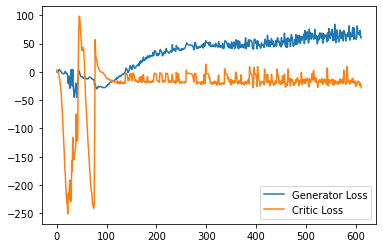

Step 12300: Generator loss: 78.10147605895996, critic loss: -17.443646599292755


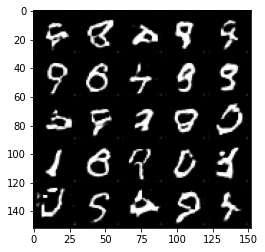

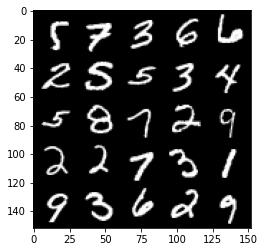

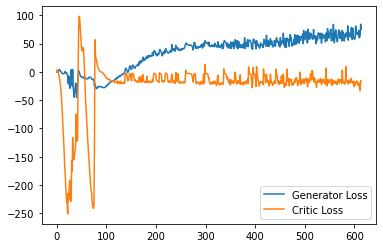

Step 12350: Generator loss: 69.29080101013183, critic loss: -17.936048422694206


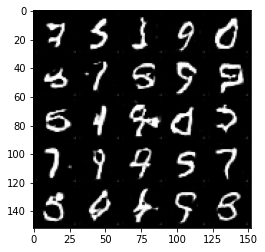

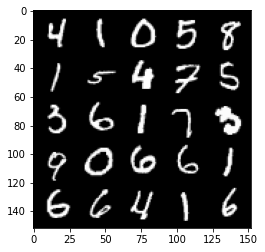

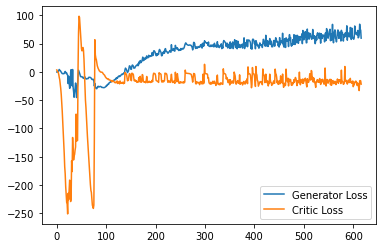

Step 12400: Generator loss: 68.33241199493408, critic loss: -14.63824718892574


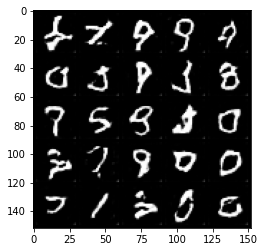

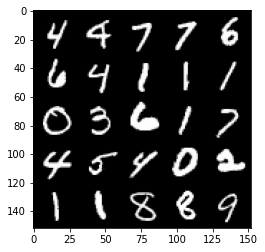

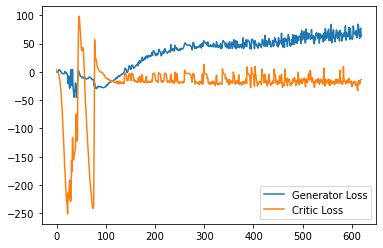

Step 12450: Generator loss: 70.19594871520997, critic loss: -12.280594190001489


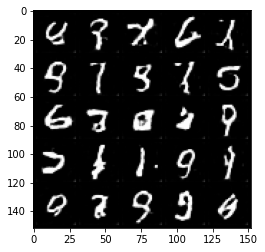

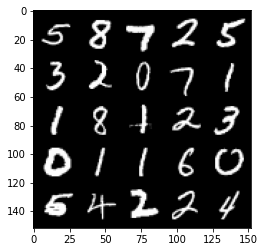

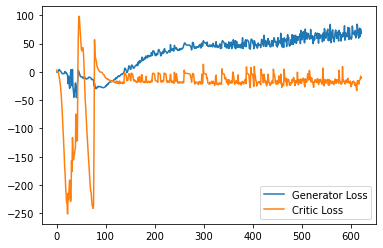

Step 12500: Generator loss: 70.93397094726562, critic loss: -21.857621863722805


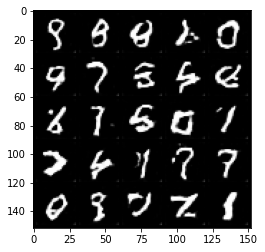

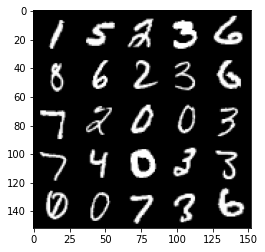

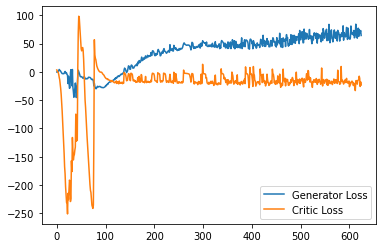

Step 12550: Generator loss: 69.1335998916626, critic loss: -22.477734286189083


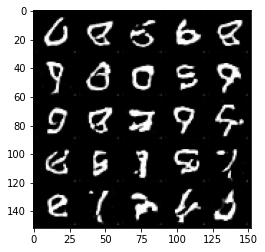

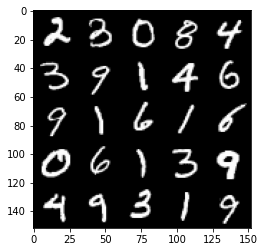

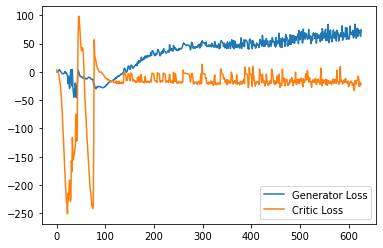

Step 12600: Generator loss: 69.85846420288085, critic loss: 2.2631050747633004


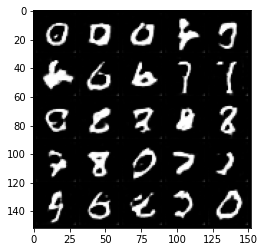

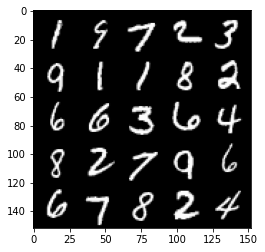

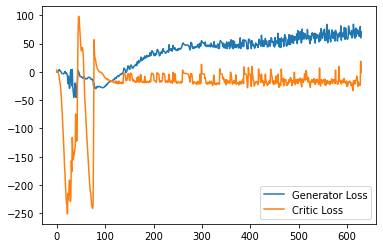

Step 12650: Generator loss: 72.5093862915039, critic loss: -3.072681758403778


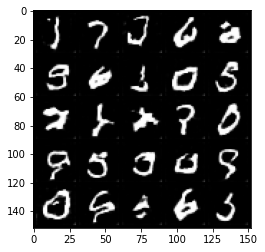

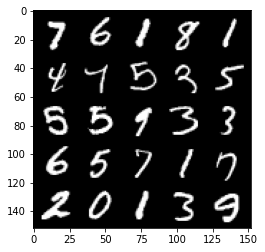

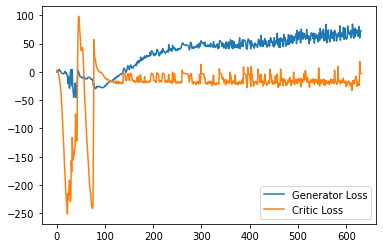

Step 12700: Generator loss: 71.64018142700195, critic loss: -3.540059703350067


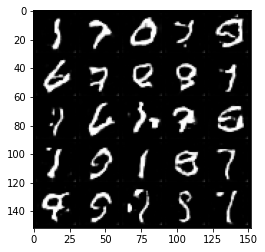

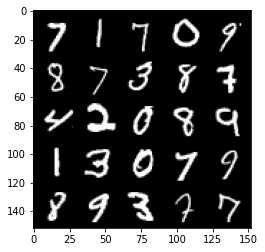

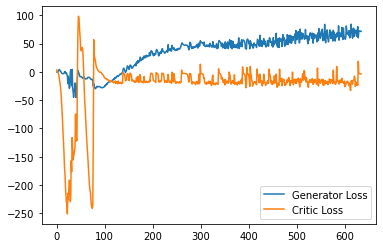

Step 12750: Generator loss: 70.00495254516602, critic loss: -5.345640728950501


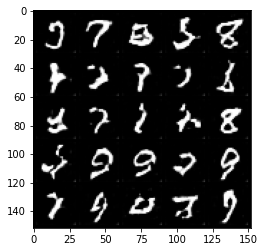

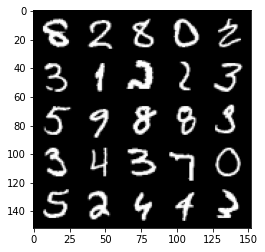

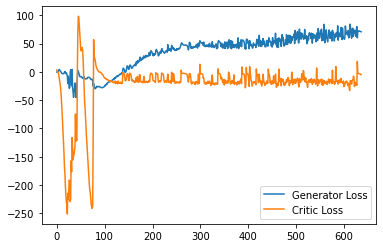

Step 12800: Generator loss: 63.23377723693848, critic loss: -18.38086348354816


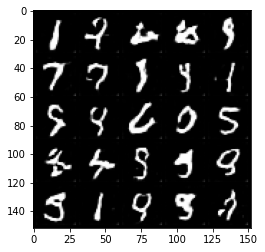

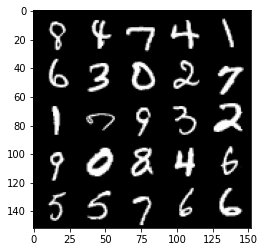

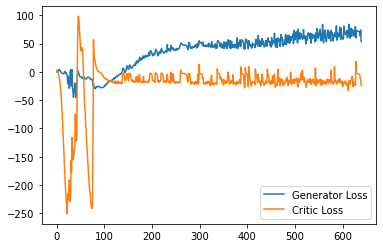

Step 12850: Generator loss: 67.00307159423828, critic loss: -25.858819763660428


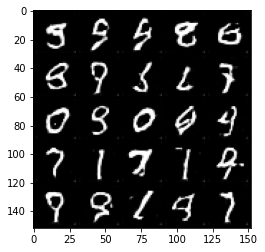

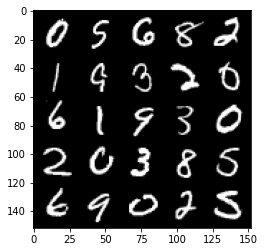

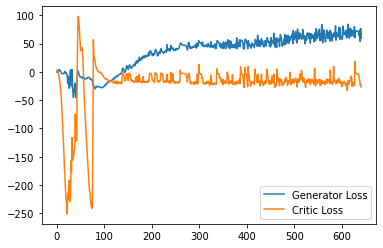

Step 12900: Generator loss: 80.42420143127441, critic loss: -18.679917960405348


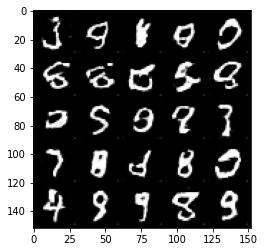

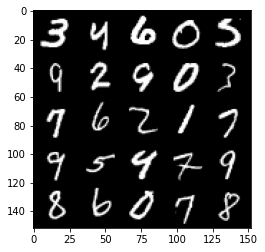

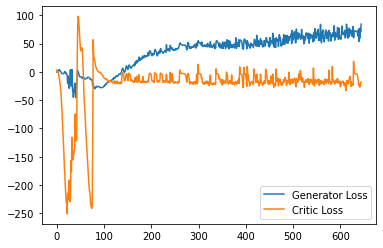

Step 12950: Generator loss: 74.1042855834961, critic loss: -16.886785314321518


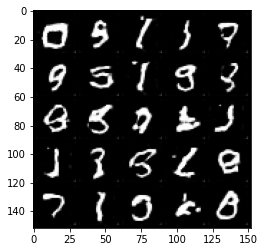

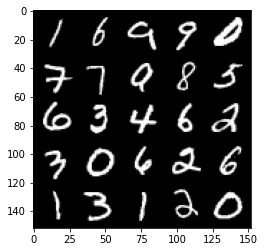

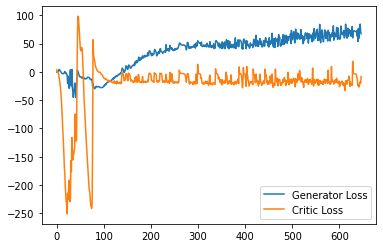

Step 13000: Generator loss: 75.2023014831543, critic loss: -19.717501844644552


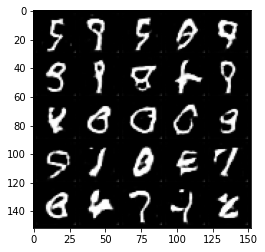

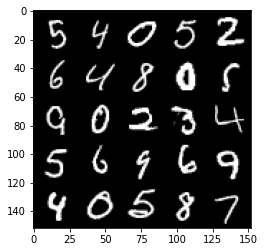

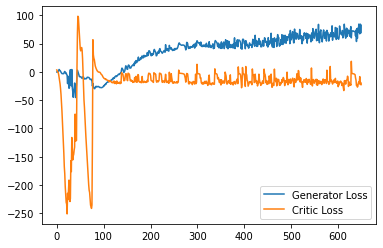

Step 13050: Generator loss: 69.53312446594238, critic loss: -15.053017581462864


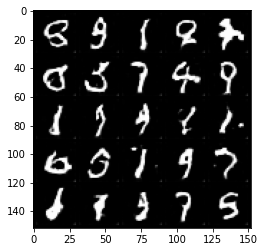

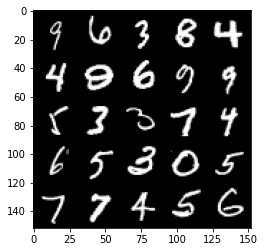

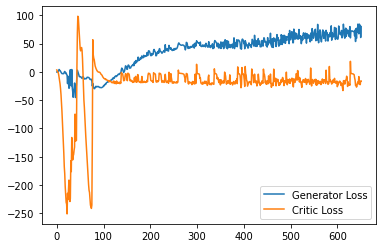

Step 13100: Generator loss: 72.05175239562988, critic loss: -16.293512452721597


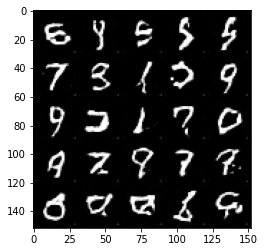

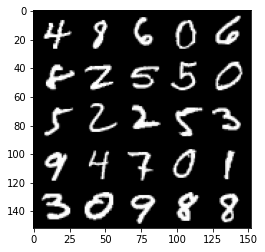

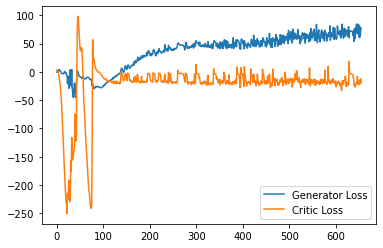

Step 13150: Generator loss: 69.37846160888672, critic loss: -12.443573958873742


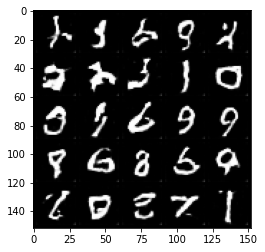

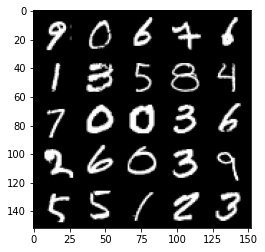

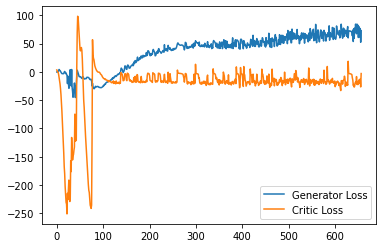

Step 13200: Generator loss: 73.80337371826172, critic loss: -18.290467549204827


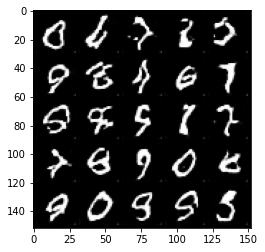

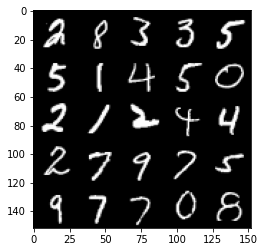

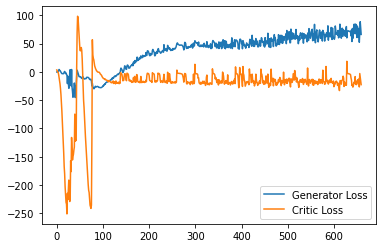

Step 13250: Generator loss: 72.51677108764649, critic loss: -20.711878521323207


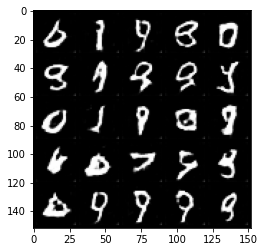

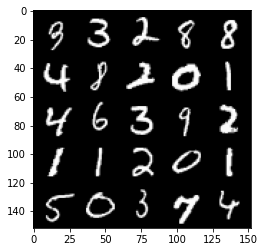

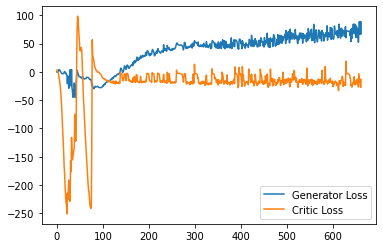

Step 13300: Generator loss: 73.27366043090821, critic loss: -18.179467192649835


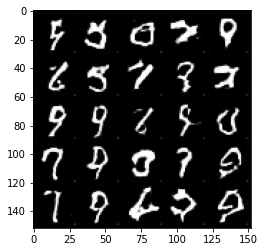

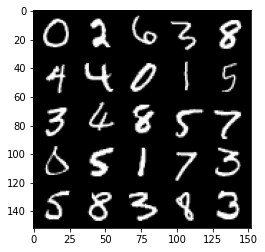

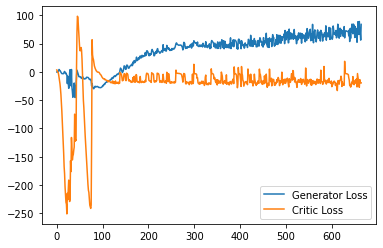

Step 13350: Generator loss: 76.8129815673828, critic loss: -19.982457286238667


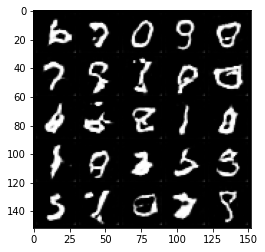

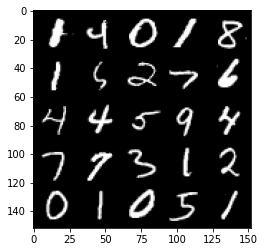

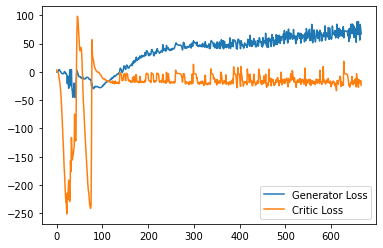

Step 13400: Generator loss: 69.29781967163086, critic loss: -18.608069278121004


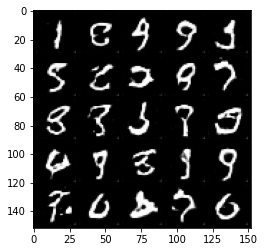

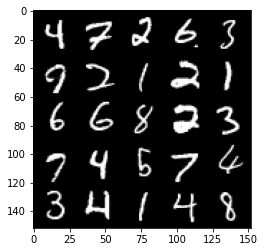

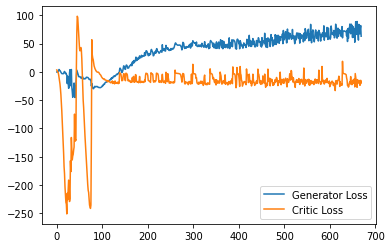

Step 13450: Generator loss: 71.21673522949219, critic loss: -20.203067180752754


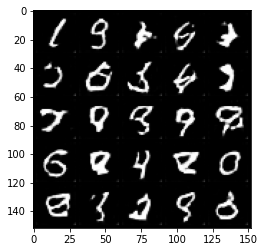

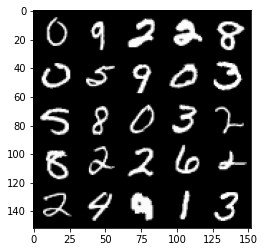

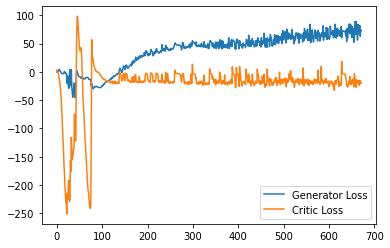

Step 13500: Generator loss: 76.6132438659668, critic loss: -19.73703630793095


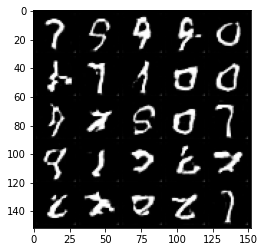

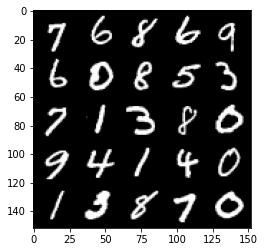

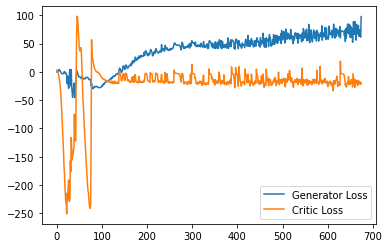

Step 13550: Generator loss: 67.04447296142578, critic loss: -19.299900711417198


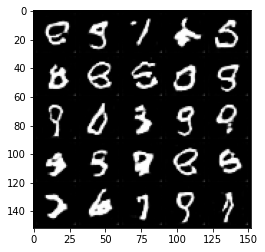

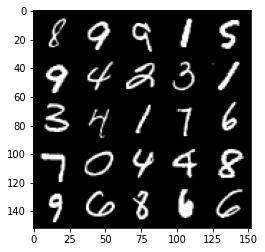

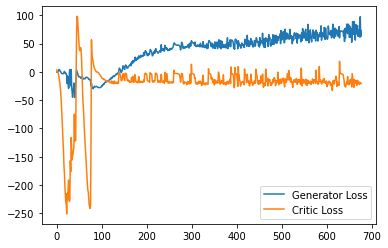

Step 13600: Generator loss: 75.16822021484376, critic loss: -19.71861509370804


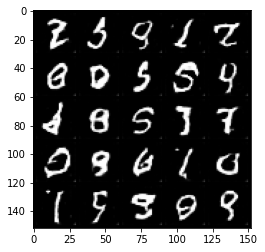

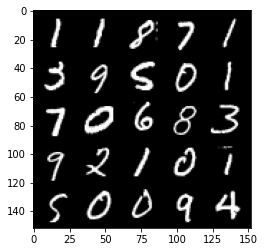

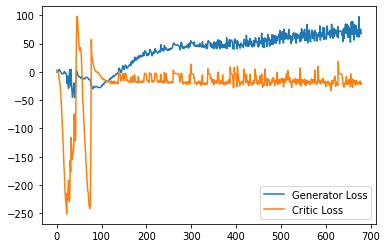

Step 13650: Generator loss: 75.43976127624512, critic loss: -20.006301064610483


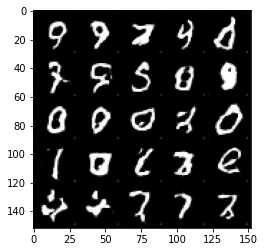

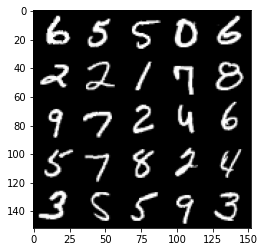

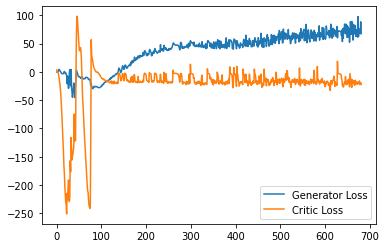

Step 13700: Generator loss: 76.10441596984863, critic loss: -17.478593536615367


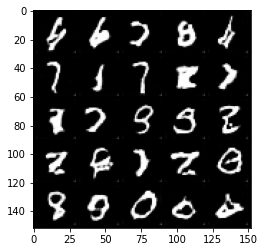

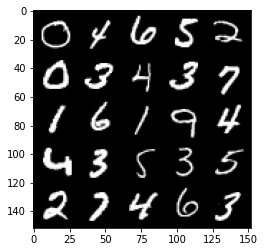

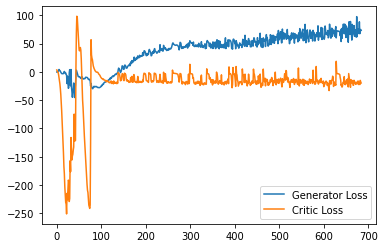

Step 13750: Generator loss: 79.37849723815918, critic loss: -16.239738120555874


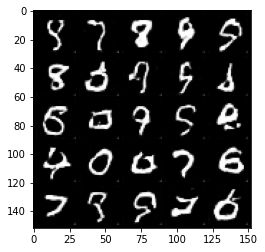

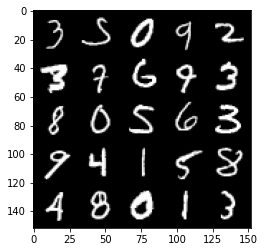

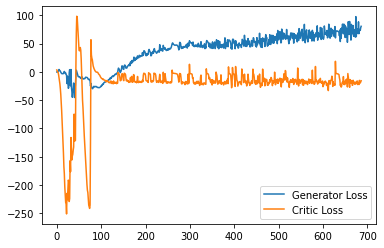

Step 13800: Generator loss: 72.09082687377929, critic loss: 1.1511552427411098


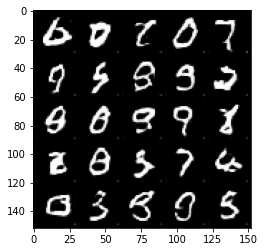

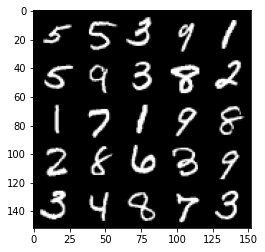

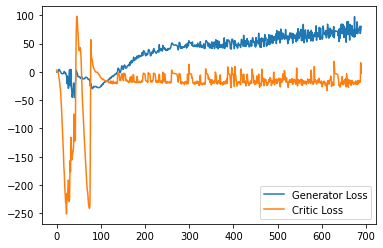

Step 13850: Generator loss: 79.50794876098632, critic loss: -3.4066472053527845


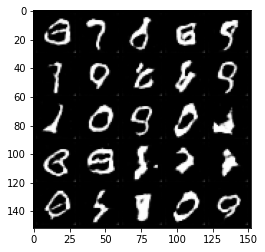

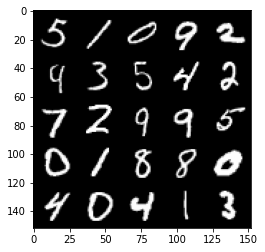

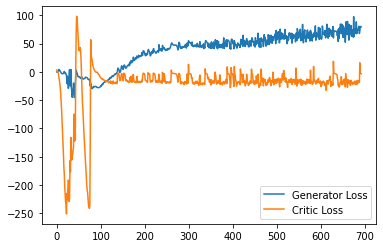

Step 13900: Generator loss: 75.30630493164062, critic loss: -9.97371713221073


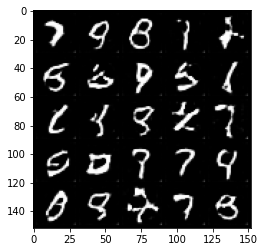

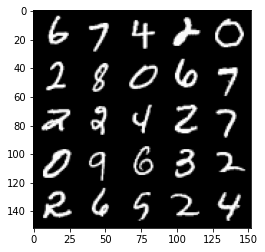

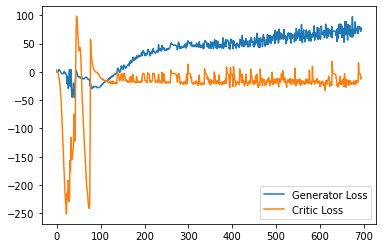

Step 13950: Generator loss: 69.40282218933106, critic loss: -22.243361459434038


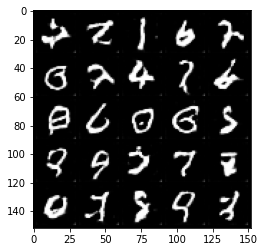

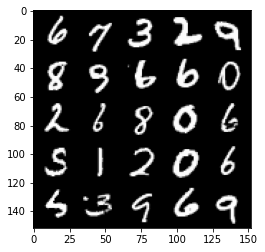

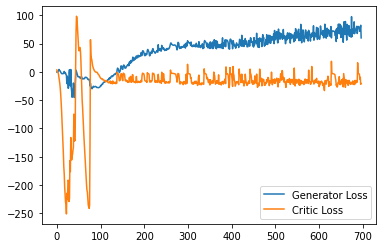

Step 14000: Generator loss: 83.12456680297852, critic loss: -10.924158812344073


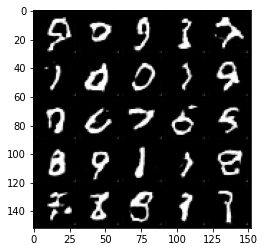

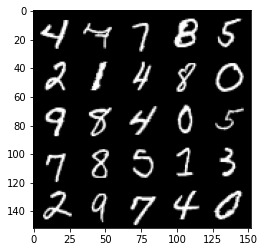

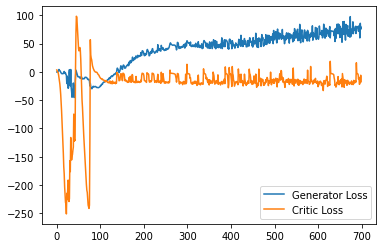

Step 14050: Generator loss: 74.56370323181153, critic loss: -17.566198444068434


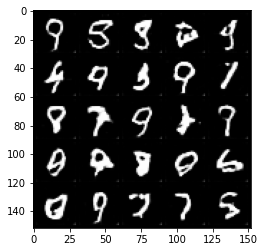

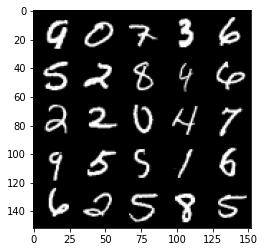

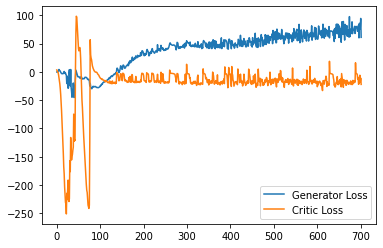

Step 14100: Generator loss: 77.84749687194824, critic loss: -15.788742958068847


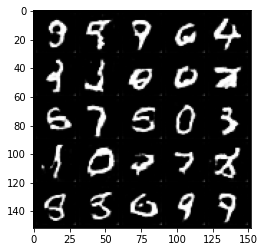

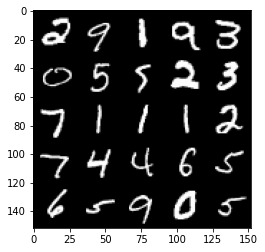

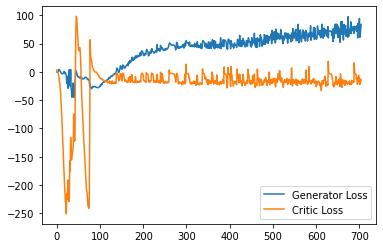

Step 14150: Generator loss: 69.22609664916992, critic loss: -18.837346023440364


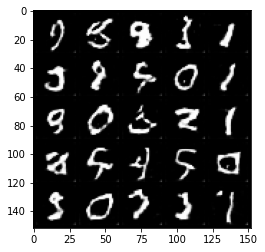

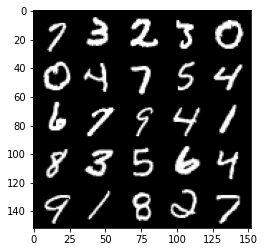

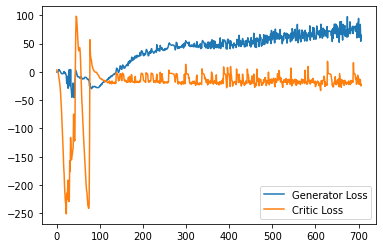

Step 14200: Generator loss: 78.49889938354492, critic loss: -18.82439122343063


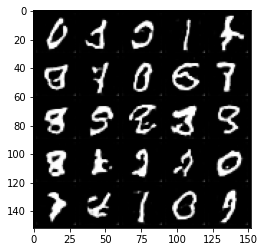

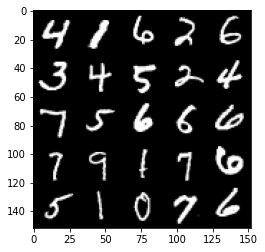

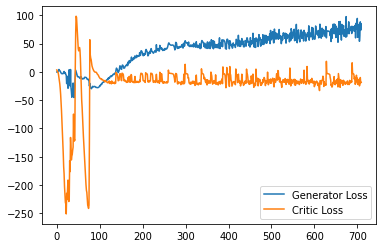

Step 14250: Generator loss: 85.03257682800293, critic loss: -12.294962515413761


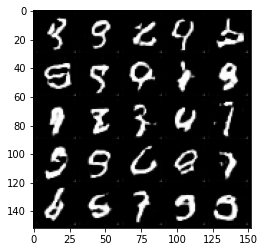

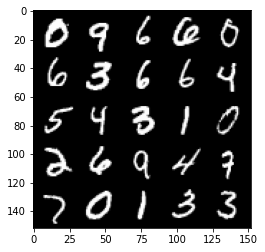

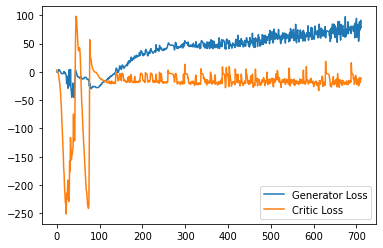

Step 14300: Generator loss: 81.10529479980468, critic loss: -8.07490528601408


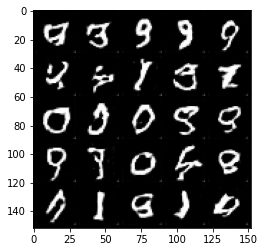

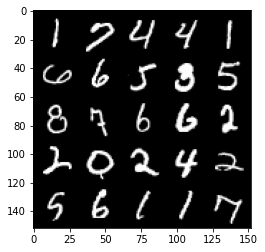

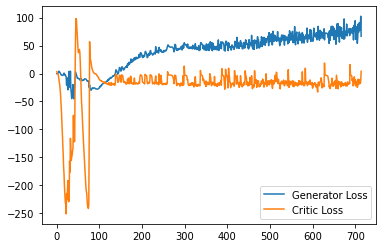

Step 14350: Generator loss: 73.24736785888672, critic loss: -24.81400380522012


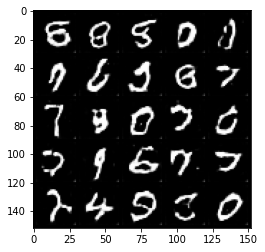

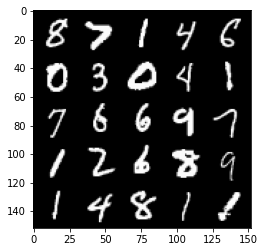

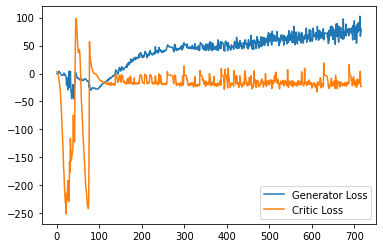

Step 14400: Generator loss: 75.01506515502929, critic loss: -17.699187865018843


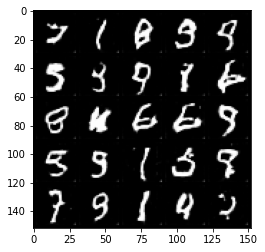

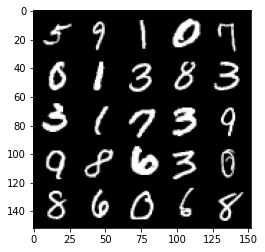

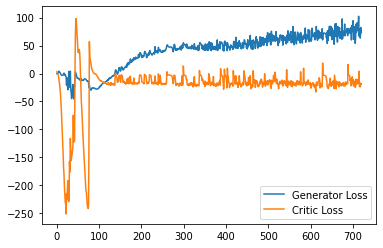

Step 14450: Generator loss: 77.22323364257812, critic loss: -17.922189044713967


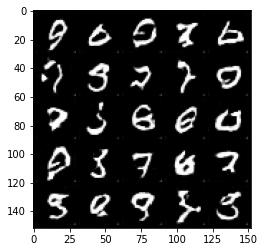

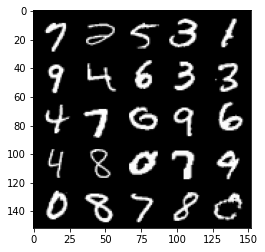

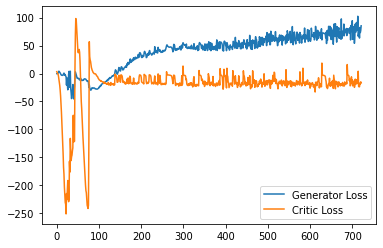

Step 14500: Generator loss: 74.93479202270508, critic loss: -17.6135449256897


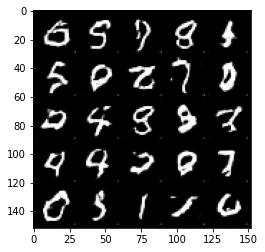

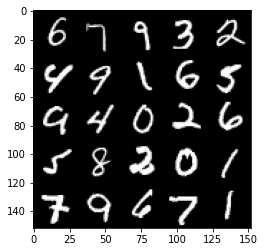

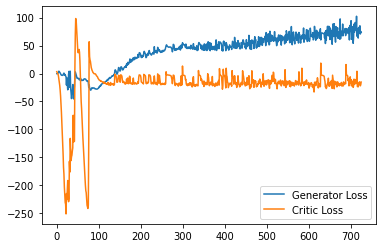

Step 14550: Generator loss: 82.17751495361328, critic loss: -19.980096817374225


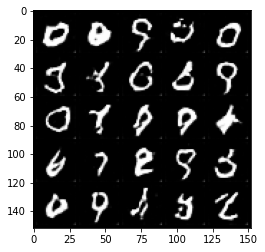

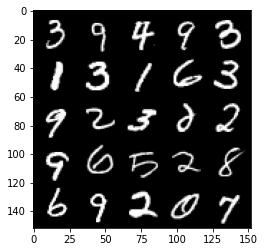

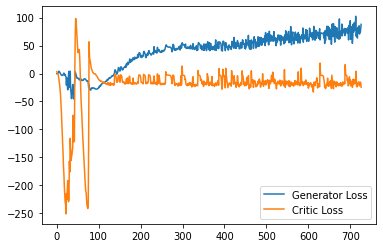

Step 14600: Generator loss: 67.34502052307128, critic loss: -18.915008774876597


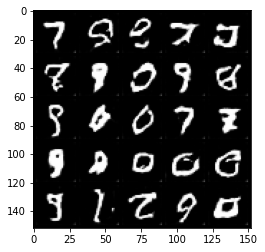

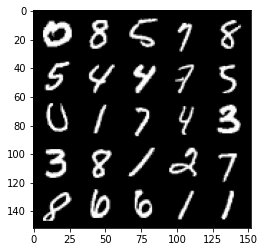

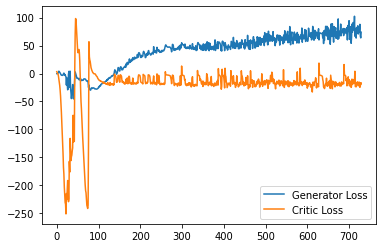

Step 14650: Generator loss: 68.4998471069336, critic loss: -5.142412030816081


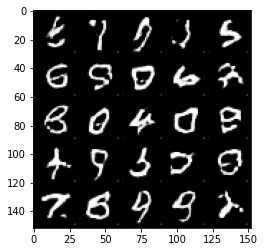

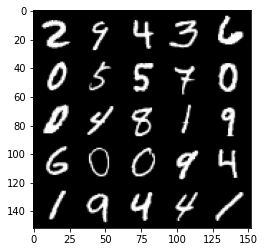

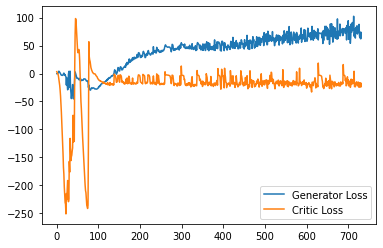

Step 14700: Generator loss: 79.75904586791992, critic loss: -2.3049726209640498


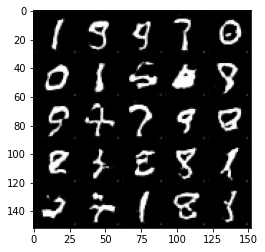

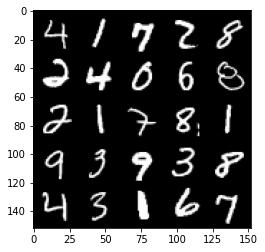

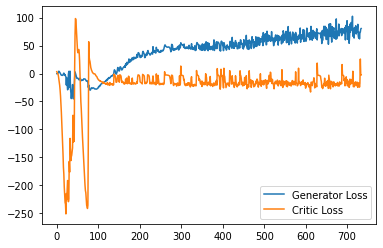

Step 14750: Generator loss: 79.85035034179687, critic loss: -2.7361741743087764


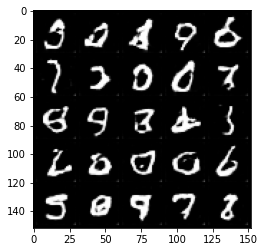

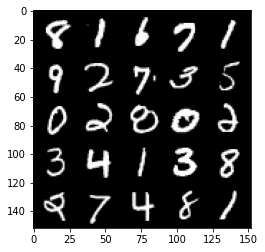

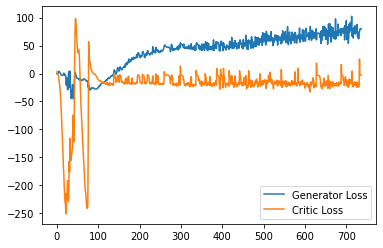

Step 14800: Generator loss: 76.37220153808593, critic loss: -4.00150032711029


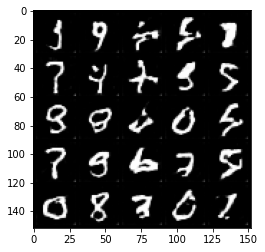

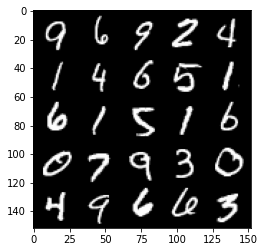

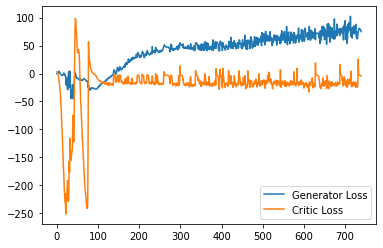

Step 14850: Generator loss: 77.1411693572998, critic loss: -11.013819010853767


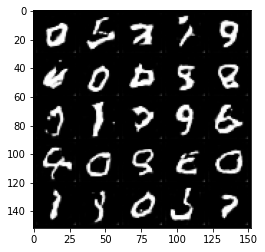

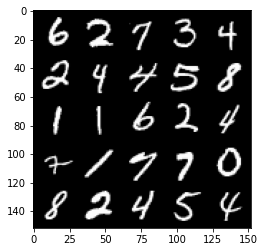

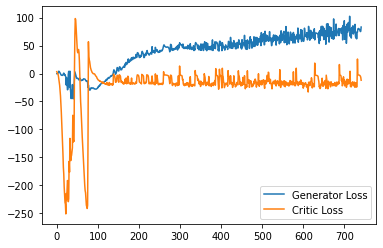

Step 14900: Generator loss: 73.86537292480469, critic loss: -18.30537081110478


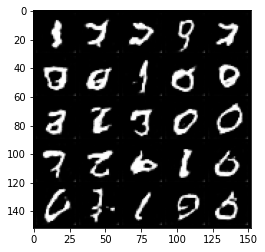

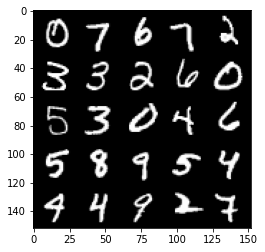

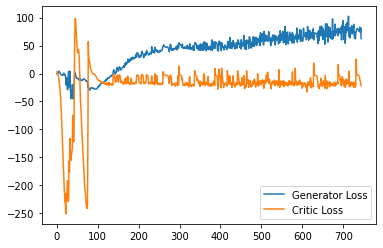

Step 14950: Generator loss: 76.57414085388183, critic loss: -15.547172967910772


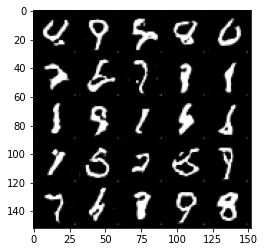

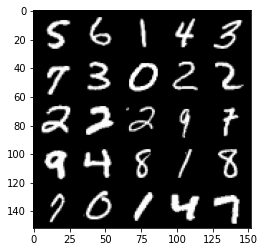

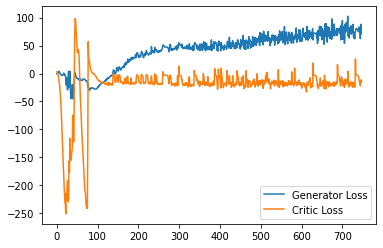

Step 15000: Generator loss: 84.2990087890625, critic loss: -22.465308450698856


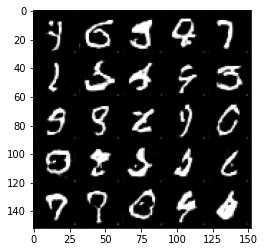

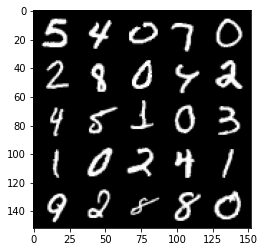

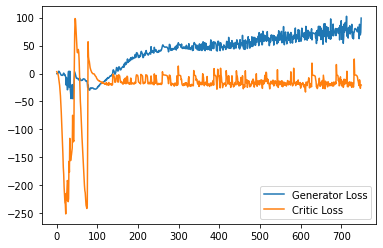

Step 15050: Generator loss: 77.09013816833496, critic loss: -22.7758404545784


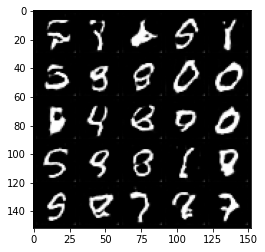

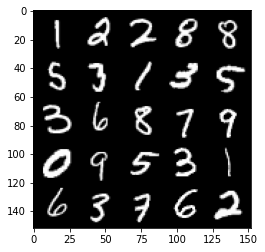

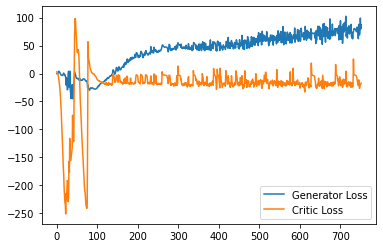

Step 15100: Generator loss: 76.65437271118164, critic loss: -18.059251820564267


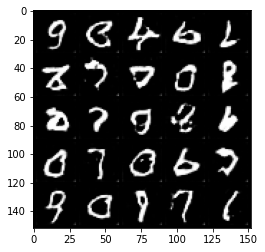

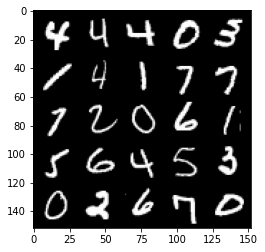

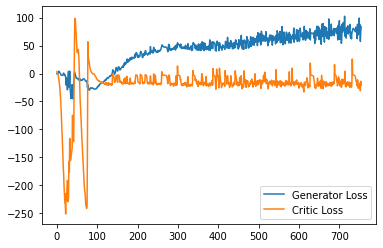

Step 15150: Generator loss: 70.71996055603027, critic loss: -10.719806449770928


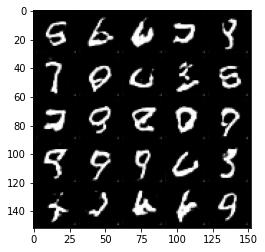

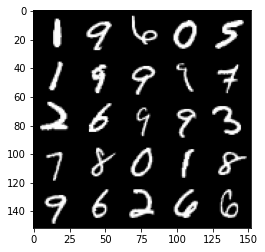

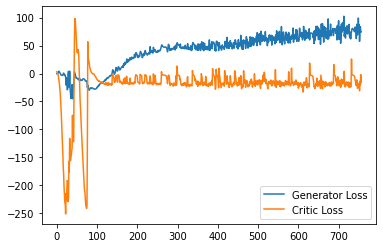

Step 15200: Generator loss: 79.40786270141602, critic loss: -18.33355102169514


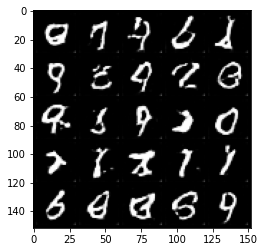

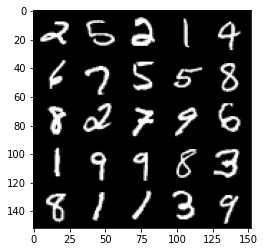

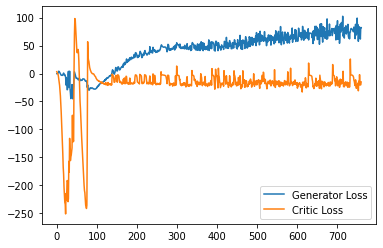

Step 15250: Generator loss: 83.62824493408203, critic loss: -7.474711717069148


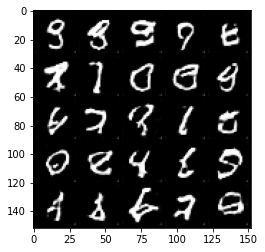

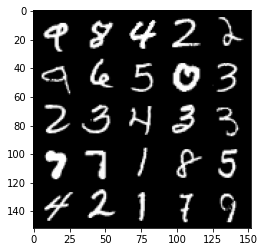

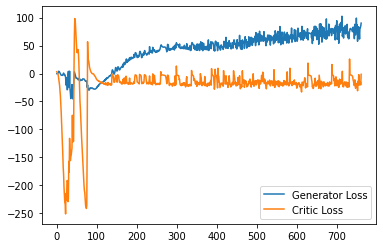

Step 15300: Generator loss: 77.46385269165039, critic loss: 3.4230637239813806


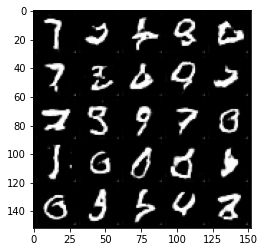

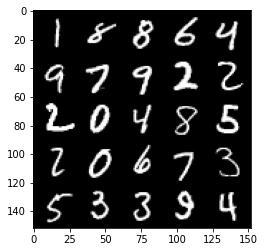

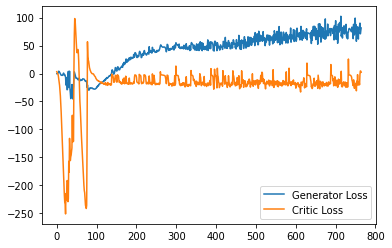

Step 15350: Generator loss: 82.77028594970703, critic loss: 0.18092977701127527


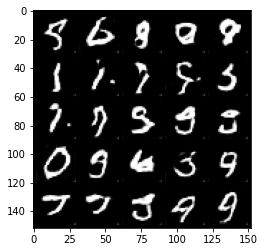

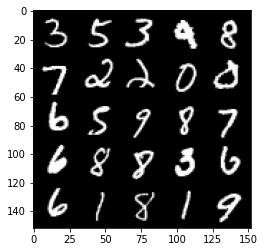

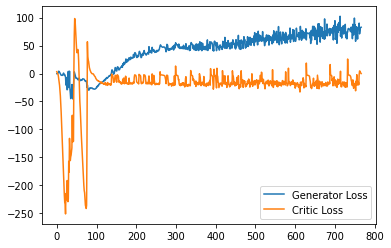

Step 15400: Generator loss: 83.29156448364257, critic loss: -0.9827122044116255


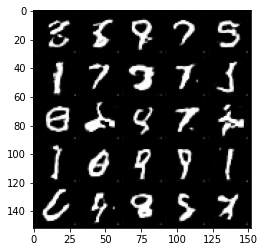

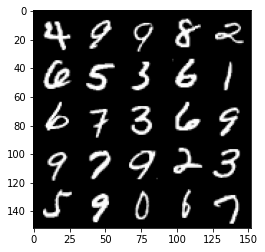

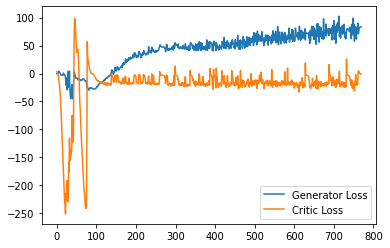

Step 15450: Generator loss: 83.83492706298829, critic loss: -1.341028790205717


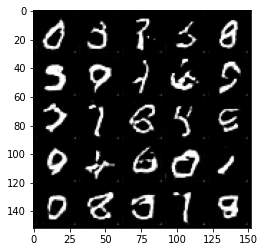

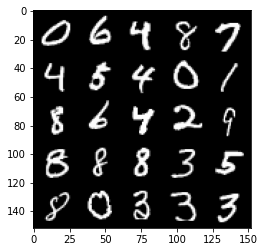

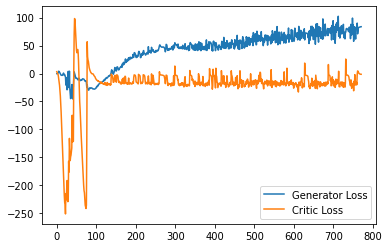

Step 15500: Generator loss: 84.21579910278321, critic loss: -1.6219795849323275


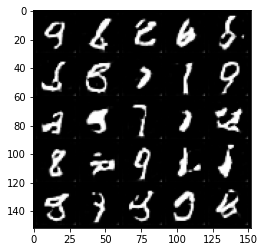

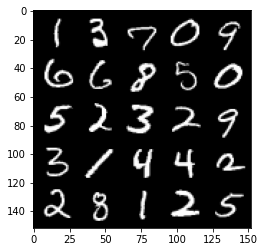

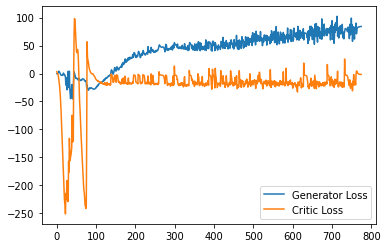

Step 15550: Generator loss: 84.28495834350586, critic loss: -1.703902324914932


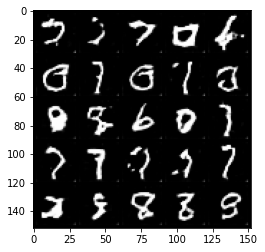

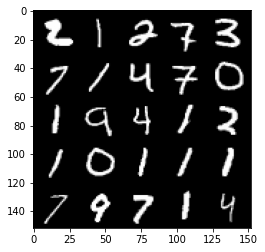

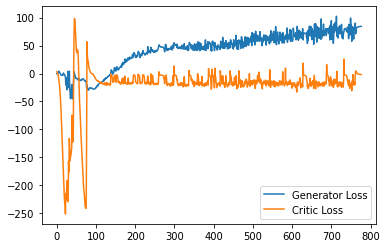

Step 15600: Generator loss: 83.94784637451171, critic loss: -1.8267094051837922


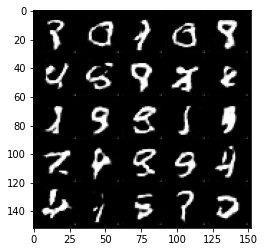

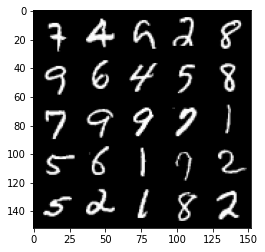

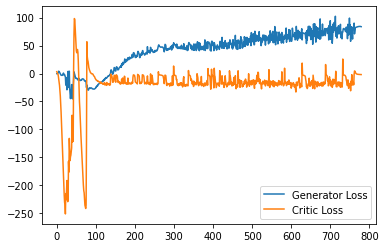

Step 15650: Generator loss: 83.69410766601563, critic loss: -1.8673669261932373


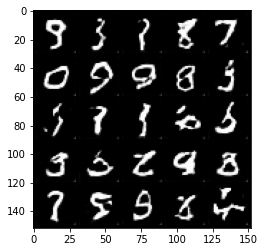

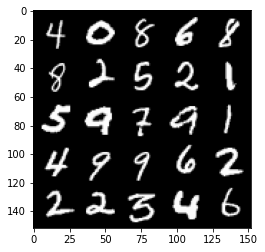

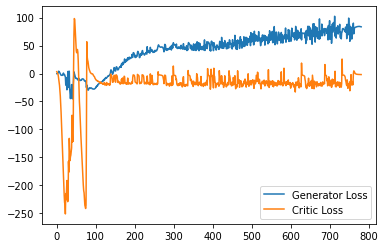

Step 15700: Generator loss: 83.64730255126953, critic loss: -1.959247523307801


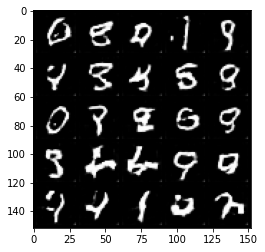

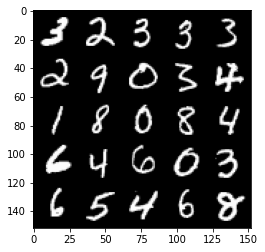

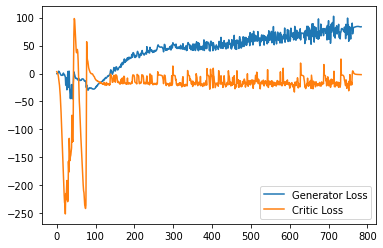

Step 15750: Generator loss: 83.0958560180664, critic loss: -1.998852870702743


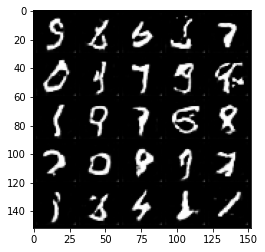

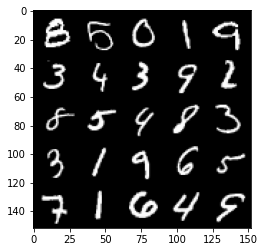

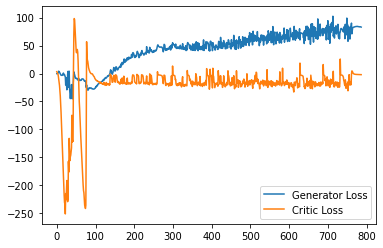

Step 15800: Generator loss: 82.61504257202148, critic loss: -2.013263443946838


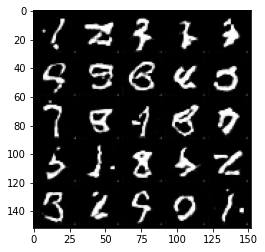

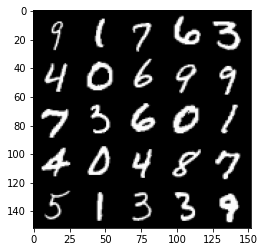

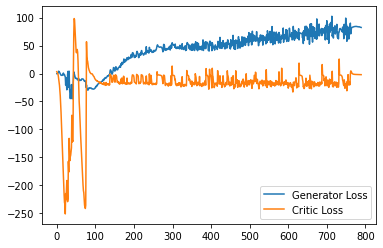

Step 15850: Generator loss: 82.36924713134766, critic loss: -2.084620540618897


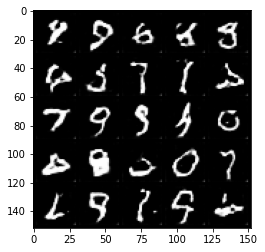

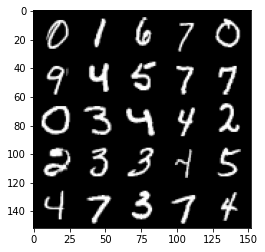

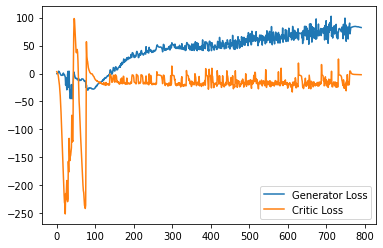

Step 15900: Generator loss: 81.82406036376953, critic loss: -2.098615631103516


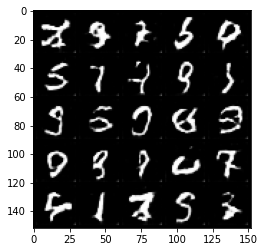

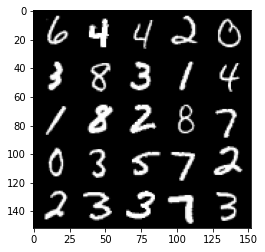

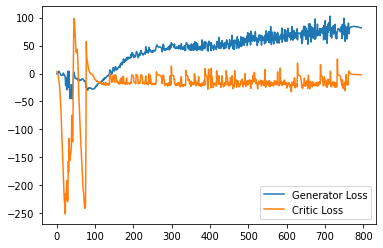

Step 15950: Generator loss: 81.42902465820312, critic loss: -2.168022253990173


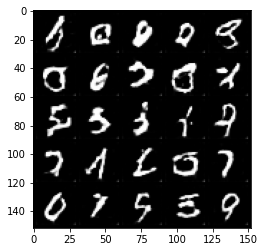

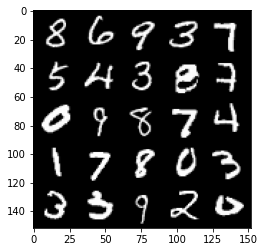

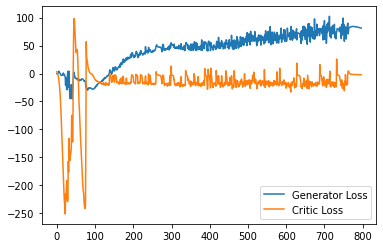

Step 16000: Generator loss: 81.13239547729492, critic loss: -2.190427264213562


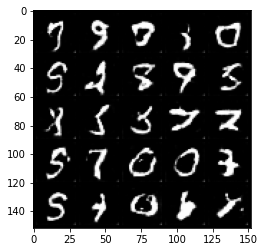

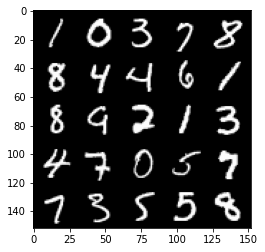

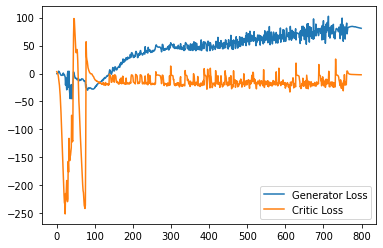

Step 16050: Generator loss: 80.64750747680664, critic loss: -2.220715312957763


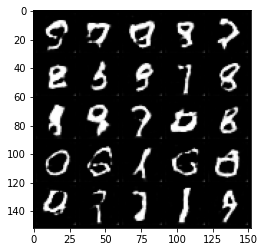

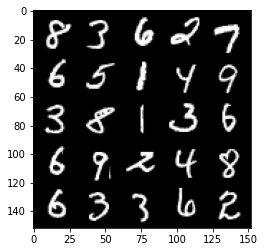

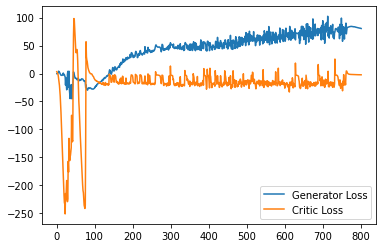

Step 16100: Generator loss: 80.17049362182617, critic loss: -2.2327367992401124


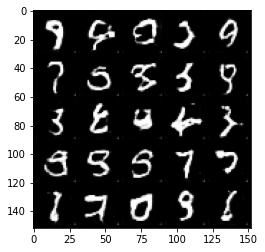

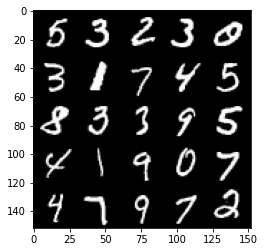

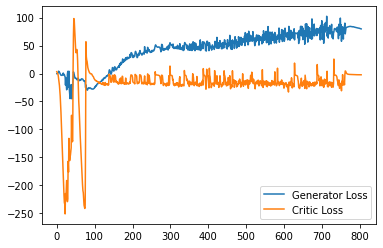

Step 16150: Generator loss: 79.8967610168457, critic loss: -2.2771121287345886


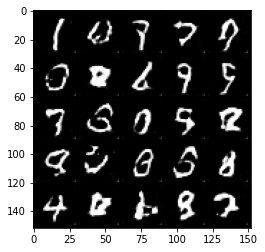

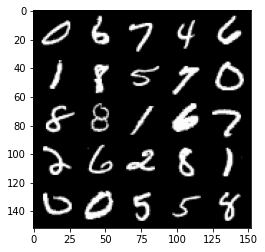

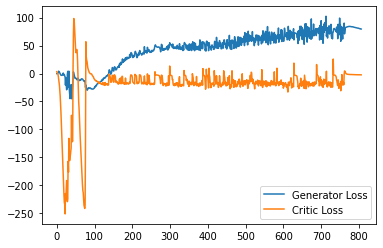

Step 16200: Generator loss: 79.48212783813477, critic loss: -2.2875893120765687


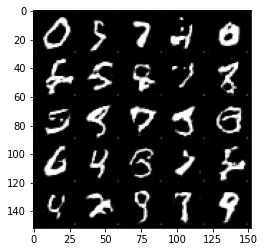

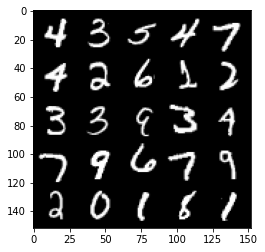

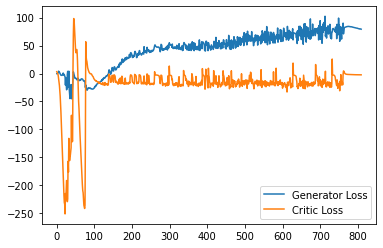

Step 16250: Generator loss: 79.31024475097657, critic loss: -2.3791704790592187


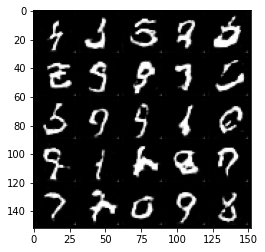

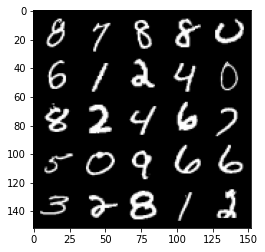

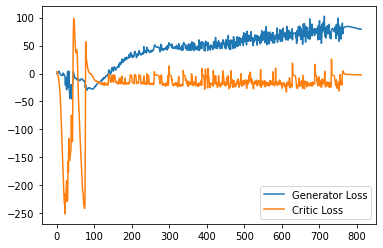

Step 16300: Generator loss: 79.0637777709961, critic loss: -2.380729006290436


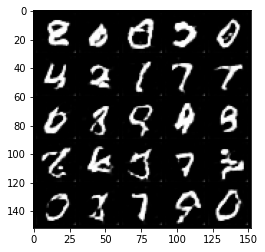

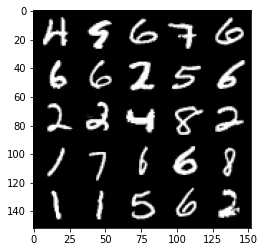

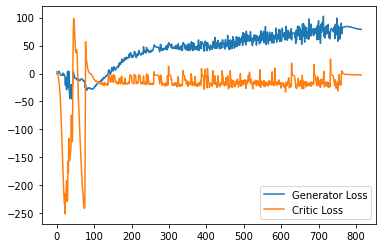

Step 16350: Generator loss: 78.81077713012695, critic loss: -2.472618417739868


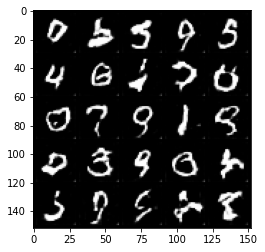

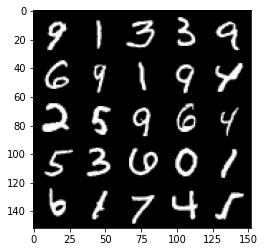

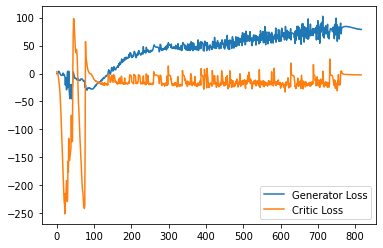

Step 16400: Generator loss: 78.41665161132812, critic loss: -2.4346795239448555


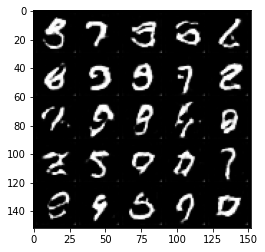

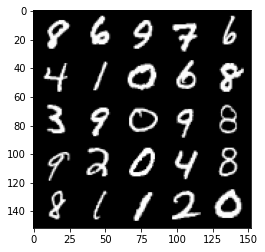

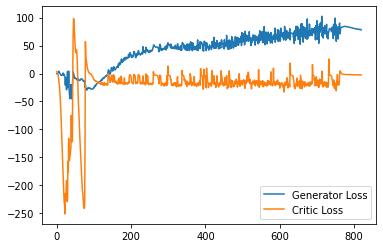

Step 16450: Generator loss: 77.7064256286621, critic loss: -2.488736807346344


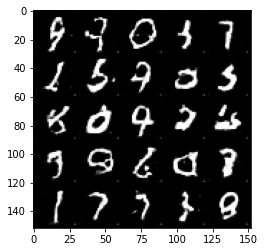

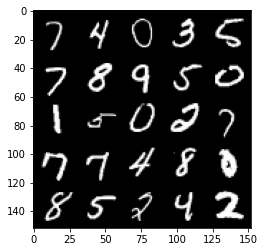

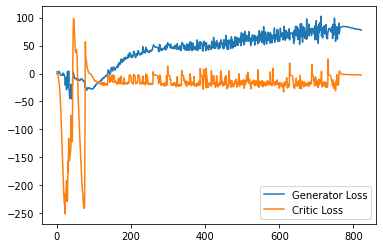

Step 16500: Generator loss: 77.55062622070312, critic loss: -2.607118518829347


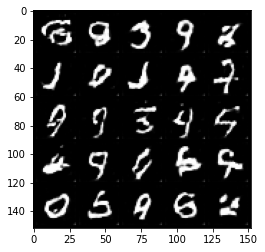

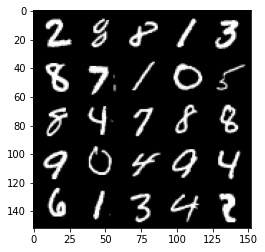

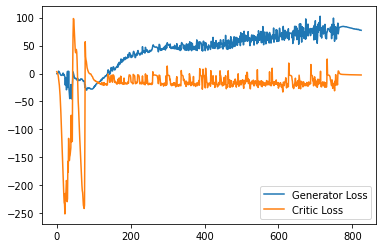

Step 16550: Generator loss: 77.64102600097657, critic loss: -2.640455486297607


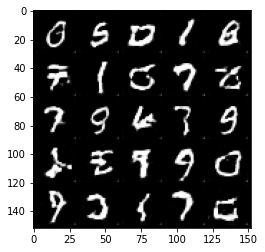

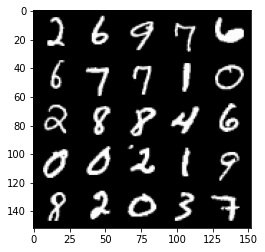

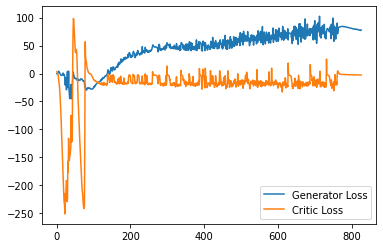

Step 16600: Generator loss: 78.45873657226562, critic loss: -2.7336246438026426


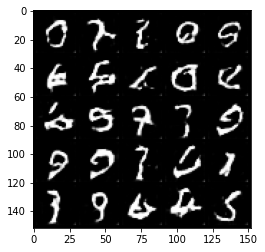

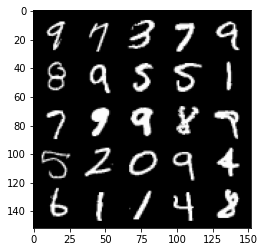

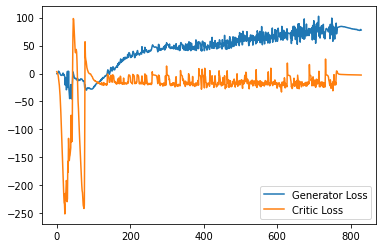

Step 16650: Generator loss: 78.59039077758788, critic loss: -2.703496089458466


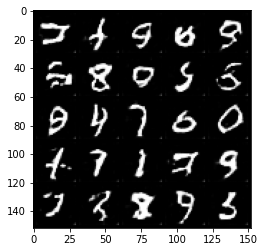

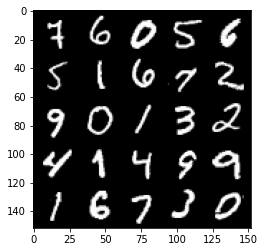

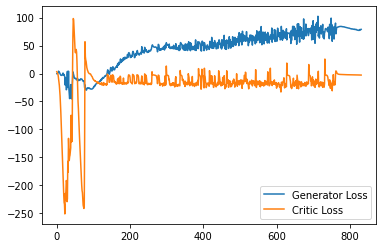

Step 16700: Generator loss: 77.80630630493164, critic loss: -2.818051671504975


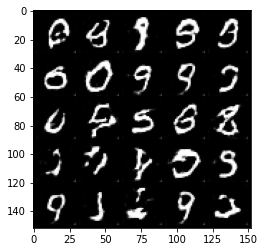

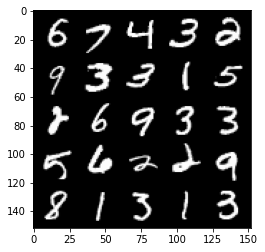

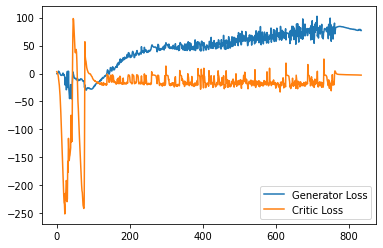

Step 16750: Generator loss: 77.52348861694335, critic loss: -2.821595949172974


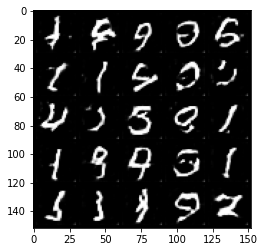

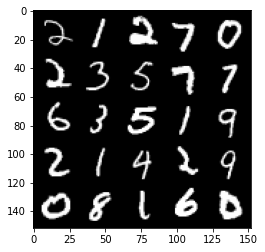

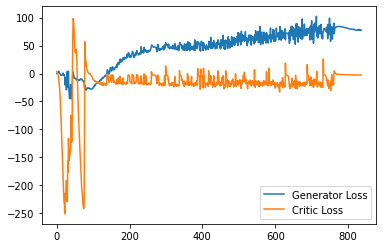

Step 16800: Generator loss: 77.2849771118164, critic loss: -3.028210402488709


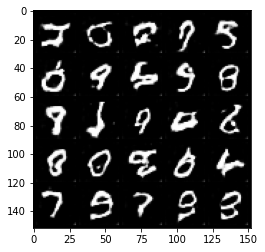

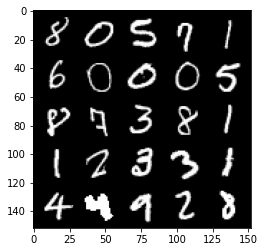

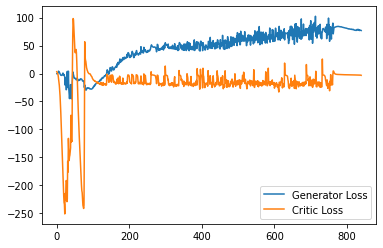

Step 16850: Generator loss: 77.62646408081055, critic loss: -3.140988265514374


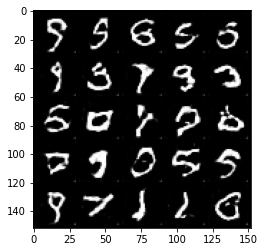

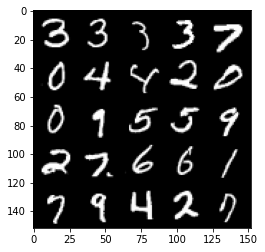

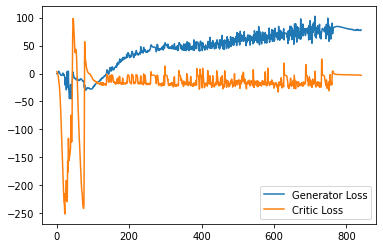

Step 16900: Generator loss: 77.77699035644531, critic loss: -3.11410113120079


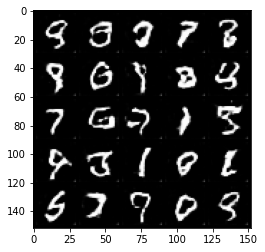

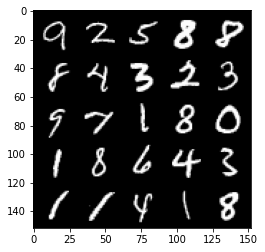

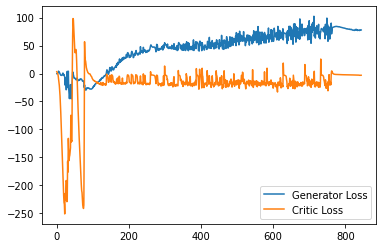

Step 16950: Generator loss: 78.01697891235352, critic loss: -2.4470939066410056


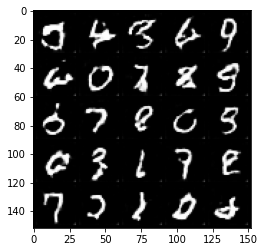

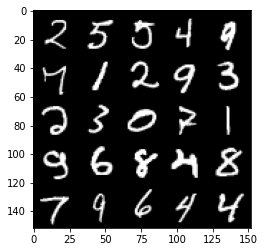

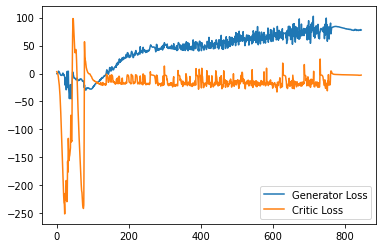

Step 17000: Generator loss: 77.39876419067383, critic loss: -2.330311390399932


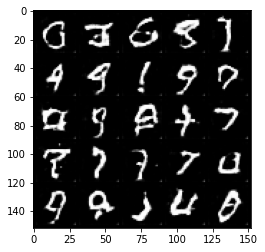

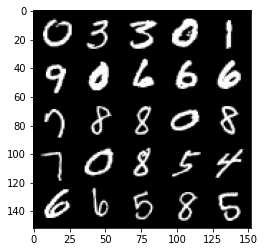

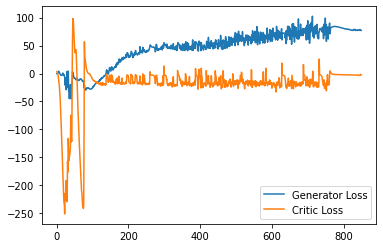

Step 17050: Generator loss: 76.6872622680664, critic loss: -2.8752160308361057


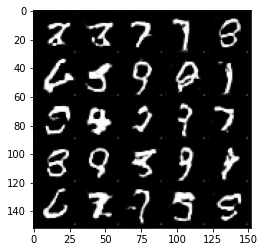

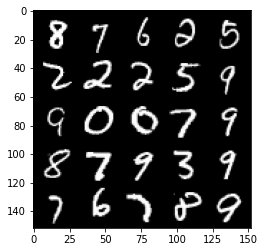

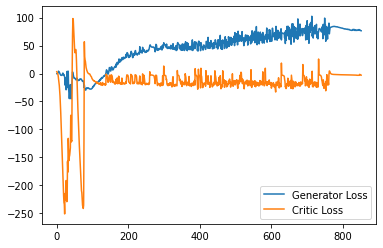

Step 17100: Generator loss: 77.2255062866211, critic loss: -3.0523650805950164


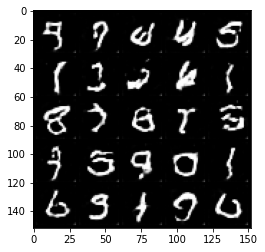

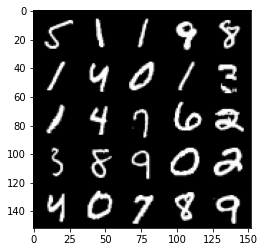

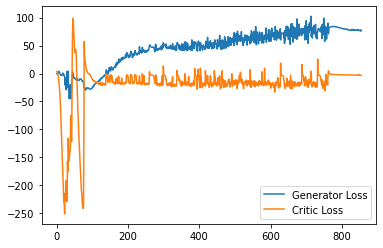

Step 17150: Generator loss: 77.13271438598633, critic loss: -3.032632599830627


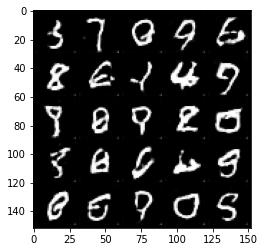

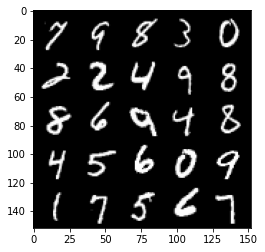

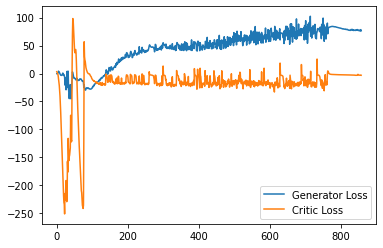

Step 17200: Generator loss: 77.3545864868164, critic loss: -3.4240329989790923


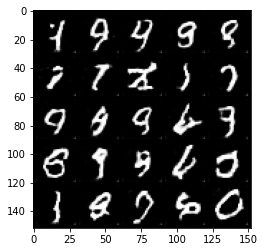

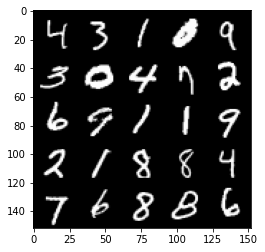

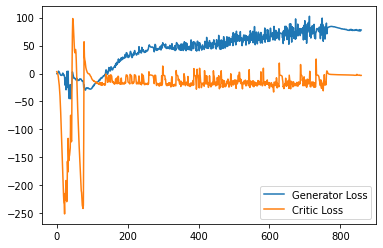

Step 17250: Generator loss: 78.70525985717774, critic loss: -3.3541428465843204


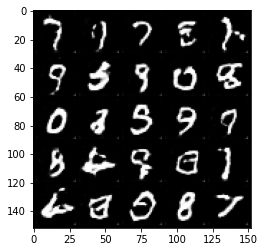

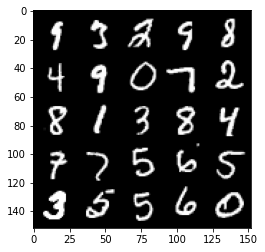

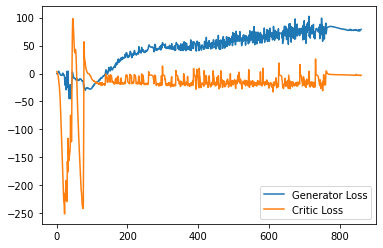

Step 17300: Generator loss: 78.76583999633789, critic loss: -3.5949589776992785


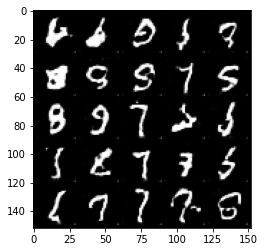

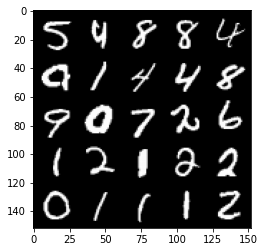

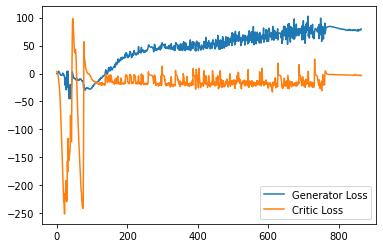

Step 17350: Generator loss: 78.59843521118164, critic loss: -3.307033895790576


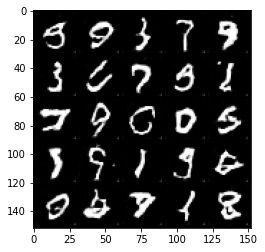

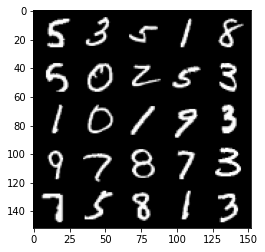

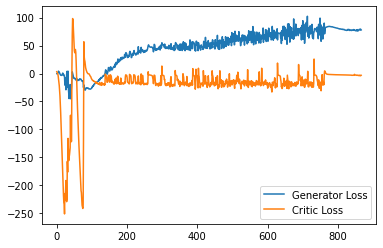

Step 17400: Generator loss: 78.95764938354492, critic loss: -3.2463743861317638


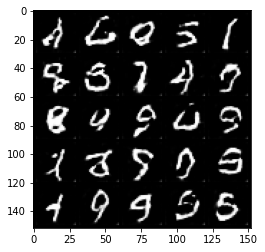

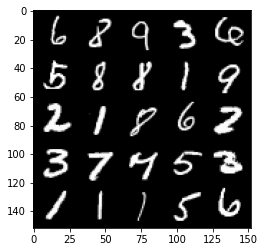

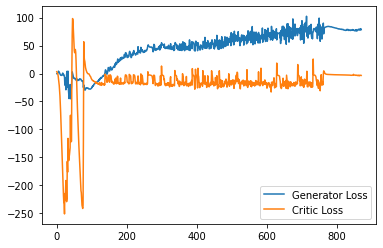

Step 17450: Generator loss: 76.29544189453125, critic loss: -3.6249629349708554


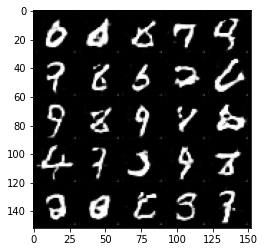

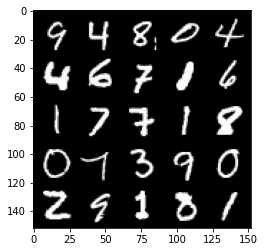

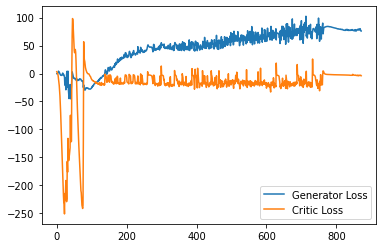

Step 17500: Generator loss: 77.43899887084962, critic loss: -3.5629120886325842


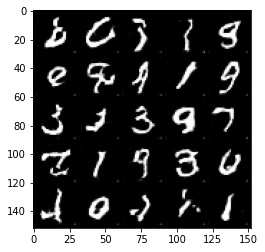

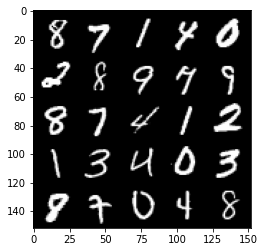

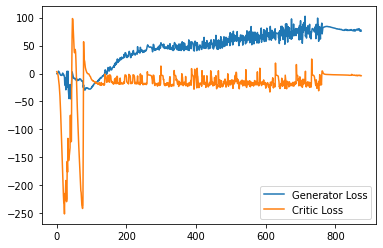

Step 17550: Generator loss: 80.40540786743163, critic loss: -3.6904805372953406


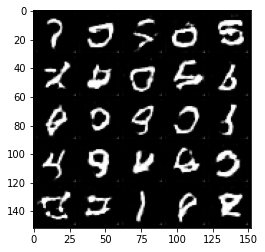

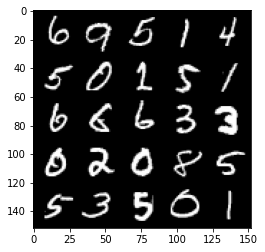

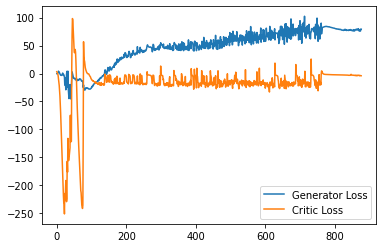

Step 17600: Generator loss: 78.07886474609376, critic loss: -3.5004017547369006


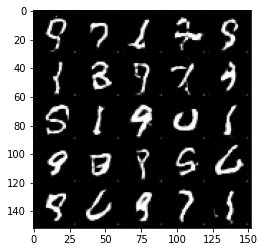

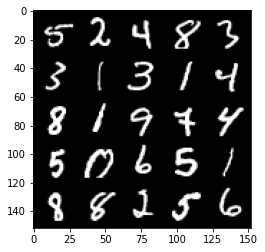

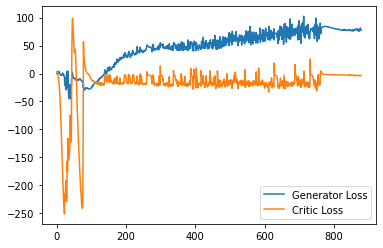

Step 17650: Generator loss: 78.09889617919922, critic loss: -3.7315489530563353


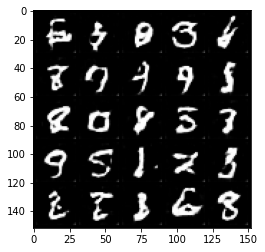

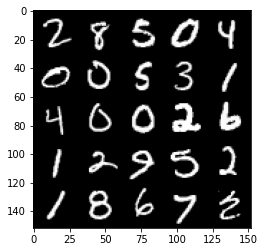

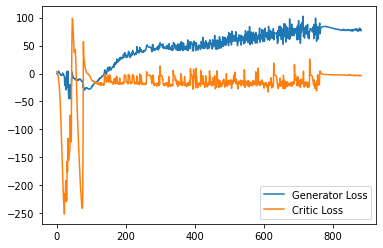

Step 17700: Generator loss: 79.6277961730957, critic loss: -3.5169704994559288


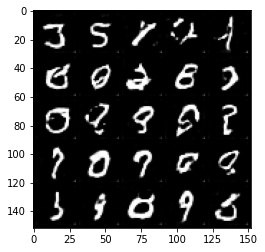

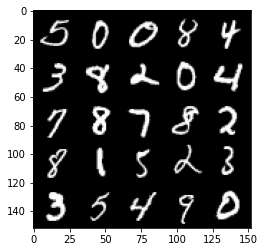

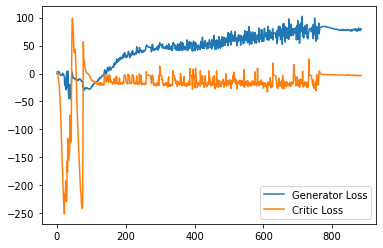

Step 17750: Generator loss: 79.6570851135254, critic loss: -3.6465937456190587


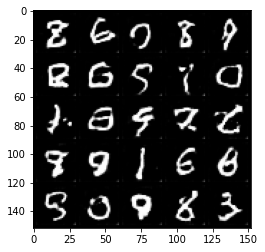

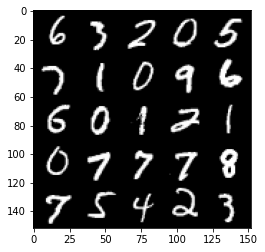

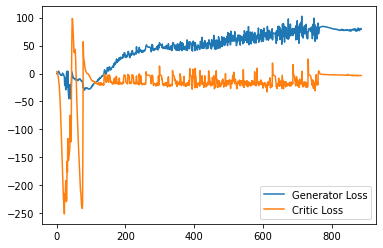

Step 17800: Generator loss: 77.81024276733399, critic loss: -4.020933529496194


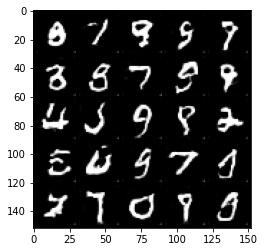

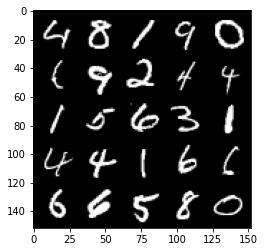

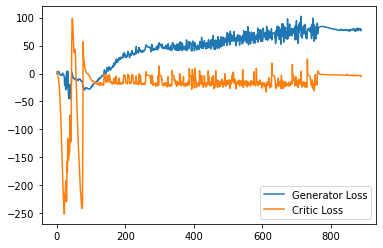

Step 17850: Generator loss: 80.75539581298828, critic loss: -3.2747614187598226


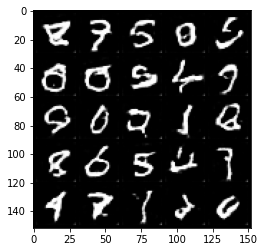

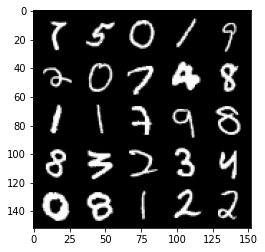

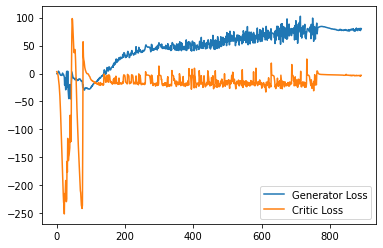

Step 17900: Generator loss: 79.55399673461915, critic loss: -3.2435908383131022


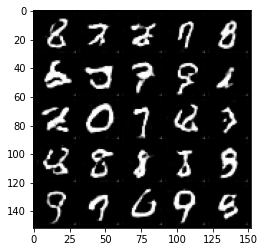

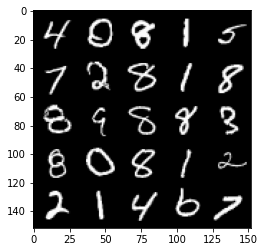

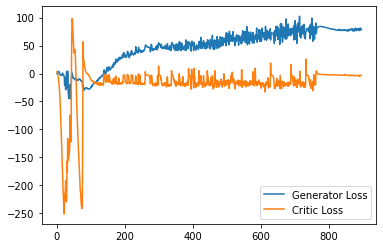

Step 17950: Generator loss: 79.0984861755371, critic loss: -3.554611376374959


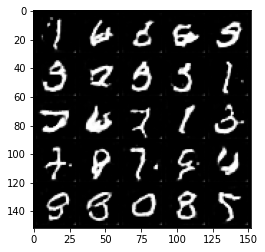

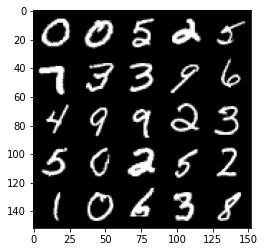

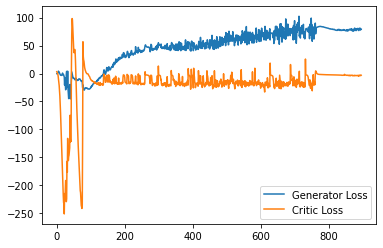

In [ ]:
import matplotlib.pyplot as plt

cur_step = 0
generator_losses = []
critic_losses = []
for epoch in range(n_epochs):
    # Dataloader returns the batches
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)
        real = real.to(device)

        mean_iteration_critic_loss = 0
        for _ in range(crit_repeats):
            ### Update critic ###
            crit_opt.zero_grad()
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)
            crit_fake_pred = crit(fake.detach())
            crit_real_pred = crit(real)

            epsilon = torch.rand(len(real), 1, 1, 1, device=device, requires_grad=True)
            gradient = get_gradient(crit, real, fake.detach(), epsilon)
            gp = gradient_penalty(gradient)
            crit_loss = get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda)

            # Keep track of the average critic loss in this batch
            mean_iteration_critic_loss += crit_loss.item() / crit_repeats
            # Update gradients
            crit_loss.backward(retain_graph=True)
            # Update optimizer
            crit_opt.step()
        critic_losses += [mean_iteration_critic_loss]

        ### Update generator ###
        gen_opt.zero_grad()
        fake_noise_2 = get_noise(cur_batch_size, z_dim, device=device)
        fake_2 = gen(fake_noise_2)
        crit_fake_pred = crit(fake_2)
        
        gen_loss = get_gen_loss(crit_fake_pred)
        gen_loss.backward()

        # Update the weights
        gen_opt.step()

        # Keep track of the average generator loss
        generator_losses += [gen_loss.item()]

        ### Visualization code ###
        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            crit_mean = sum(critic_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, critic loss: {crit_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(critic_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Critic Loss"
            )
            plt.legend()
            plt.show()

        cur_step += 1
